### Informacje o projekcie

Celem projektu jest odszumienie sygnału elektroencefalograficznego.

Zastosowana metoda odszumiania:
* ICA - Independent Component Analysis


W ramach projektu uwzględniono m.in.: generowanie syntetycznego sygnału EEG, wczytywanie sygnału z bazy danych, sztuczne zaszumianie rzeczywistych sygnałów EEG, wizualizacja sygnałów z poszczególnych kanałów, obliczanie i zestawianie metryk jakości.


*Agata Polejowska*

### Instalacja bibliotek (dla środowiska Google Colab)

In [ ]:
pip install mne

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 7.5 MB 12.5 MB/s 


In [ ]:
pip install python-picard

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Zaimportowanie bibliotek

In [ ]:
import mne
from mne.preprocessing import ICA
from mne.datasets import sample, eegbci
from mne.io import concatenate_raws, read_raw_edf

import picard

import statsmodels.api as sm

from sklearn.decomposition import FastICA
from sklearn.metrics import mean_squared_error

from statistics import mean

import numpy as np
import pandas as pd

import math
import random
import os

from time import time

import scipy
import scipy.signal

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns

import pywt

In [ ]:
sns.set_theme()
sns.set_context("paper")

### Generator syntetycznych, trzykanałowych sygnałów EEG (Pz, Cz, Fz)

In [ ]:
EEG_BANDS = {'Delta': (0, 4),
            'Theta': (4, 8),
            'Alpha': (8, 12),
            'Beta': (12, 30),
            'Gamma': (30, 45)}

In [ ]:
class EEGGenerator(object):
    """EEG Generator - generating the EEG signal"""

    def __init__(self, fs, start_time, end_time):
        """Initializes EEG signal generator.

        Args:
            fs (int): The number of samples per seconds.
            start_time (int): The starting point time of signal in the time domain.
            end_time (int): The ending point time of signal in the time domain.
        """
        self.fs = fs
        self.start_time = start_time
        self.end_time = end_time
        self.n_samples = fs * end_time
        self.eeg_signal = np.linspace(self.start_time, self.end_time, self.n_samples)

    def create_signal(self, start_time, end_time, fs, 
                    low_peak_amplitude_value, high_peak_amplitude_value,
                    low_frequency, high_frequency):
        """Creates signal that can be included in the entire EEG signal.

        Args:
            start_time (int): The starting point time of signal in the time domain.
            end_time (int): The ending point time of signal in the time domain.
            fs (int): The number of samples per seconds.
            low_peak_amplitude_value (int): The lowest amplitude point of the signal.
            high_peak_amplitude_value (int): The highest amplitude point of the signal.
            low_frequency (float): The lowest rate of freqency.
            high_frequency (float): The highest rate of frequency.

        Returns:
            np.array: The generated signal.
        """
        n_samples = end_time * fs
        t = np.linspace(start_time, end_time, n_samples)
        signal_amplitude = [round(random.uniform(low_peak_amplitude_value, high_peak_amplitude_value), 2) for i in range(len(t))]
        signal_frequency = [random.uniform(low_frequency, high_frequency) for i in range(len(t))]
        signal = signal_amplitude * np.sin(2*np.pi*np.asarray(signal_frequency)*t)
        return signal

    def simulate_eeg(self):
        """Simulate eeg signal.

        Returns:
           np.array: The syntethic EEG signal.
        """
        fs = self.fs
        start_time = self.start_time
        end_time = self.end_time

        low_peak_amplitude_value = -10
        high_peak_amplitude_value = 10

        gamma_waves = self.create_signal(
            start_time=self.start_time, end_time=self.end_time, fs=self.fs, 
            low_peak_amplitude_value=low_peak_amplitude_value,
            high_peak_amplitude_value=high_peak_amplitude_value,
            low_frequency=EEG_BANDS['Gamma'][0], high_frequency=EEG_BANDS['Gamma'][1])
        beta_waves = self.create_signal(
            start_time=self.start_time, end_time=self.end_time, fs=self.fs, 
            low_peak_amplitude_value=low_peak_amplitude_value,
            high_peak_amplitude_value=high_peak_amplitude_value,
            low_frequency=EEG_BANDS['Beta'][0], high_frequency=EEG_BANDS['Beta'][1])
        alpha_waves = self.create_signal(
            start_time=self.start_time, end_time=self.end_time, fs=self.fs,
            low_peak_amplitude_value=low_peak_amplitude_value,
            high_peak_amplitude_value=high_peak_amplitude_value,
            low_frequency=EEG_BANDS['Alpha'][0], high_frequency=EEG_BANDS['Alpha'][1])
        theta_waves = self.create_signal(
            start_time=self.start_time, end_time=self.end_time, fs=self.fs, 
            low_peak_amplitude_value=low_peak_amplitude_value,
            high_peak_amplitude_value=high_peak_amplitude_value,
            low_frequency=EEG_BANDS['Theta'][0], high_frequency=EEG_BANDS['Theta'][1])
        delta_waves = self.create_signal(
            start_time=self.start_time, end_time=self.end_time, fs=self.fs, 
            low_peak_amplitude_value=low_peak_amplitude_value,
            high_peak_amplitude_value=high_peak_amplitude_value,
            low_frequency=EEG_BANDS['Delta'][0], high_frequency=EEG_BANDS['Delta'][1])
        
        # combine all waves into one eeg signal
        eeg_signal = alpha_waves + beta_waves + theta_waves + delta_waves + gamma_waves

        return eeg_signal

    def simulate_multichannel_eeg(self, noise_type=None):
        """Simulate multichannel eeg.

        Returns:
            np.array: The multi-channel synthetic EEG signal.
        """
        
        low_peak_amplitude_value = -10
        high_peak_amplitude_value = 10

        frontal = self.simulate_eeg()
        parietal = self.simulate_eeg()
        central = self.simulate_eeg()

        multichannel_eeg_signal_clean = np.c_[frontal, central, parietal]

        blink = self.create_blink_artifact()

        # without noise added
        multichannel_eeg_signal_with_noise = np.c_[frontal + blink * 550, central + blink * 200,  parietal + blink * 80]
        #multichannel_eeg_signal_with_noise = np.c_[add_noise_type(frontal + blink * 550, noise_type), add_noise_type(central + blink * 200, noise_type), add_noise_type(parietal + blink * 80, noise_type)]

        return (multichannel_eeg_signal_clean, multichannel_eeg_signal_with_noise)

    def create_blink_artifact(self):
        blink = np.zeros(self.n_samples)
        blink[self.n_samples//2::200] += -1
        blink = scipy.signal.lfilter(*scipy.signal.butter(2, [1*2/self.fs, 10*2/self.fs], 'bandpass'), blink)
        return blink

    def visualize(self, signal, title):
        """Plot the signal.
        """
        plt.figure(figsize=(12, 8), dpi=120)
        plt.title(title) 
        plt.xlabel("Time [samples]") 
        plt.ylabel("Amplitude [µV]") 
        plt.plot(signal)

    def visualize_multichannel(self, signal):
        plt.figure(figsize=(10, 6), dpi=80)
        plt.title("Generated EEG signal")
        for ch in range(signal.shape[1]):
          plt.plot(signal[:,0] + 50)
          plt.plot(signal[:,1]+ 100)
          plt.plot(signal[:,2] + 150)
          plt.yticks([50, 100, 150], ['Fz', 'Cz', 'Pz'])
          plt.ylabel('Channels')

### Funkcje modelujące szum i artefakty

#### Artefakty

In [ ]:
def create_blink_artifact(n_samples, fs):
  """Creates a blink artifact.

  Args:
    fs (int): The number of samples per seconds.
    n_samples (int): The number of samples for the signal

  Returns:
    blink: The blink artifact pattern.
  """

  blink = np.zeros(n_samples)
  blink[n_samples//2::200] += -1
  blink = scipy.signal.lfilter(*scipy.signal.butter(2, [1*2/fs, 10*2/fs], 'bandpass'), blink)
  return blink

#### Szum

In [ ]:
def add_white_noise(signal, sigma=1):
  mu, sigma = 0, sigma
  noise = np.random.normal(mu, sigma, len(signal))
  signal_with_noise = signal + noise
  return signal_with_noise

In [ ]:
NOISE_TYPES = ['WHITE', 'BLUE', 'VIOLET', 'BROWNIAN', 'PINK']

In [ ]:
# https://stackoverflow.com/questions/67085963/generate-colors-of-noise-in-python

def noise_psd(N, psd = lambda f: 1):
        X_white = np.fft.rfft(np.random.randn(N));
        S = psd(np.fft.rfftfreq(N))
        # Normalize S
        S = S / np.sqrt(np.mean(S**2))
        X_shaped = X_white * S;
        return np.fft.irfft(X_shaped);

def PSDGenerator(f):
    return lambda N: noise_psd(N, f)

@PSDGenerator
def white_noise(f):
    return 1;

@PSDGenerator
def blue_noise(f):
    return np.sqrt(f);

@PSDGenerator
def violet_noise(f):
    return f;

@PSDGenerator
def brownian_noise(f):
    return 1/np.where(f == 0, float('inf'), f)

@PSDGenerator
def pink_noise(f):
    return 1/np.where(f == 0, float('inf'), np.sqrt(f))

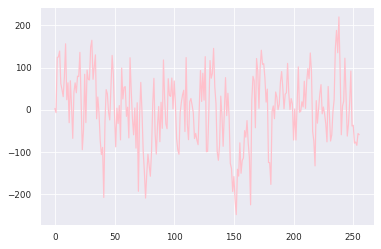

In [ ]:
# examples of noise
SCALE_COEF = 100

plt.plot(SCALE_COEF * pink_noise(256), c='pink')

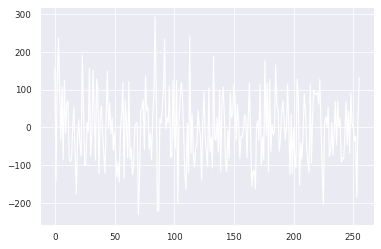

In [ ]:
plt.plot(SCALE_COEF * white_noise(256), c='white')

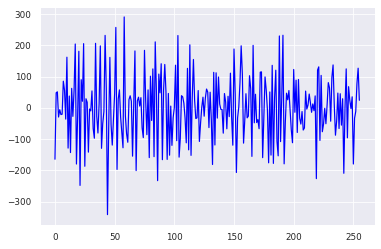

In [ ]:
plt.plot(SCALE_COEF * blue_noise(256), c='blue')

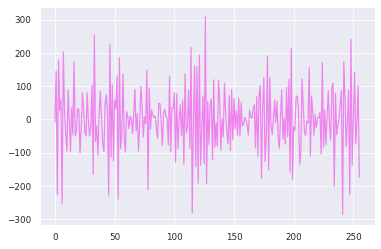

In [ ]:
plt.plot(SCALE_COEF * violet_noise(256), c='violet')

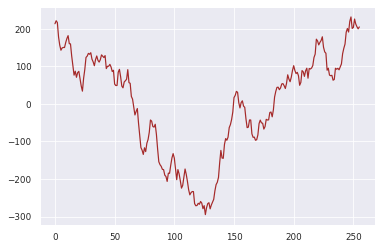

In [ ]:
plt.plot(SCALE_COEF * brownian_noise(256), c='brown')

In [ ]:
def add_noise_type(signal, noise_type, SCALE_COEF=10):
  if noise_type == 'white':
    return signal + SCALE_COEF*white_noise(len(signal))

  if noise_type == 'blue':
    return signal + SCALE_COEF*blue_noise(len(signal))

  if noise_type == 'pink':
    return signal + SCALE_COEF*pink_noise(len(signal))

  if noise_type == 'brownian':
    return signal + SCALE_COEF*brownian_noise(len(signal))

  if noise_type == 'violet':
    return signal + SCALE_COEF*violet_noise(len(signal))

### Funkcja normalizująca sygnał

In [ ]:
def normalize_0_to_1(signal):
  return (signal - np.min(signal))/np.ptp(signal)

### Funkcje dla rzeczywistych sygnałów EEG z wybranej bazy

In [ ]:
def get_sample_raw_EEG(channels=None):
  sample_data_folder = mne.datasets.sample.data_path()
  sample_data_raw_file = os.path.join(sample_data_folder, 'MEG', 'sample', 'sample_audvis_raw.fif')
  raw = mne.io.read_raw_fif(sample_data_raw_file, preload=True)
  if channels is not None:
    eeg_only = raw.copy().pick_types(meg=False, eeg=True).pick_channels(channels)
  else:
    eeg_only = raw.copy().pick_types(meg=False, eeg=True)
  # crop raw signal
  eeg_only.crop(tmax=60)
  return eeg_only

def get_samplpe_raw_EEG_BCI():
  subject = 1
  runs = [5]

  raw_fnames = eegbci.load_data(subject, runs)
  raw = concatenate_raws([read_raw_edf(f, preload=True) for f in raw_fnames][:2])

  eegbci.standardize(raw)  # set channel names
  raw.rename_channels(lambda x: x.strip('.'))

  montage = mne.channels.make_standard_montage('standard_1005')
  raw.set_montage(montage)

  events, _ = mne.events_from_annotations(raw, event_id=dict(T1=2, T2=3))
  event_id = {'Hand': 2, 'Feet': 3}

  raw = raw.crop(tmax=60.)
  return raw

def convert_raw_to_df(raw):
  fs = raw.info['sfreq']
  print("Sampling frequency of raw signal:", fs)
  start_end_secs = np.array([0, 10])
  start_sample, stop_sample = (start_end_secs * fs).astype(int)
  df = raw.to_data_frame(picks=['eeg'], start=start_sample, stop=stop_sample)
  print(df.head())
  return df

def save_df_to_csv(df, filename):
  df.to_csv(filename)

### Funkcje do obliczania metryk jakości metod

#### SNR - Signal to noise ratio

In [ ]:
def SNR(x, y=None, axis=0):
    """Signal to Noise Ratio, as defined here:
    www.scholarpedia.org/article/Signal-to-noise_ratio_in_neuroscience

    This is equivalent to the variance of the average signal in relation to the 
    total variance.

    Args:
        x (array): An array representing a set of signals. 
        The last dimension in the array must correspond to the time course
        of the signal (over which the common underlying signal is expected)
        y (None, array of shape = x.shape, optional): 
        Reference array that will be used for computation of the underlying
        signal. If y = None, x is used as reference array. Defaults to None.
        axis (int, tuple of ints, optional): 
        The axes over which the signals should be averaged to get the common
        underlying signal. Can include every axis of the array except for the 
        last one, which is assumed to be the time axis of the signal.
        Defaults to 0. 

    Returns:
        float or array of floats: SNR. 
        The signal-to-noise ration over the remaining axes. Is equivalent to 
        the fraction of how much of the total variance in the signal set is
        explained through the common underlying signal.
    """
    y = x if y is None else y
    axis = tuple([axis]) if isinstance(axis, int) else axis
    if np.any([ax in axis for ax in [-1, x.ndim - 1]]):
        raise ValueError("Last array axis can't be passed as axis argument.")
    return np.mean(np.mean(y, axis)**2, axis=-1) / np.var(x, axis=(-1,) + axis)

In [ ]:
def calculate_snr(signal_original, signal_denoised):
  x = sum([original_value**2 for original_value in signal_original])/len(signal_original)
  y = sum([(original_value-noise_value)**2 for original_value, noise_value in zip(signal_original, signal_denoised)])/len(signal_original)
  snr = 10*np.log10(x/y)
  return snr

#### PSNR - Peak signal-to-noise ratio

In [ ]:
def calculate_psnr(signal_original, signal_denoised):
    mse = np.mean((signal_original - signal_denoised) ** 2)

    if signal_original.max() > signal_denoised.max():
      max_value = signal_original.max()
    else:
      max_value = signal_denoised.max()

    psnr = 20 * np.log10(max_value / np.sqrt(mse))
    return psnr

#### RMSE - Root mean squared error

In [ ]:
def calculate_rmse(signal_orginal, signal_reconstructed):
  # squared=False -> RMSE value
  return mean_squared_error(signal_orginal, signal_reconstructed, squared=False)

#### Correlation coefficient


In [ ]:
def correlation_coefficient(signal1, signal2):
  sum1, sum2, sum12, square_sum1, square_sum2, i = 0, 0, 0, 0, 0, 0
  n = len(signal1)
  while i < n:
    sum1 = sum1 + signal1[i]
    sum2 = sum2 + signal2[i]
    sum12 = sum12 + signal1[i] * signal2[i]     
    square_sum1 = square_sum1 + signal1[i] * signal1[i]
    square_sum2 = square_sum2 + signal2[i] * signal2[i]       
    i += 1
  numerator = (float)(n *sum12 - sum1 * sum2)
  denominator = (float)(math.sqrt((n * square_sum1 - sum1 * sum1)* (n * square_sum2 - sum2 * sum2)))
  corr = numerator/denominator
  return corr

In [ ]:
def get_correlations_channels(signal_original, signal_denoised):
  corr_list = []

  for i in range(59):
    corr = correlation_coefficient(signal_original[:, i], signal_denoised[:, i])
    corr_list.append(corr)
    print(f"CORRELATION EEG 0{i+1}", corr)

  return corr_list

### Funkcje zestawiające rezultaty metryk

In [ ]:
def metrics_summary(method, signal_type, artifact, noise, signal_original, signal_denoised, with_noise=False):

  snr_original_value_nb = SNR(signal_original)
  snr_denoised_value_nb = SNR(signal_denoised)

  snr_db = calculate_snr(signal_original, signal_denoised)

  rmse = calculate_rmse(signal_original, signal_denoised)
  psnr = calculate_psnr(signal_original, signal_denoised)

  corr1 = correlation_coefficient(signal_original[:, 0], signal_denoised[:, 0])
  corr2 = correlation_coefficient(signal_original[:, 1], signal_denoised[:, 1])
  corr3 = correlation_coefficient(signal_original[:, 2], signal_denoised[:, 2])

  # initialize 
  data = [[method, signal_type, artifact, noise,
           snr_original_value_nb, snr_denoised_value_nb,
           snr_db[0], snr_db[1], snr_db[2],
           rmse, psnr,
           corr1, corr2, corr3]]


  SNR_column_name = 'SNR - signal modified (with added noise or reconstructed)'

    
  # create the pandas DataFrame
  df = pd.DataFrame(data, columns=['method',
                                   'signal type',
                                   'artifacts',
                                   'noise',
                                   'SNR - original signal',
                                   SNR_column_name,
                                   'SNR - first channel[dB]',
                                   'SNR - second channel[dB]',
                                   'SNR - third channel[dB]',        
                                   'RMSE',
                                   'PSNR',
                                   'correlation - first channel',
                                   'correlation - second channel',
                                   'correlation - third channel'
                                   ])

  df.style.hide_index()

  return df

### Wizualizacja sygnału i widma sygnału

In [ ]:
def visualize_signal(signal, sf, title):
  time = np.arange(signal.size) / sf
  sns.set(font_scale=1.2)
  fig, ax = plt.subplots(1, 1, figsize=(16, 8))
  plt.plot(time, signal, lw=1.5, color='k')
  plt.xlabel('Time')
  # plt.ylabel('Voltage')
  plt.xlim([time.min(), time.max()])
  plt.title(title)
  sns.despine()

In [ ]:
def visualize_multichannel(signal, title):
    plt.figure(figsize=(12, 8), dpi=120)
    plt.title("Generated EEG signal")
    y_space = 0
    for ch in range(signal.shape[1]):
      plt.plot(signal[:, ch] + y_space + 50)

    plt.yticks([y_s + 50 for y_s in range(signal.shape[1])], [str(x) for x in range(signal.shape[1])])
    
    plt.ylabel('Channels')

In [ ]:
def visualize_psd(data, sf, title, window_length_sec=4):
  win = window_length_sec * sf
  freqs, psd = scipy.signal.welch(data, sf, nperseg=win)
  plt.figure(figsize=(12, 8))
  plt.plot(freqs, psd, color='k', lw=2)
  plt.xlabel('Frequency (Hz)')
  plt.ylabel('Power spectral density (V^2 / Hz)')
  plt.ylim([0, psd.max()])
  plt.title("Welch's periodogram " + title)
  plt.xlim([0, 60])
  sns.despine()

### Podział sygnału EEG na określone pasma częstotliwościowe

In [ ]:
def get_freq_bands(fs, data):

  # get real amplitudes of FFT (only in postive frequencies)
  fft_vals = np.absolute(np.fft.rfft(data))

  # get frequencies for amplitudes in Hz
  fft_freq = np.fft.rfftfreq(len(data), 1.0/fs)

  # define EEG bands
  eeg_bands = {'Delta': (0, 4),
              'Theta': (4, 8),
              'Alpha': (8, 12),
              'Beta': (12, 30),
              'Gamma': (30, 45)}

  # take the mean of the fft amplitude for each EEG band
  eeg_band_fft = dict()
  for band in eeg_bands:  
      freq_ix = np.where((fft_freq >= eeg_bands[band][0]) & 
                        (fft_freq <= eeg_bands[band][1]))[0]
      eeg_band_fft[band] = np.mean(fft_vals[freq_ix])

  df = pd.DataFrame(columns=['band', 'val'])
  df['band'] = eeg_bands.keys()
  df['val'] = [eeg_band_fft[band] for band in eeg_bands]

  sns.set_theme()
  sns.set_context("paper")

  ax = df.plot.bar(x='band', y='val', legend=False, figsize=(16, 8), color='k')
  ax.grid(color='white', linestyle='-', linewidth=1)
  ax.set_xlabel("EEG band")
  ax.set_ylabel("Mean band Amplitude")

  print("Band values \n", df)

## Wygenerowanie syntetycznego sygnału EEG

In [ ]:
# nastawy sygnału
FS = 256
START_TIME = 0
END_TIME = 1

In [ ]:
# inicjalizacja generatora sygnału EEG
eeg_generator = EEGGenerator(fs=FS, start_time=START_TIME, end_time=END_TIME)

# symulacja wielokanałowego sygnału EEG
signal_multichannel = eeg_generator.simulate_multichannel_eeg()

# wybranie sygnału czystego i zakłóconego
signal_multichannel_with_noise = signal_multichannel[1]
signal_multichannel_clean = signal_multichannel[0]

### Wizualizacja wygenerowanego sygnału bez wprowadzonych zakłóceń

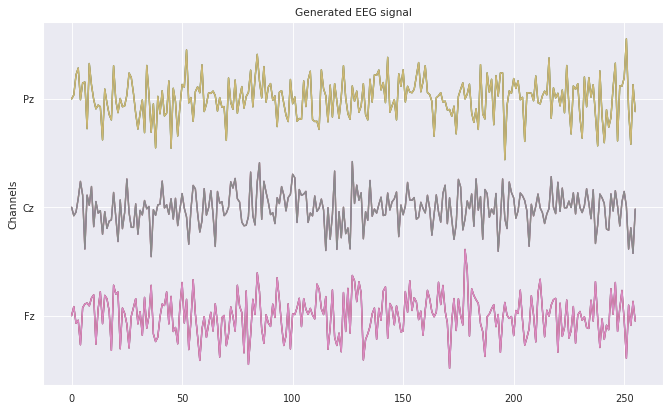

In [ ]:
# wizualizacja wygenerowanego sygnału w dziedzinie czasu
eeg_generator.visualize_multichannel(signal_multichannel_clean)

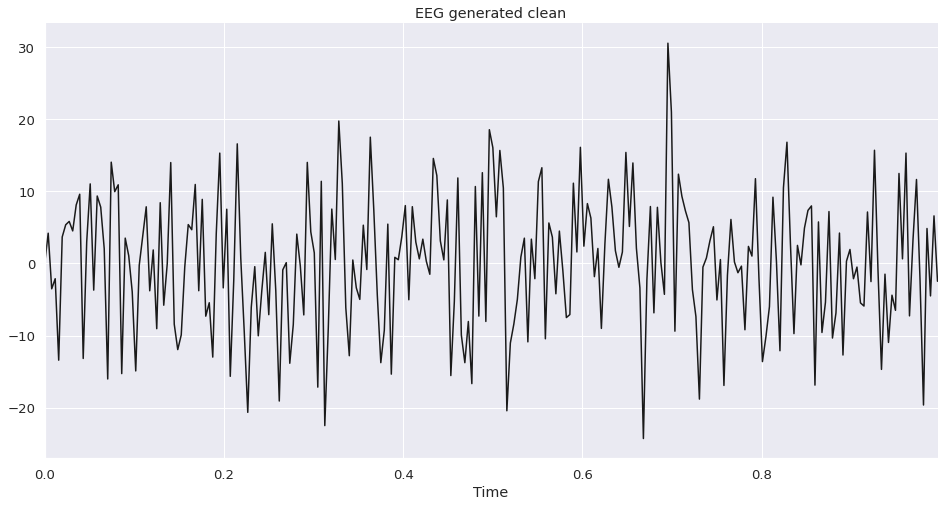

In [ ]:
# wizualizacja wygenerowanego sygnału w dziedzinie czasu
visualize_signal(signal_multichannel_clean[:,0], sf=FS, title='EEG generated clean')

/usr/local/lib/python3.7/dist-packages/scipy/signal/spectral.py:1966: UserWarning: nperseg = 1024 is greater than input length  = 256, using nperseg = 256
  .format(nperseg, input_length))


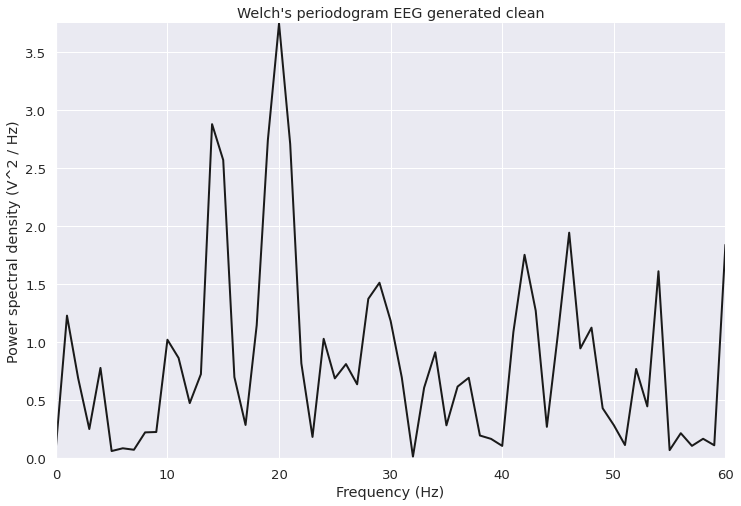

In [ ]:
visualize_psd(signal_multichannel_clean[:,0], sf=FS, title='EEG generated clean')

Band values 
     band         val
0  Delta  124.127434
1  Theta   92.314153
2  Alpha  118.724226
3   Beta  160.247768
4  Gamma  139.498299


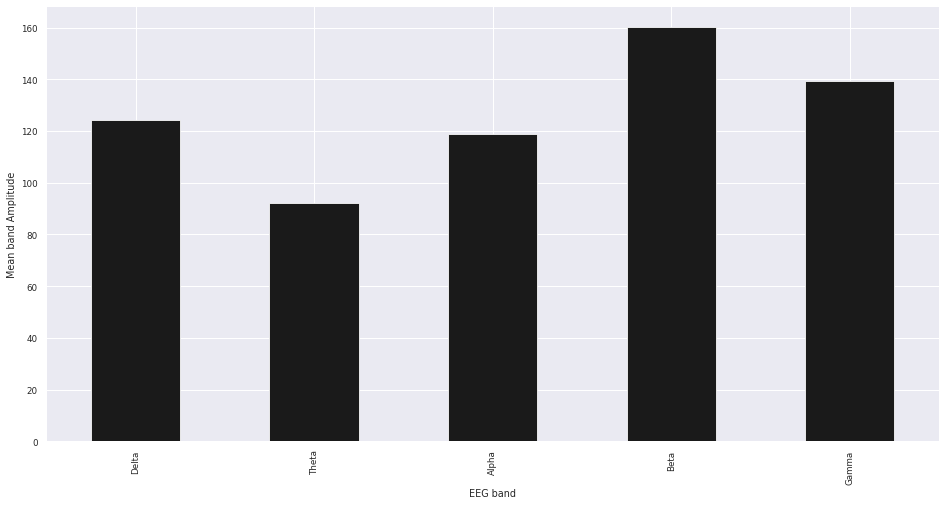

In [ ]:
get_freq_bands(FS, signal_multichannel_clean[:,0])

Band values 
     band         val
0  Delta  489.969424
1  Theta  566.609932
2  Alpha  364.728080
3   Beta  240.605243
4  Gamma  145.344965


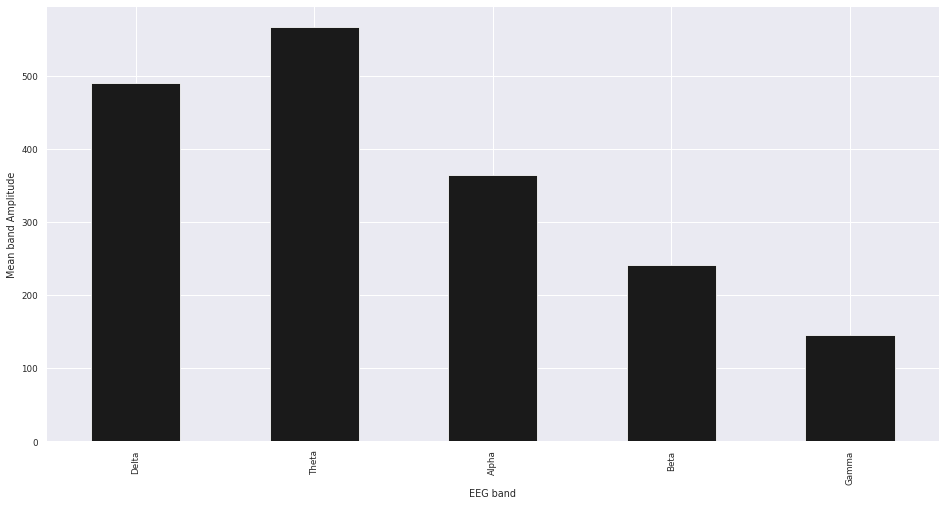

In [ ]:
get_freq_bands(FS, signal_multichannel_with_noise[:,0])

### Wizualizacja wygenerowanego sygnału z artefaktem mrugania oczami (dziedzina czasu, PSD)

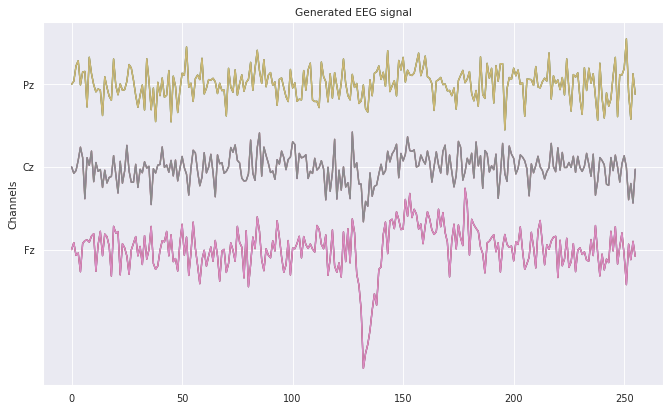

In [ ]:
# wizualizacja wygenerowanego sygnału w dziedzinie czasu
eeg_generator.visualize_multichannel(signal_multichannel_with_noise)

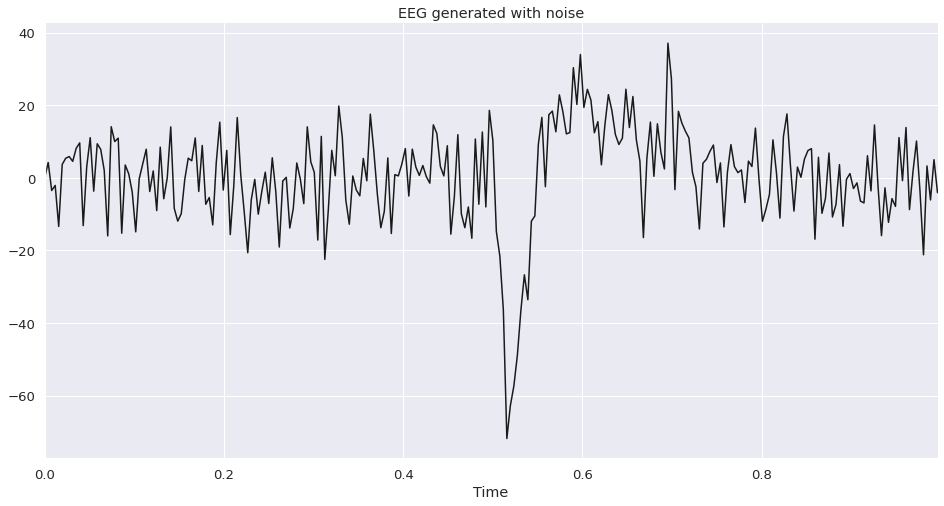

In [ ]:
# wizualizacja wygenerowanego sygnału w dziedzinie czasu
visualize_signal(signal_multichannel_with_noise[:,0], sf=FS, title='EEG generated with noise')

/usr/local/lib/python3.7/dist-packages/scipy/signal/spectral.py:1966: UserWarning: nperseg = 1024 is greater than input length  = 256, using nperseg = 256
  .format(nperseg, input_length))


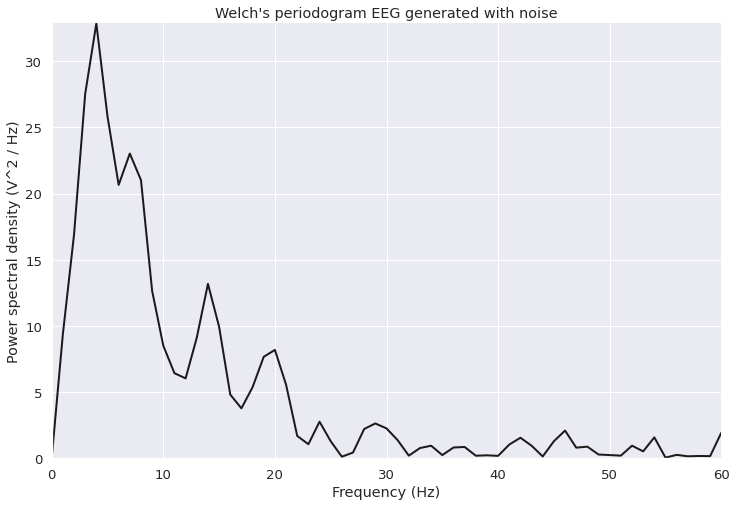

In [ ]:
visualize_psd(signal_multichannel_with_noise[:,0], sf=FS, title='EEG generated with noise')

### Obliczenie metryk dla wygenerowanych sygnałów

In [ ]:
signal_multichannel_with_noise_normalized = normalize_0_to_1(signal_multichannel_with_noise)
signal_multichannel_clean_normalized = normalize_0_to_1(signal_multichannel_clean)

In [ ]:
print('Wartość SNR dla wygenerowanego sygnału zakłóconego', SNR(signal_multichannel_with_noise_normalized))

Wartość SNR dla wygenerowanego sygnału zakłóconego 43.236806150979774


In [ ]:
print('Wartość SNR dla wygenerowanego sygnału bez zakłóceń', SNR(signal_multichannel_clean_normalized))

Wartość SNR dla wygenerowanego sygnału bez zakłóceń 9.997245678612282


In [ ]:
corr_channel_1 = correlation_coefficient(signal_multichannel_with_noise_normalized[:, 0], signal_multichannel_clean_normalized[:, 0])
corr_channel_2 = correlation_coefficient(signal_multichannel_with_noise_normalized[:, 1], signal_multichannel_clean_normalized[:, 1])
corr_channel_3 = correlation_coefficient(signal_multichannel_with_noise_normalized[:, 2], signal_multichannel_clean_normalized[:, 2])

print('Wartość współczynnika korelacji dla kanału 1:', round(corr_channel_1, 6))
print('Wartość współczynnika korelacji dla kanału 2:', round(corr_channel_2, 6))
print('Wartość współczynnika korelacji dla kanału 3:', round(corr_channel_3, 6))

Wartość współczynnika korelacji dla kanału 1: 0.730572
Wartość współczynnika korelacji dla kanału 2: 0.919292
Wartość współczynnika korelacji dla kanału 3: 0.989002


In [ ]:
with_noise = True
df_results = metrics_summary('-', 'EEG - generated normalized', 'blink', '-', signal_multichannel_clean_normalized, signal_multichannel_with_noise_normalized, with_noise)
df_results

,method,signal type,artifacts,noise,SNR - original signal,SNR - signal modified (with added noise or reconstructed),SNR - first channel[dB],SNR - second channel[dB],SNR - third channel[dB],RMSE,PSNR,correlation - first channel,correlation - second channel,correlation - third channel
0,-,EEG - generated normalized,blink,-,9.997246,43.236806,7.514459,7.861223,8.376669,0.201773,13.895611,0.730572,0.919292,0.989002


In [ ]:
# 'Fz', 'Cz', 'Pz'

df_eeg_generated_clean_normalized = pd.DataFrame(list(zip(signal_multichannel_clean[:,0], signal_multichannel_clean[:,1], signal_multichannel_clean[:,2])), columns=['Fz', 'Cz', 'Pz'])

save_df_to_csv(df_eeg_generated_clean_normalized, 'eeg_generated_clean_normalized_Fz_Cz_Pz.csv')

In [ ]:
df_eeg_generated_blink_noise_normalized = pd.DataFrame(list(zip(signal_multichannel_with_noise[:,0], signal_multichannel_with_noise[:,1], signal_multichannel_with_noise[:,2])), columns=['Fz', 'Cz', 'Pz'])

save_df_to_csv(df_eeg_generated_blink_noise_normalized, 'eeg_generated_blink_noise_normalized_Fz_Cz_Pz.csv')

## Załadowanie przykładowych sygnałów z bazy

#### Rozmieszczenie elektrod dla danego badania

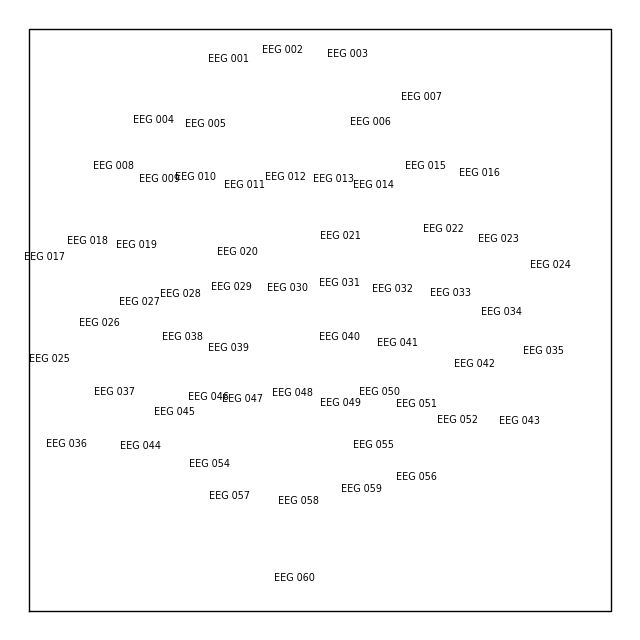

#### Pobranie sygnału EEG z bazy

In [ ]:
# uzyskanie obiektu raw, który opisuje badanie i zawiera zarejestrowane sygnały
# raw = get_sample_raw_EEG(['EEG 002', 'EEG 030', 'EEG 058'])
raw = get_sample_raw_EEG()

Using default location ~/mne_data for sample...
Creating ~/mne_data


100%|██████████████████████████████████████| 1.65G/1.65G [00:00<00:00, 362GB/s]
Untarring contents of '/root/mne_data/MNE-sample-data-processed.tar.gz' to '/root/mne_data'


Attempting to create new mne-python configuration file:
/root/.mne/mne-python.json
Opening raw data file /root/mne_data/MNE-sample-data/MEG/sample/sample_audvis_raw.fif...
    Read a total of 3 projection items:
        PCA-v1 (1 x 102)  idle
        PCA-v2 (1 x 102)  idle
        PCA-v3 (1 x 102)  idle
    Range : 25800 ... 192599 =     42.956 ...   320.670 secs
Ready.
Reading 0 ... 166799  =      0.000 ...   277.714 secs...
Removing projector <Projection | PCA-v1, active : False, n_channels : 102>
Removing projector <Projection | PCA-v2, active : False, n_channels : 102>
Removing projector <Projection | PCA-v3, active : False, n_channels : 102>


#### Wizualizacja i informacje o zarejestrowanych sygnałach

Using matplotlib as 2D backend.
Opening raw-browser...


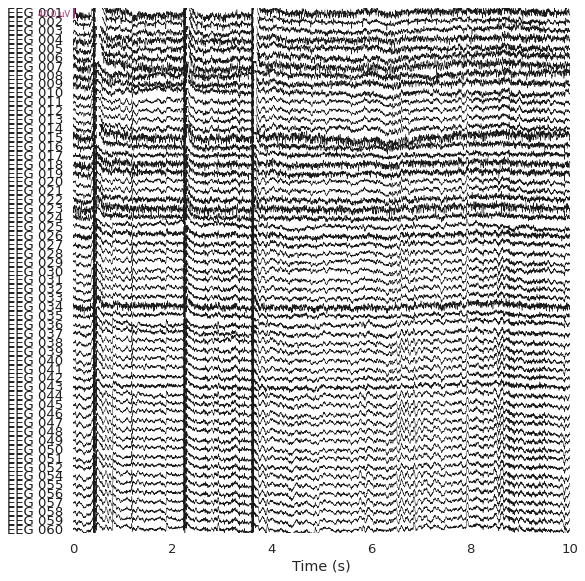

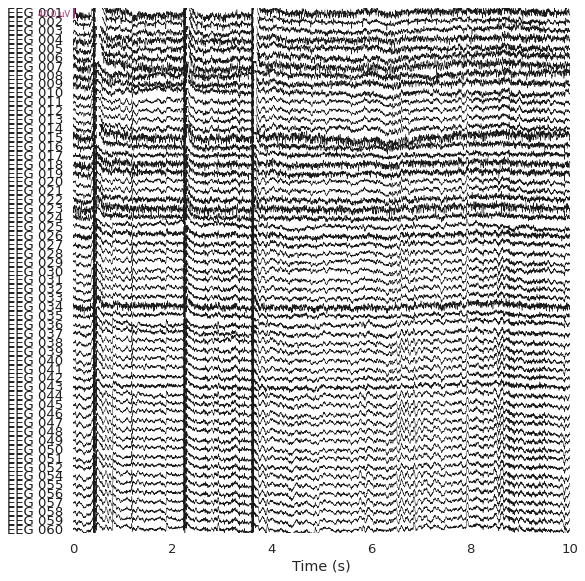

In [ ]:
# wybór kanałów EEG
regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
raw.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

Opening raw-browser...


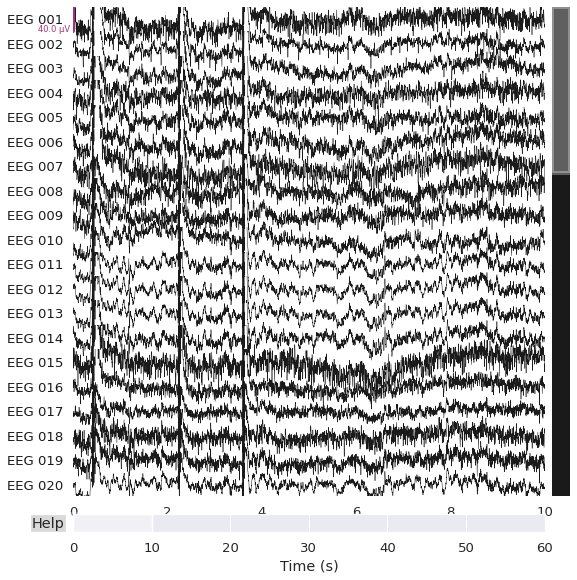

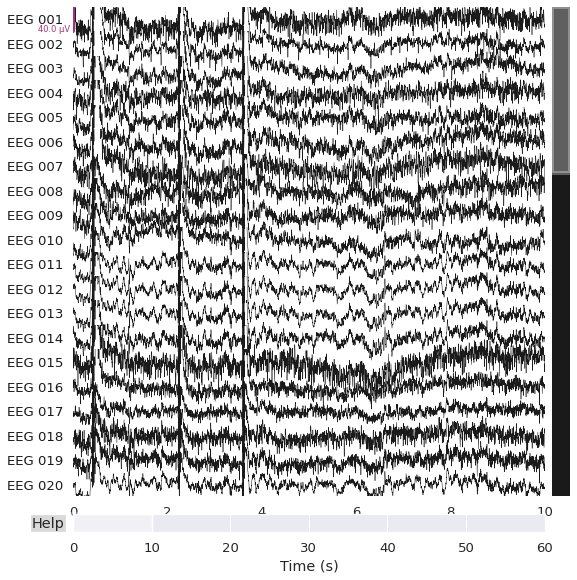

In [ ]:
raw.plot(start=0, duration=10)  # times are in seconds

##### Zestaw danych - BCI

Using default location ~/mne_data for EEGBCI...


Do you want to set the path:
    /root/mne_data
as the default EEGBCI dataset path in the mne-python config [y]/n? y
Extracting EDF parameters from /root/mne_data/MNE-eegbci-data/files/eegmmidb/1.0.0/S001/S001R05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Used Annotations descriptions: ['T1', 'T2']
<Info | 8 non-empty values
 bads: []
 ch_names: FC5, FC3, FC1, FCz, FC2, FC4, FC6, C5, C3, C1, Cz, C2, C4, C6, ...
 chs: 64 EEG
 custom_ref_applied: False
 dig: 67 items (3 Cardinal, 64 EEG)
 highpass: 0.0 Hz
 lowpass: 80.0 Hz
 meas_date: 2009-08-12 16:15:00 UTC
 nchan: 64
 projs: []
 sfreq: 160.0 Hz
>
Opening raw-browser...


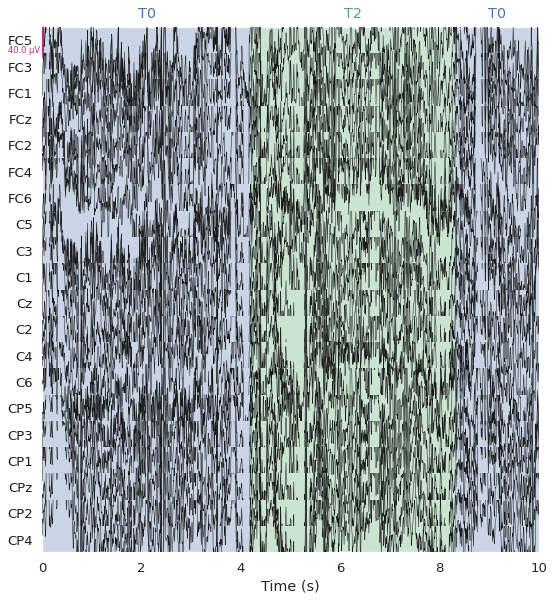

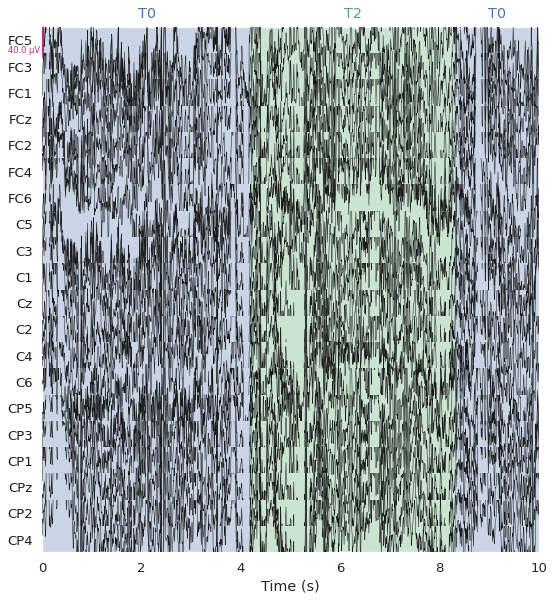

In [ ]:
raw_bci = get_samplpe_raw_EEG_BCI()
print(raw_bci.info)
raw_bci_sfreq = raw_bci.info['sfreq']
raw_bci.plot(show_scrollbars=False)

Opening raw-browser...


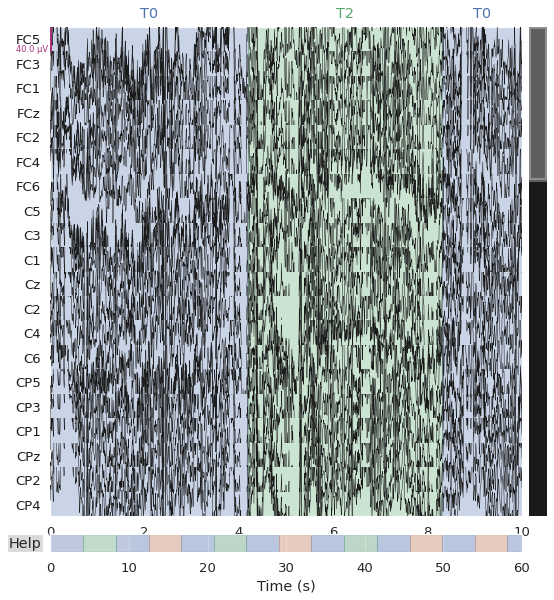

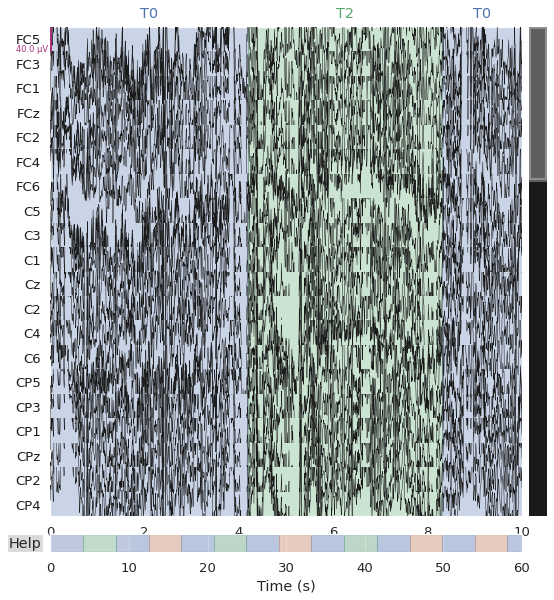

In [ ]:
raw_bci.plot(start=0, duration=10)

##### Konwersja obiektu Raw MNE do struktury DataFrame

In [ ]:
pd.set_option('display.max_columns', None)
df_eeg = convert_raw_to_df(raw)

Sampling frequency of raw signal: 600.614990234375
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  11.398926  42.826079  36.260286  171.312378  49.629732  15.891723   
1     2   9.850159  43.413543  31.192292  173.217773  56.856203  14.683227   
2     3   7.681885  43.883514  32.760957  174.314819  65.456301  19.517211   
3     5   5.823364  44.470977  36.561952  176.451172  70.771639  28.399657   
4     7   0.681458  42.532348  37.406617  170.330811  66.889650  29.668578   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  26.950653  40.089386 -19.729432  40.940002  32.277070  66.811769   
1  17.883728  41.973175 -22.802552  37.965729  31.919099  68.405335   
2  19.196869  46.741516 -11.370545  39.773621  31.561127  68.287294   
3  25.825104  53.393646  -0.061462  46.830231  33.410645  68.346315   
4  30.014649  51.921936  -4.363831  49.921143  33.529969  66.634706   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 

In [ ]:
pd.set_option('display.max_columns', None)
df_eeg_bci = convert_raw_to_df(raw_bci)

Sampling frequency of raw signal: 160.0
   time   FC5   FC3   FC1   FCz   FC2   FC4   FC6    C5    C3    C1    Cz  \
0     0 -10.0  20.0   7.0 -18.0   0.0   4.0  60.0   4.0  12.0   6.0 -10.0   
1     6  10.0  50.0  49.0  22.0  38.0  31.0  84.0  25.0  43.0  49.0  42.0   
2    12  17.0  55.0  59.0  30.0  37.0  25.0  79.0  30.0  48.0  53.0  43.0   
3    19  21.0  63.0  66.0  35.0  40.0  29.0  76.0  35.0  55.0  65.0  52.0   
4    25  27.0  72.0  79.0  48.0  52.0  42.0  91.0  43.0  60.0  76.0  71.0   

     C2    C4    C6   CP5   CP3   CP1   CPz   CP2   CP4   CP6   Fp1   Fpz  \
0 -13.0   6.0  26.0  39.0  15.0  14.0  15.0   6.0  12.0  -8.0 -86.0 -62.0   
1  22.0  31.0  41.0  45.0  41.0  48.0  52.0  36.0  37.0  10.0 -67.0 -44.0   
2  16.0  26.0  35.0  41.0  39.0  50.0  50.0  30.0  29.0   5.0 -78.0 -62.0   
3  22.0  27.0  39.0  64.0  53.0  62.0  63.0  41.0  41.0  14.0 -60.0 -45.0   
4  34.0  40.0  55.0  71.0  57.0  68.0  71.0  51.0  50.0  25.0 -52.0 -42.0   

    Fp2   AF7   AF3   AFz   AF4   

In [ ]:
df_eeg.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6006 entries, 0 to 6005
Data columns (total 60 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   time     6006 non-null   int64  
 1   EEG 001  6006 non-null   float64
 2   EEG 002  6006 non-null   float64
 3   EEG 003  6006 non-null   float64
 4   EEG 004  6006 non-null   float64
 5   EEG 005  6006 non-null   float64
 6   EEG 006  6006 non-null   float64
 7   EEG 007  6006 non-null   float64
 8   EEG 008  6006 non-null   float64
 9   EEG 009  6006 non-null   float64
 10  EEG 010  6006 non-null   float64
 11  EEG 011  6006 non-null   float64
 12  EEG 012  6006 non-null   float64
 13  EEG 013  6006 non-null   float64
 14  EEG 014  6006 non-null   float64
 15  EEG 015  6006 non-null   float64
 16  EEG 016  6006 non-null   float64
 17  EEG 017  6006 non-null   float64
 18  EEG 018  6006 non-null   float64
 19  EEG 019  6006 non-null   float64
 20  EEG 020  6006 non-null   float64
 21  EEG 021  6006 

In [ ]:
df_eeg

,time,EEG 001,EEG 002,EEG 003,EEG 004,EEG 005,EEG 006,EEG 007,EEG 008,EEG 009,EEG 010,EEG 011,EEG 012,EEG 013,EEG 014,EEG 015,EEG 016,EEG 017,EEG 018,EEG 019,EEG 020,EEG 021,EEG 022,EEG 023,EEG 024,EEG 025,EEG 026,EEG 027,EEG 028,EEG 029,EEG 030,EEG 031,EEG 032,EEG 033,EEG 034,EEG 035,EEG 036,EEG 037,EEG 038,EEG 039,EEG 040,EEG 041,EEG 042,EEG 043,EEG 044,EEG 045,EEG 046,EEG 047,EEG 048,EEG 049,EEG 050,EEG 051,EEG 052,EEG 054,EEG 055,EEG 056,EEG 057,EEG 058,EEG 059,EEG 060
0,0,11.398926,42.826079,36.260286,171.312378,49.629732,15.891723,26.950653,40.089386,-19.729432,40.940002,32.277070,66.811769,28.551636,66.385195,77.130525,94.413758,54.237306,58.587523,84.065796,71.267762,72.473875,43.275146,56.952331,99.167359,55.793243,37.788391,63.875365,52.158690,78.787902,60.287294,80.279631,36.037354,54.847719,27.940674,68.747896,22.440246,71.287383,53.960908,58.486633,56.719481,52.365874,69.007874,69.559936,36.281738,18.935059,68.796387,28.853881,77.628904,40.364868,75.612550,56.038056,41.057099,43.392211,59.672853,28.921204,50.738707,69.109191,38.854217,65.839113
1,2,9.850159,43.413543,31.192292,173.217773,56.856203,14.683227,17.883728,41.973175,-22.802552,37.965729,31.919099,68.405335,31.130494,71.038363,73.036165,93.441010,55.537111,64.509519,84.681457,71.556763,75.265715,48.391723,54.636230,101.054627,56.565673,41.001892,64.608916,52.604490,79.738586,61.539552,82.444731,39.010132,58.584596,37.809082,72.235537,24.012878,71.465453,55.350221,60.018005,58.950682,54.435423,71.868897,71.636352,37.047424,20.261719,69.850526,29.940429,79.197752,42.304321,77.580385,57.946473,43.450562,44.788207,61.445314,31.544983,52.276244,70.878295,40.751037,68.002565
2,3,7.681885,43.883514,32.760957,174.314819,65.456301,19.517211,19.196869,46.741516,-11.370545,39.773621,31.561127,68.287294,30.884888,65.640688,70.386873,88.291169,55.241700,66.061888,83.394165,71.498963,74.980833,49.193114,49.528930,101.054627,58.407623,38.800049,61.166869,51.044188,78.669067,60.764344,81.704039,38.524780,57.740785,48.034179,72.885775,23.952392,66.894988,54.183198,58.898926,58.950682,54.309996,73.757172,72.040100,36.046143,18.754151,68.685426,29.095336,78.442381,42.364929,77.162965,57.657319,43.757416,43.973876,61.208986,31.902772,51.706786,70.650024,40.995788,68.177980
3,5,5.823364,44.470977,36.561952,176.451172,70.771639,28.399657,25.825104,53.393646,-0.061462,46.830231,33.410645,68.346315,29.411255,62.042238,80.923830,84.171296,55.478029,64.337034,85.912781,73.001771,74.468046,47.898559,46.975280,98.938599,61.319091,35.467529,62.351836,51.935789,79.025573,61.062501,81.590086,37.796753,54.425813,50.471557,69.752809,23.347534,67.251128,54.016481,59.016724,58.598387,54.247282,73.471070,70.079040,36.517334,18.633545,69.184754,29.638610,78.151853,42.425537,76.984071,57.425996,43.511933,44.730041,61.090822,31.664246,52.219298,71.277770,41.179352,68.587282
4,7,0.681458,42.532348,37.406617,170.330811,66.889650,29.668578,30.014649,51.921936,-4.363831,49.921143,33.529969,66.634706,26.279786,64.151674,93.568178,81.024171,54.828126,60.772337,87.535888,72.539368,72.758757,45.556029,40.502075,98.080750,61.556762,30.647278,64.383208,51.991514,78.074889,59.929505,80.222654,36.037354,50.387575,46.369629,66.265169,22.742675,69.922179,53.516328,58.133240,56.895628,52.616728,70.438386,67.541198,36.458435,18.332032,68.851868,28.733153,77.222166,41.334594,76.149232,55.748902,41.977662,44.264709,60.145509,30.292725,51.763731,70.364684,39.343719,67.242433
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6001,9991,-3.097534,36.187743,43.319276,171.485596,63.903505,24.774169,40.082062,64.225433,-2.458496,62.459747,27.563782,54.476380,16.148560,52.735902,81.405519,85.830689,67.235353,60.254881,85.520996,68.088746,67.232054,39.144897,41.927368,92.704895,41.176483,35.824585,58.176238,46.419005,67.142028,6

##### Wizualizacja PSD

Effective window size : 3.410 (s)


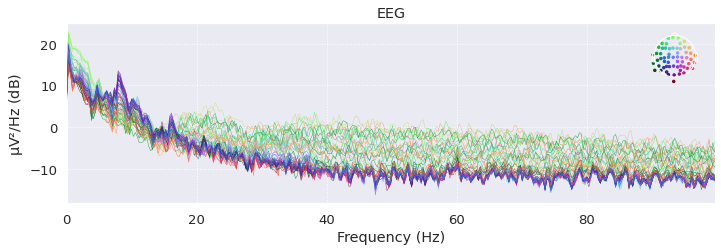

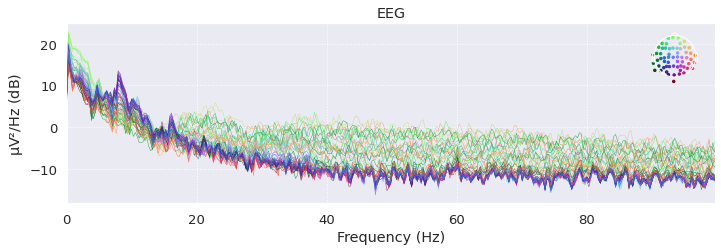

In [ ]:
raw.plot_psd(fmax=100)

Effective window size : 12.800 (s)


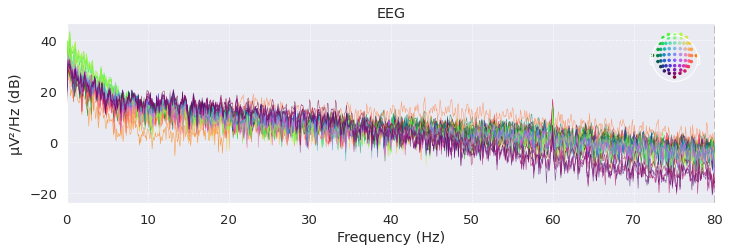

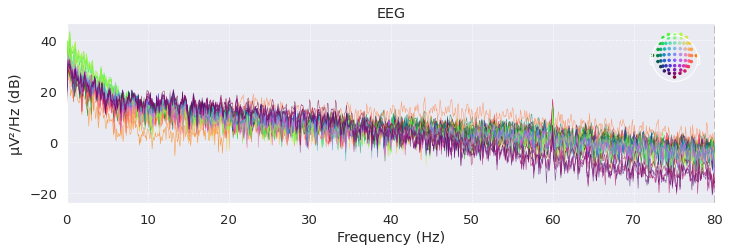

In [ ]:
raw_bci.plot_psd(fmax=80)

##### Zapis sygnału do pliku CSV

In [ ]:
# zapis do pliku csv
save_df_to_csv(df_eeg, 'eeg_real_raw.csv')

In [ ]:
save_df_to_csv(df_eeg_bci, 'eeg_real_raw_bci.csv')

### Wybranie określonych sygnałów *rzeczywistych*

In [ ]:
eeg_channels = df_eeg.columns.tolist()[1:]
fs_audvis = 600.61

In [ ]:
def get_eeg_signal_dict(df_eeg, channels):
  eeg_signals = dict()

  for channel in channels:
    eeg_signal = df_eeg.loc[:, channel]
    eeg_signals[channel] = df_eeg.loc[:, channel]
    
  return eeg_signals

In [ ]:
eeg_signal_dict = get_eeg_signal_dict(df_eeg, eeg_channels)

In [ ]:
print("Liczba kanałów w analizowanym przykładzie:", len(eeg_signal_dict))

Liczba kanałów w analizowanym przykładzie: 59


In [ ]:
df_eeg_signal_dict = pd.DataFrame(eeg_signal_dict)

save_df_to_csv(df_eeg_signal_dict, 'eeg_real_raw.csv')

In [ ]:
eeg_bci_channels = df_eeg_bci.columns.tolist()[1:]

eeg_bci_signal_dict = get_eeg_signal_dict(df_eeg_bci, eeg_bci_channels)

print("Liczba kanałów w analizowanym przykładzie:", len(eeg_bci_signal_dict))

df_eeg_bci_signal_dict = pd.DataFrame(eeg_bci_signal_dict)


save_df_to_csv(df_eeg_bci_signal_dict, 'eeg_real_raw_bci.csv')

Liczba kanałów w analizowanym przykładzie: 64


### Wizualizacja wybranych sygnałów rzeczywistych

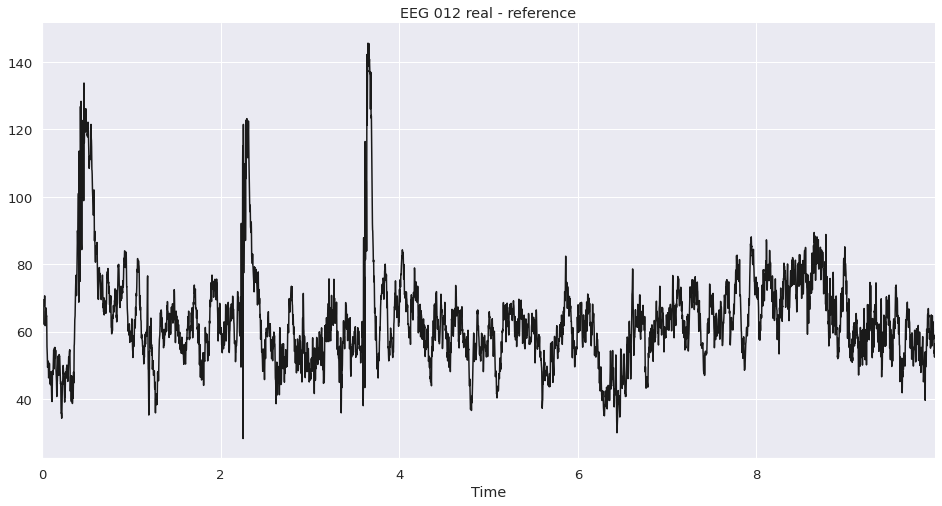

In [ ]:
channel_num = 'EEG 012'
visualize_signal(eeg_signal_dict[channel_num], sf=fs_audvis, title=f'{channel_num} real - reference')

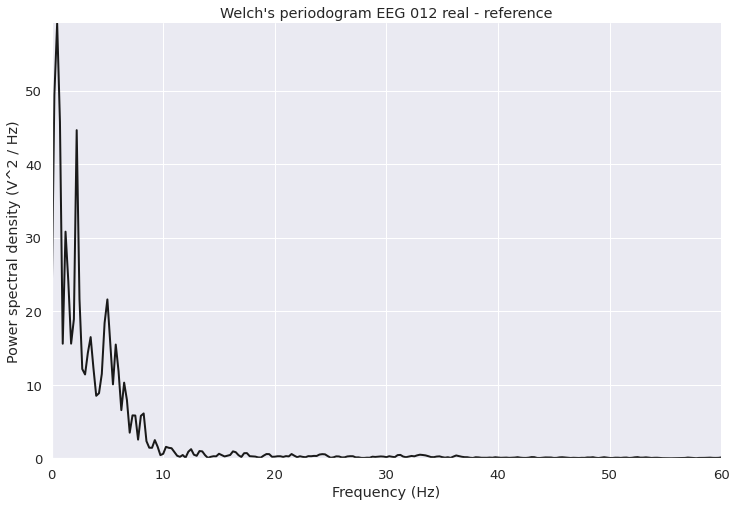

In [ ]:
visualize_psd(eeg_signal_dict[channel_num], sf=fs_audvis, title=f'{channel_num} real - reference')

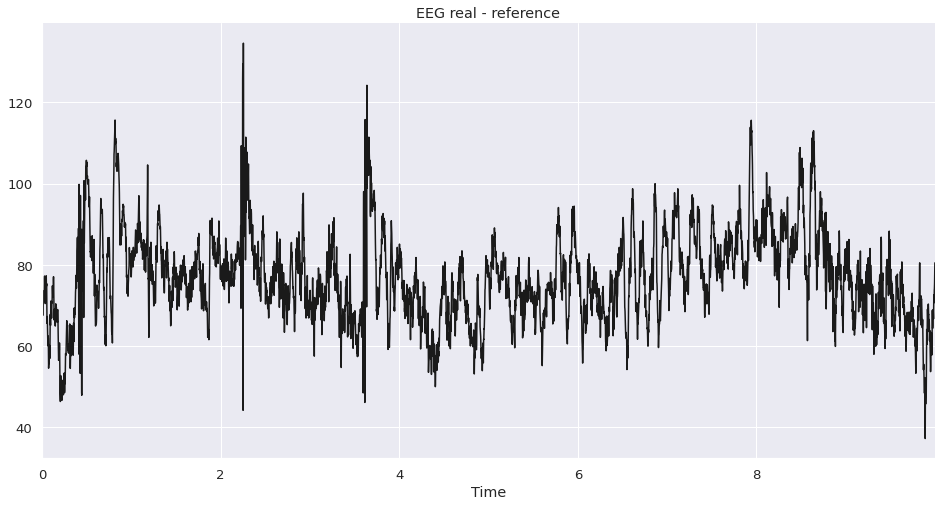

In [ ]:
visualize_signal(eeg_signal_dict['EEG 058'], sf=fs_audvis, title='EEG real - reference')

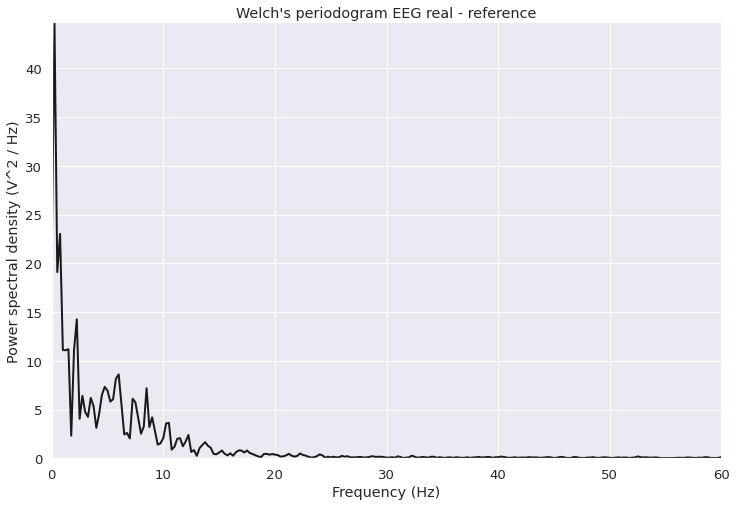

In [ ]:
visualize_psd(eeg_signal_dict['EEG 058'], sf=fs_audvis, title='EEG real - reference')

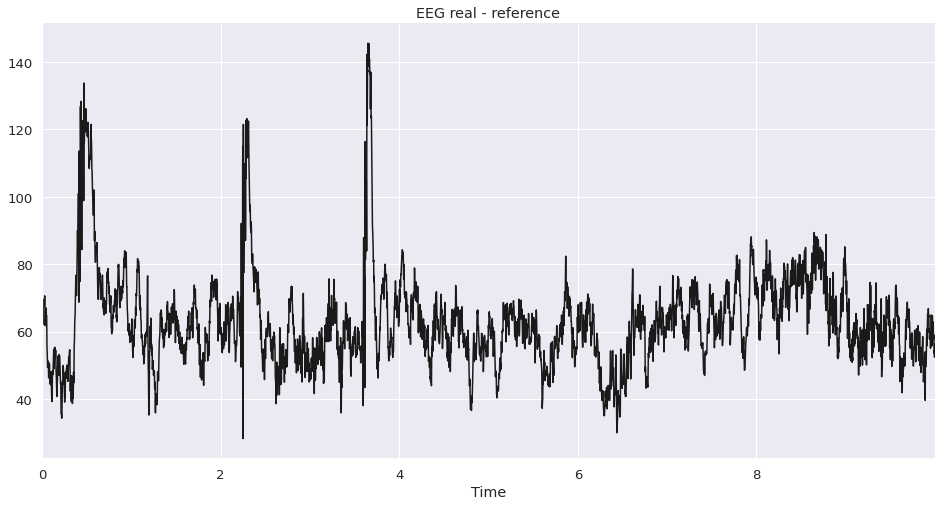

In [ ]:
visualize_signal(eeg_signal_dict['EEG 012'], sf=fs_audvis, title='EEG real - reference')

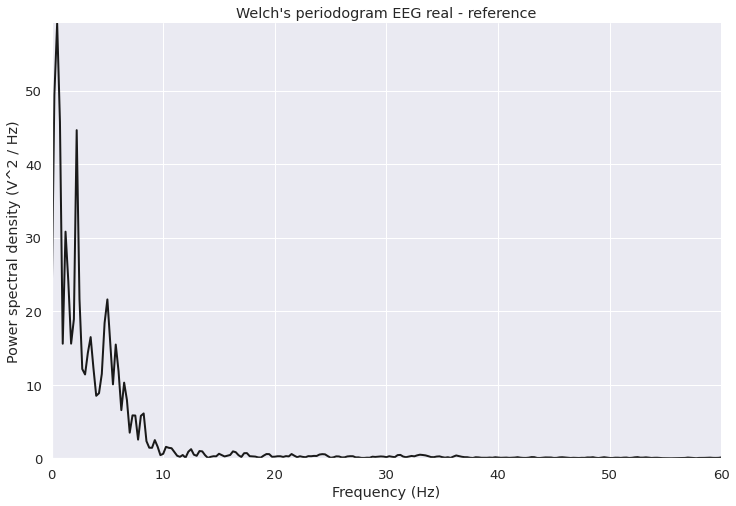

In [ ]:
visualize_psd(eeg_signal_dict['EEG 012'], sf=fs_audvis, title='EEG real - reference')

### Wizualizacja sygnałów rzeczywistych - badanie BCI

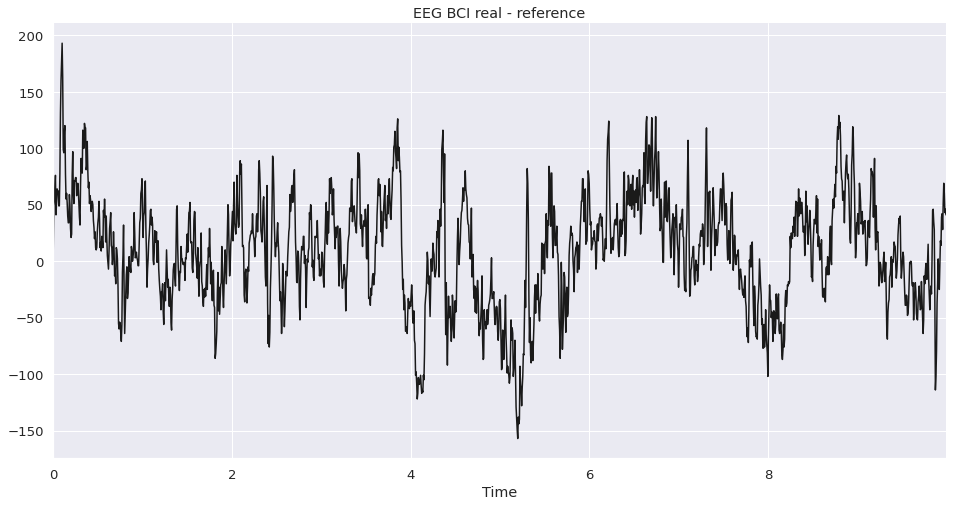

In [ ]:
visualize_signal(eeg_bci_signal_dict['C1'], sf=raw_bci_sfreq, title='EEG BCI real - reference')

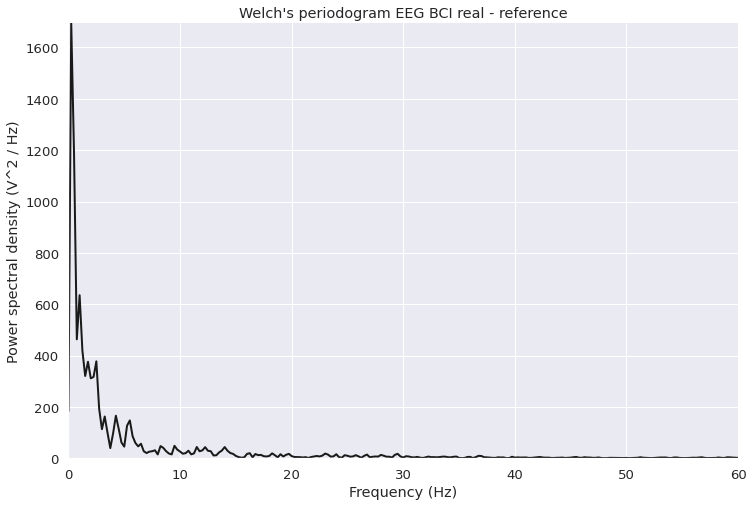

In [ ]:
visualize_psd(eeg_bci_signal_dict['C1'], sf=raw_bci_sfreq, title='EEG BCI real - reference')

### Dodanie artefaktu mrugania oczami

W celu symulacji artefaktu mrugania oczami, największą amplitudę artefaktu dodano do kanałów czołowych, natomiast najmniejszą dla kanałów potylicznych.

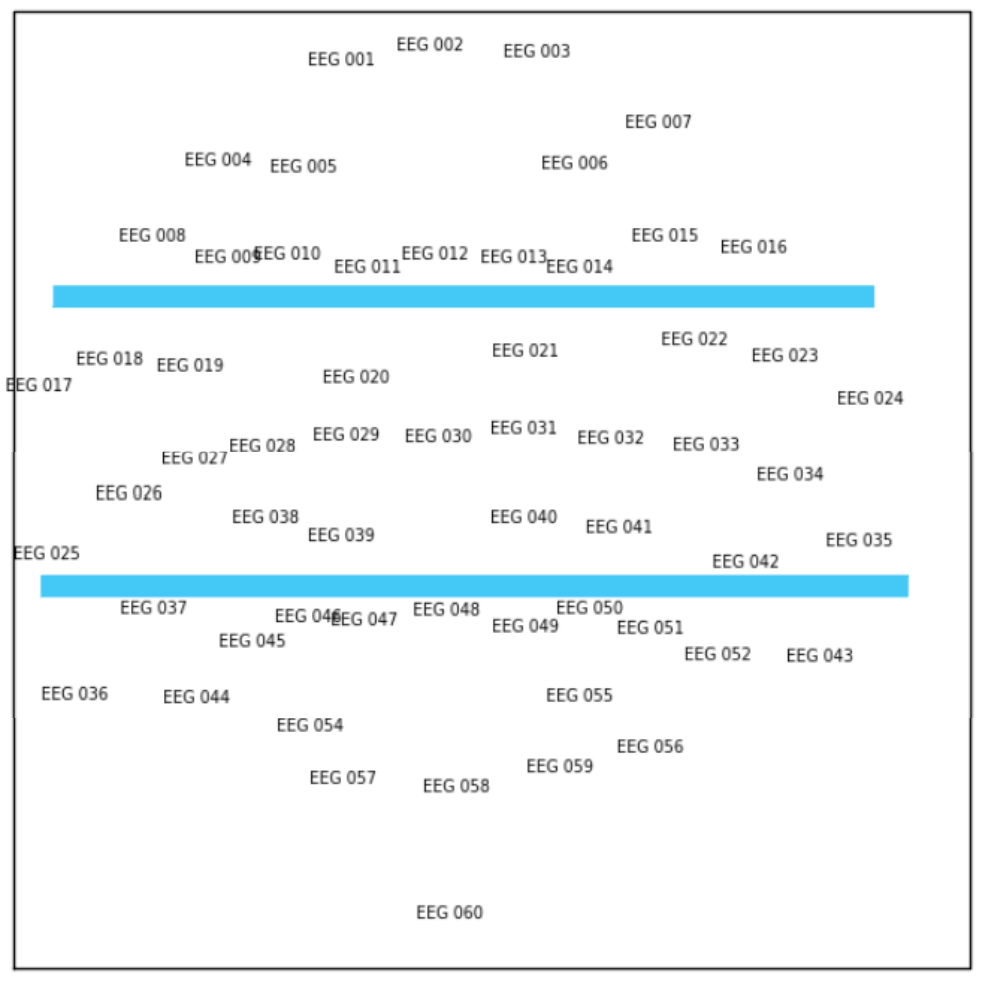

In [ ]:
frontal_channels = eeg_channels[:16]
print(frontal_channels)

['EEG 001', 'EEG 002', 'EEG 003', 'EEG 004', 'EEG 005', 'EEG 006', 'EEG 007', 'EEG 008', 'EEG 009', 'EEG 010', 'EEG 011', 'EEG 012', 'EEG 013', 'EEG 014', 'EEG 015', 'EEG 016']


In [ ]:
central_channels = eeg_channels[16:42]
central_channels.remove('EEG 037')
central_channels.remove('EEG 036')
print('EEG 037' in central_channels)
print('EEG 036' in central_channels)
print(central_channels)

False
False
['EEG 017', 'EEG 018', 'EEG 019', 'EEG 020', 'EEG 021', 'EEG 022', 'EEG 023', 'EEG 024', 'EEG 025', 'EEG 026', 'EEG 027', 'EEG 028', 'EEG 029', 'EEG 030', 'EEG 031', 'EEG 032', 'EEG 033', 'EEG 034', 'EEG 035', 'EEG 038', 'EEG 039', 'EEG 040', 'EEG 041', 'EEG 042']


In [ ]:
parietal_channels = eeg_channels[42:]
parietal_channels.insert(0, 'EEG 036')
parietal_channels.insert(1, 'EEG 037')
print(parietal_channels)

['EEG 036', 'EEG 037', 'EEG 043', 'EEG 044', 'EEG 045', 'EEG 046', 'EEG 047', 'EEG 048', 'EEG 049', 'EEG 050', 'EEG 051', 'EEG 052', 'EEG 054', 'EEG 055', 'EEG 056', 'EEG 057', 'EEG 058', 'EEG 059', 'EEG 060']


In [ ]:
n_samples = len(df_eeg['EEG 001'])
print(n_samples)
blink = create_blink_artifact(n_samples, fs=fs_audvis)

6006


In [ ]:
eeg_signal_dict['EEG 036']

0       22.440246
1       24.012878
2       23.952392
3       23.347534
4       22.742675
          ...    
6001    31.392150
6002    33.206725
6003    33.993041
6004    34.537414
6005    35.807616
Name: EEG 036, Length: 6006, dtype: float64

In [ ]:
def add_blink_for_channels(frontal_channels, central_channels, parietal_channels, eeg_signal_dict):

  frontal_eeg_blink = dict()
  central_eeg_blink = dict()
  parietal_eeg_blink = dict()

  for f_eeg in frontal_channels:
    frontal_eeg_blink[f_eeg] = eeg_signal_dict[f_eeg] + 1000 * create_blink_artifact(len(eeg_signal_dict[f_eeg]), fs=fs_audvis)
  
  for c_eeg in central_channels:
    central_eeg_blink[c_eeg] = eeg_signal_dict[c_eeg] + 300 * create_blink_artifact(len(eeg_signal_dict[c_eeg]), fs=fs_audvis)

  for p_eeg in parietal_channels:
    parietal_eeg_blink[p_eeg] = eeg_signal_dict[p_eeg] + 50 * create_blink_artifact(len(eeg_signal_dict[p_eeg]), fs=fs_audvis)

  return (frontal_eeg_blink, central_eeg_blink, parietal_eeg_blink)

In [ ]:
frontal_eeg_blink, central_eeg_blink, parietal_eeg_blink = add_blink_for_channels(frontal_channels, central_channels, parietal_channels, eeg_signal_dict)

In [ ]:
eeg_signal_blink = {**frontal_eeg_blink, **central_eeg_blink, **parietal_eeg_blink}

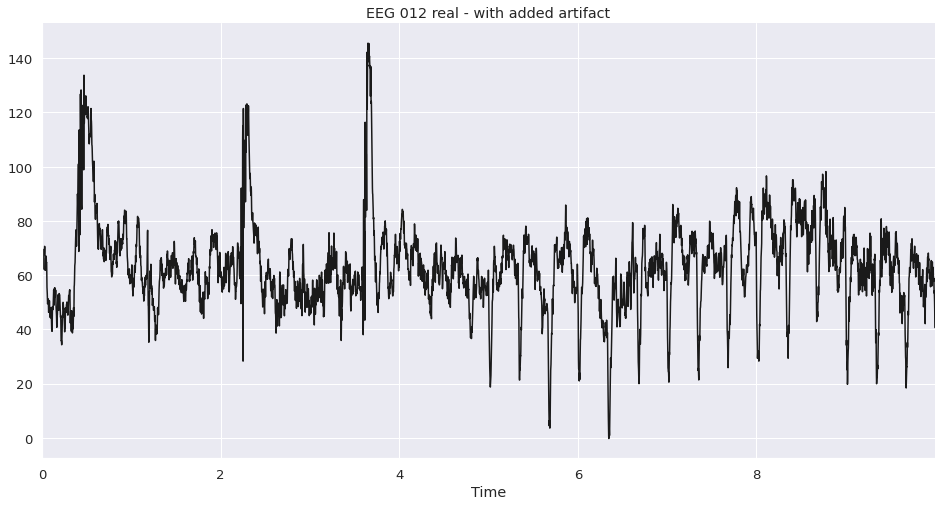

In [ ]:
channel_num = 'EEG 012'
visualize_signal(eeg_signal_blink[channel_num], sf=fs_audvis, title=f'{channel_num} real - with added artifact')

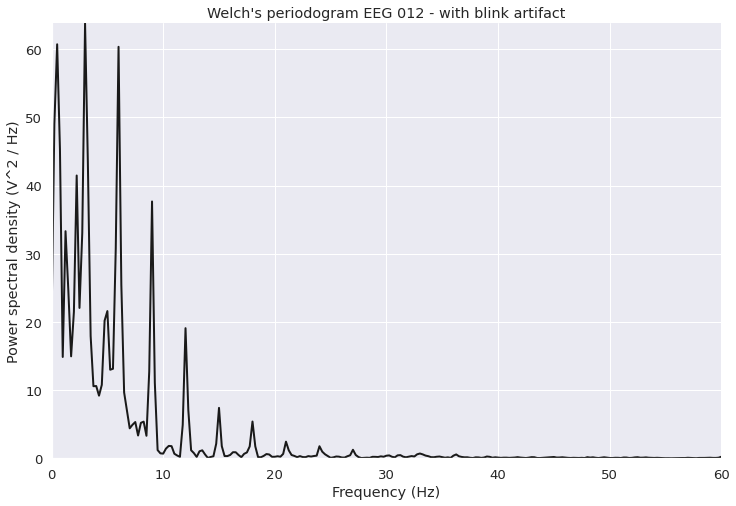

In [ ]:
visualize_psd(eeg_signal_blink[channel_num], sf=fs_audvis, title=f'{channel_num} - with blink artifact')

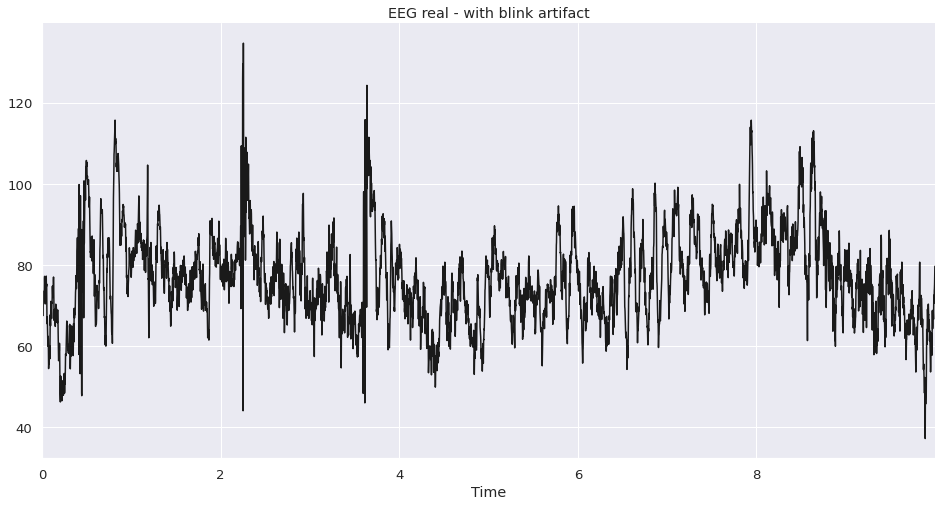

In [ ]:
visualize_signal(eeg_signal_blink['EEG 058'], sf=fs_audvis, title='EEG real - with blink artifact')

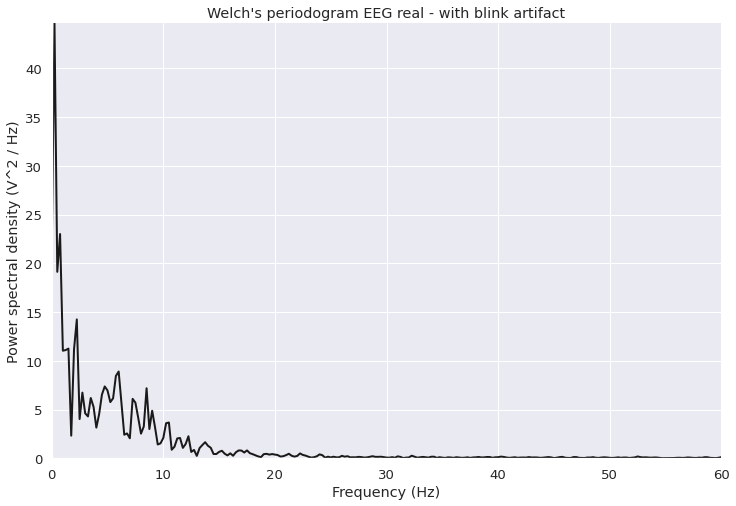

In [ ]:
visualize_psd(eeg_signal_blink['EEG 058'], sf=fs_audvis, title='EEG real - with blink artifact')

#### Zapis sygnału z artefaktem mrugania oczami

In [ ]:
type(eeg_signal_blink)

dict

In [ ]:
len(eeg_signal_blink)

59

In [ ]:
df_eeg_blink = pd.DataFrame(eeg_signal_blink)

save_df_to_csv(df_eeg_blink, 'eeg_real_with_blink.csv')

In [ ]:
df_eeg_blink.columns

Index(['EEG 001', 'EEG 002', 'EEG 003', 'EEG 004', 'EEG 005', 'EEG 006',
       'EEG 007', 'EEG 008', 'EEG 009', 'EEG 010', 'EEG 011', 'EEG 012',
       'EEG 013', 'EEG 014', 'EEG 015', 'EEG 016', 'EEG 017', 'EEG 018',
       'EEG 019', 'EEG 020', 'EEG 021', 'EEG 022', 'EEG 023', 'EEG 024',
       'EEG 025', 'EEG 026', 'EEG 027', 'EEG 028', 'EEG 029', 'EEG 030',
       'EEG 031', 'EEG 032', 'EEG 033', 'EEG 034', 'EEG 035', 'EEG 038',
       'EEG 039', 'EEG 040', 'EEG 041', 'EEG 042', 'EEG 036', 'EEG 037',
       'EEG 043', 'EEG 044', 'EEG 045', 'EEG 046', 'EEG 047', 'EEG 048',
       'EEG 049', 'EEG 050', 'EEG 051', 'EEG 052', 'EEG 054', 'EEG 055',
       'EEG 056', 'EEG 057', 'EEG 058', 'EEG 059', 'EEG 060'],
      dtype='object')

In [ ]:
df_eeg_signal_dict.columns

Index(['EEG 001', 'EEG 002', 'EEG 003', 'EEG 004', 'EEG 005', 'EEG 006',
       'EEG 007', 'EEG 008', 'EEG 009', 'EEG 010', 'EEG 011', 'EEG 012',
       'EEG 013', 'EEG 014', 'EEG 015', 'EEG 016', 'EEG 017', 'EEG 018',
       'EEG 019', 'EEG 020', 'EEG 021', 'EEG 022', 'EEG 023', 'EEG 024',
       'EEG 025', 'EEG 026', 'EEG 027', 'EEG 028', 'EEG 029', 'EEG 030',
       'EEG 031', 'EEG 032', 'EEG 033', 'EEG 034', 'EEG 035', 'EEG 036',
       'EEG 037', 'EEG 038', 'EEG 039', 'EEG 040', 'EEG 041', 'EEG 042',
       'EEG 043', 'EEG 044', 'EEG 045', 'EEG 046', 'EEG 047', 'EEG 048',
       'EEG 049', 'EEG 050', 'EEG 051', 'EEG 052', 'EEG 054', 'EEG 055',
       'EEG 056', 'EEG 057', 'EEG 058', 'EEG 059', 'EEG 060'],
      dtype='object')

### Dodanie szumu

In [ ]:
def add_noise_in_eeg(eeg_signal_dict, noise_type):

  eeg_signal_noise_dict = dict()

  for channel in eeg_signal_dict:
    eeg_signal_noise_dict[channel] = add_noise_type(eeg_signal_dict[channel], noise_type)

  return eeg_signal_noise_dict

#### Dodanie szumu do sygnału referencyjnego

##### Szum różowy

In [ ]:
eeg_signal_noise_dict = add_noise_in_eeg(eeg_signal_dict, 'pink')

NameError: ignored

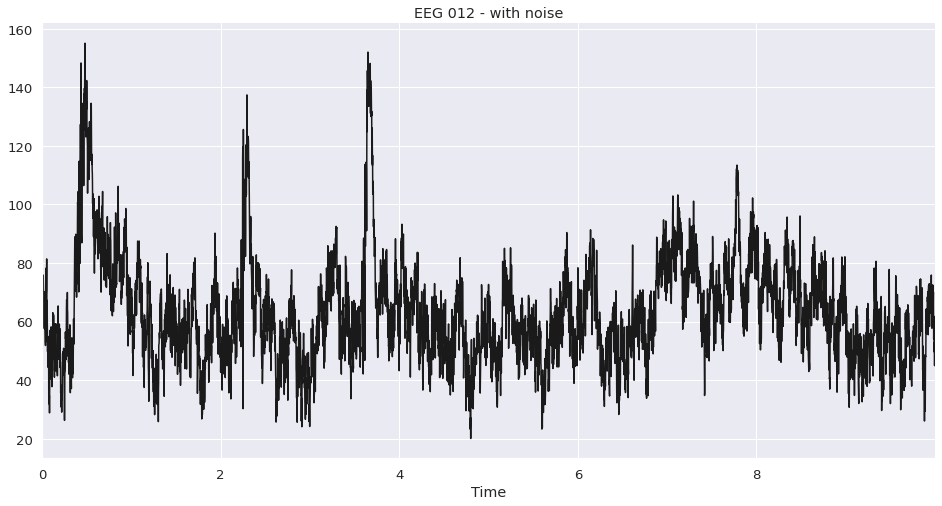

In [ ]:
channel_str = 'EEG 012'
visualize_signal(eeg_signal_noise_dict[channel_str], sf=fs_audvis, title='{channel} - with noise'.format(channel=channel_str))

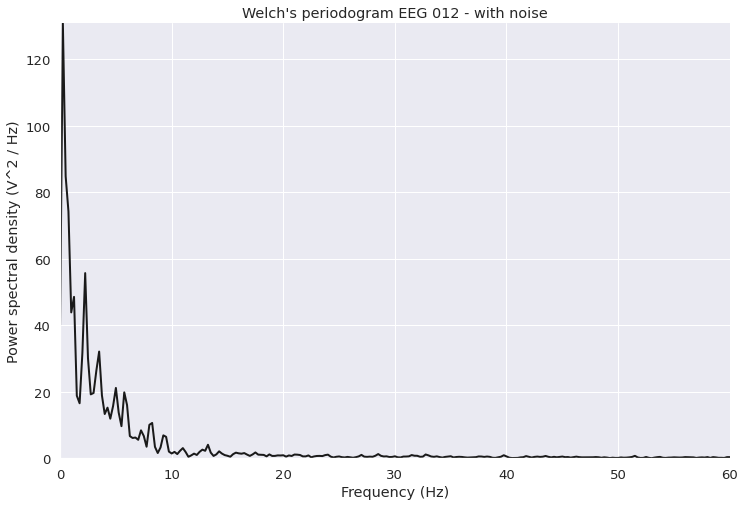

In [ ]:
visualize_psd(eeg_signal_noise_dict[channel_str], sf=fs_audvis, title='{channel} - with noise'.format(channel=channel_str))

Band values 
     band           val
0  Delta  17670.267094
1  Theta   3567.344334
2  Alpha   2250.431152
3   Beta   1165.078861
4  Gamma    806.079338


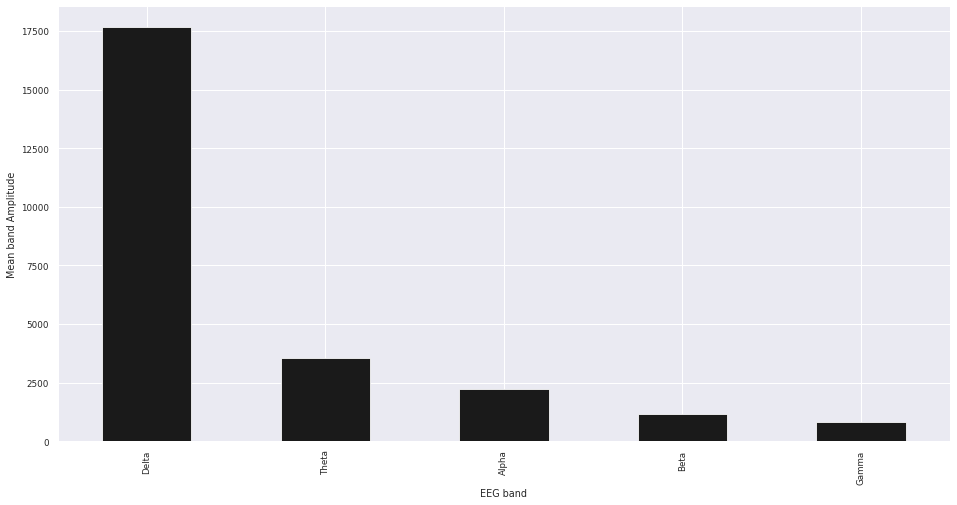

In [ ]:
get_freq_bands(fs_audvis, eeg_signal_noise_dict[channel_str])

#### Dodanie szumu do sygnału z artefaktem

##### Szum różowy

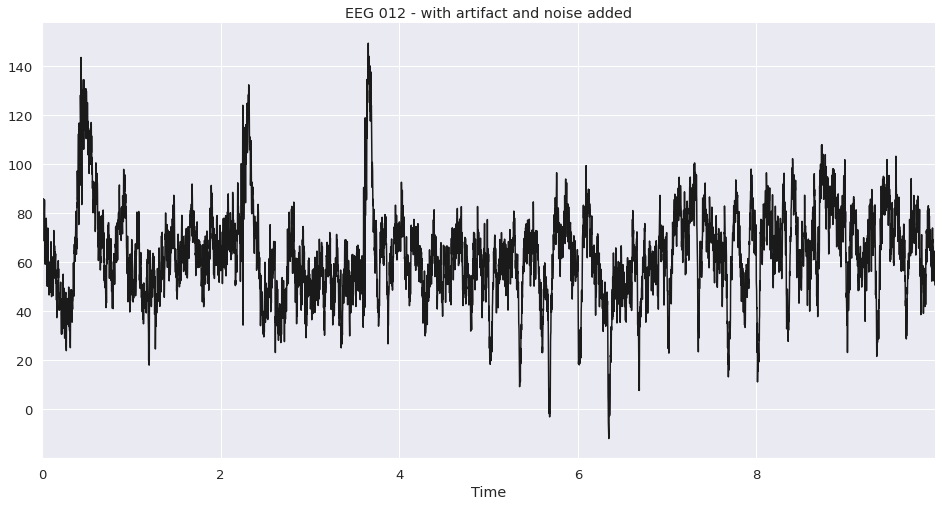

In [ ]:
eeg_signal_artifact_noise_dict = add_noise_in_eeg(eeg_signal_blink, 'pink')

channel_str = 'EEG 012'
visualize_signal(eeg_signal_artifact_noise_dict[channel_str], sf=fs_audvis, title='{channel} - with artifact and noise added'.format(channel=channel_str))

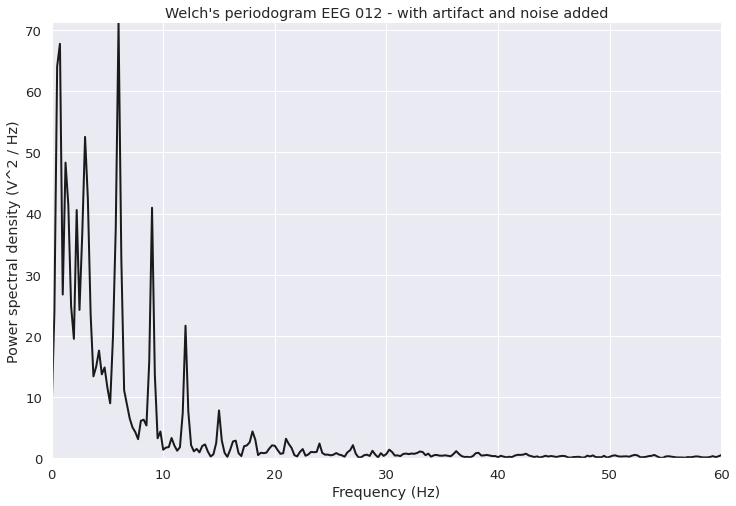

In [ ]:
visualize_psd(eeg_signal_artifact_noise_dict[channel_str], sf=fs_audvis,  title='{channel} - with artifact and noise added'.format(channel=channel_str))

#### Zapis sygnału z artefaktem i szumem



In [ ]:
df_eeg_signal_noise = pd.DataFrame(eeg_signal_noise_dict)

In [ ]:
save_df_to_csv(df_eeg_signal_noise, 'eeg_real_noise.csv')

In [ ]:
df_eeg_signal_noise_artifact = pd.DataFrame(eeg_signal_artifact_noise_dict)

In [ ]:
save_df_to_csv(df_eeg_signal_noise_artifact, 'eeg_real_artifact_noise.csv')

### Normalizacja i zapis sygnałów do pliku csv

In [ ]:
def normalize_eeg_signal(eeg_signal_dict):

  eeg_signal_normalized_dict = dict()

  for channel in eeg_signal_dict:
    eeg_signal_normalized_dict[channel] = normalize_0_to_1(eeg_signal_dict[channel])

  return eeg_signal_normalized_dict

In [ ]:
# sygnał referencyjny

eeg_signal_raw_normalized = normalize_eeg_signal(eeg_signal_dict)
df_eeg_signal_raw_normalized = pd.DataFrame(eeg_signal_raw_normalized)

save_df_to_csv(df_eeg_signal_raw_normalized, 'eeg_real_raw_normalized.csv')

In [ ]:
# sygnał z szumem
eeg_signal_noise_normalized_dict = normalize_eeg_signal(eeg_signal_noise_dict)
df_eeg_noise_normalized = pd.DataFrame(eeg_signal_noise_normalized_dict)

save_df_to_csv(df_eeg_noise_normalized, 'eeg_noise_normalized.csv')

In [ ]:
# sygnał z artefaktem
eeg_blink = normalize_eeg_signal(eeg_signal_blink)
df_eeg_blink_normalized = pd.DataFrame(eeg_blink)

save_df_to_csv(df_eeg_blink_normalized, 'eeg_real_with_blink_normalized.csv')

In [ ]:
# sygnał z szumem i artefaktem

eeg_artifact_noise = normalize_eeg_signal(eeg_signal_artifact_noise_dict)
df_eeg_artifact_noise_normalized = pd.DataFrame(eeg_artifact_noise)

save_df_to_csv(df_eeg_artifact_noise_normalized, 'eeg_real_artifact_noise_normalized.csv')

In [ ]:
# sygnał EEG BCI referencyjny

eeg_bci_signal_raw_normalized = normalize_eeg_signal(eeg_bci_signal_dict)
df_eeg_bci_signal_raw_normalized = pd.DataFrame(eeg_bci_signal_raw_normalized)

save_df_to_csv(df_eeg_bci_signal_raw_normalized, 'eeg_bci_real_raw_normalized.csv')

## Tworzenie obiektu MNE

In [ ]:
def create_mne_object(eeg_signal_values, fs, ch_names, dataset_description, channels=59):
  n_channels = 59
  sampling_freq = fs_audvis
  ch_names = eeg_channels
  ch_types = ['eeg'] * len(eeg_channels)
  info = mne.create_info(ch_names, ch_types=ch_types, sfreq=sampling_freq)
  info.set_montage(raw.get_montage())
  info['description'] = dataset_description
  print(info)

  simulated_raw = mne.io.RawArray(eeg_signal_values, info)

  regexp = r'(EEG)'
  artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
  # wyświetlenie zarejestrowanych sygnałów
  simulated_raw.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

  simulated_raw.plot_psd(fmax=100)

  return simulated_raw

In [ ]:
eeg_values = np.array(list(eeg_signal_dict.values())) / 1000000
print(eeg_values)
print(eeg_values.shape)

[[ 1.13989260e-05  9.85015885e-06  7.68188489e-06 ... -8.36334242e-06
  -5.14190682e-06 -4.64630134e-06]
 [ 4.28260794e-05  4.34135428e-05  4.38835135e-05 ...  3.38378899e-05
   3.70689384e-05  3.95362846e-05]
 [ 3.62602856e-05  3.11922923e-05  3.27609569e-05 ...  4.29572768e-05
   4.48879409e-05  4.56722732e-05]
 ...
 [ 6.91091911e-05  7.08782951e-05  7.06500236e-05 ...  7.54437247e-05
   7.86395255e-05  8.04656973e-05]
 [ 3.88542173e-05  4.07510373e-05  4.09957883e-05 ...  4.60131833e-05
   5.04187009e-05  5.26214596e-05]
 [ 6.58391126e-05  6.80025648e-05  6.81779798e-05 ...  6.45527356e-05
   6.80610365e-05  6.94058851e-05]]
(59, 6006)


<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


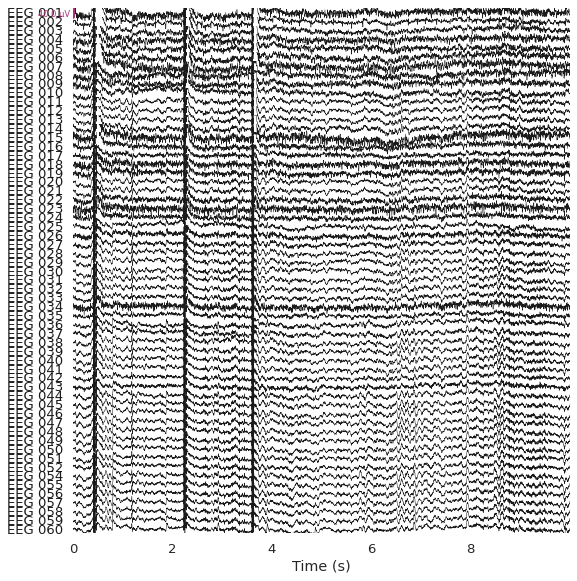

Effective window size : 3.410 (s)


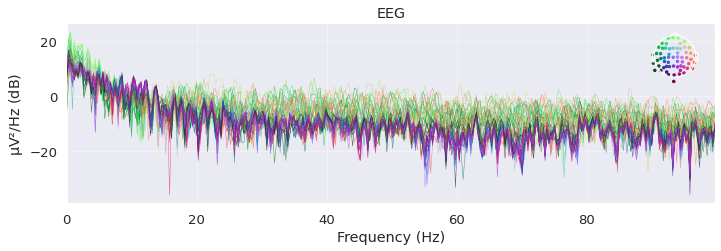

In [ ]:
simulated_raw = create_mne_object(eeg_signal_values=eeg_values, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

In [ ]:
df_simulated_raw = simulated_raw.to_data_frame()

df_simulated_raw

,time,EEG 001,EEG 002,EEG 003,EEG 004,EEG 005,EEG 006,EEG 007,EEG 008,EEG 009,EEG 010,EEG 011,EEG 012,EEG 013,EEG 014,EEG 015,EEG 016,EEG 017,EEG 018,EEG 019,EEG 020,EEG 021,EEG 022,EEG 023,EEG 024,EEG 025,EEG 026,EEG 027,EEG 028,EEG 029,EEG 030,EEG 031,EEG 032,EEG 033,EEG 034,EEG 035,EEG 036,EEG 037,EEG 038,EEG 039,EEG 040,EEG 041,EEG 042,EEG 043,EEG 044,EEG 045,EEG 046,EEG 047,EEG 048,EEG 049,EEG 050,EEG 051,EEG 052,EEG 054,EEG 055,EEG 056,EEG 057,EEG 058,EEG 059,EEG 060
0,0,11.398926,42.826079,36.260286,171.312378,49.629732,15.891723,26.950653,40.089386,-19.729432,40.940002,32.277070,66.811769,28.551636,66.385195,77.130525,94.413758,54.237306,58.587523,84.065796,71.267762,72.473875,43.275146,56.952331,99.167359,55.793243,37.788391,63.875365,52.158690,78.787902,60.287294,80.279631,36.037354,54.847719,27.940674,68.747896,22.440246,71.287383,53.960908,58.486633,56.719481,52.365874,69.007874,69.559936,36.281738,18.935059,68.796387,28.853881,77.628904,40.364868,75.612550,56.038056,41.057099,43.392211,59.672853,28.921204,50.738707,69.109191,38.854217,65.839113
1,2,9.850159,43.413543,31.192292,173.217773,56.856203,14.683227,17.883728,41.973175,-22.802552,37.965729,31.919099,68.405335,31.130494,71.038363,73.036165,93.441010,55.537111,64.509519,84.681457,71.556763,75.265715,48.391723,54.636230,101.054627,56.565673,41.001892,64.608916,52.604490,79.738586,61.539552,82.444731,39.010132,58.584596,37.809082,72.235537,24.012878,71.465453,55.350221,60.018005,58.950682,54.435423,71.868897,71.636352,37.047424,20.261719,69.850526,29.940429,79.197752,42.304321,77.580385,57.946473,43.450562,44.788207,61.445314,31.544983,52.276244,70.878295,40.751037,68.002565
2,3,7.681885,43.883514,32.760957,174.314819,65.456301,19.517211,19.196869,46.741516,-11.370545,39.773621,31.561127,68.287294,30.884888,65.640688,70.386873,88.291169,55.241700,66.061888,83.394165,71.498963,74.980833,49.193114,49.528930,101.054627,58.407623,38.800049,61.166869,51.044188,78.669067,60.764344,81.704039,38.524780,57.740785,48.034179,72.885775,23.952392,66.894988,54.183198,58.898926,58.950682,54.309996,73.757172,72.040100,36.046143,18.754151,68.685426,29.095336,78.442381,42.364929,77.162965,57.657319,43.757416,43.973876,61.208986,31.902772,51.706786,70.650024,40.995788,68.177980
3,5,5.823364,44.470977,36.561952,176.451172,70.771639,28.399657,25.825104,53.393646,-0.061462,46.830231,33.410645,68.346315,29.411255,62.042238,80.923830,84.171296,55.478029,64.337034,85.912781,73.001771,74.468046,47.898559,46.975280,98.938599,61.319091,35.467529,62.351836,51.935789,79.025573,61.062501,81.590086,37.796753,54.425813,50.471557,69.752809,23.347534,67.251128,54.016481,59.016724,58.598387,54.247282,73.471070,70.079040,36.517334,18.633545,69.184754,29.638610,78.151853,42.425537,76.984071,57.425996,43.511933,44.730041,61.090822,31.664246,52.219298,71.277770,41.179352,68.587282
4,7,0.681458,42.532348,37.406617,170.330811,66.889650,29.668578,30.014649,51.921936,-4.363831,49.921143,33.529969,66.634706,26.279786,64.151674,93.568178,81.024171,54.828126,60.772337,87.535888,72.539368,72.758757,45.556029,40.502075,98.080750,61.556762,30.647278,64.383208,51.991514,78.074889,59.929505,80.222654,36.037354,50.387575,46.369629,66.265169,22.742675,69.922179,53.516328,58.133240,56.895628,52.616728,70.438386,67.541198,36.458435,18.332032,68.851868,28.733153,77.222166,41.334594,76.149232,55.748902,41.977662,44.264709,60.145509,30.292725,51.763731,70.364684,39.343719,67.242433
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6001,9992,-3.097534,36.187743,43.319276,171.485596,63.903505,24.774169,40.082062,64.225433,-2.458496,62.459747,27.563782,54.476380,16.148560,52.735902,81.405519,85.830689,67.235353,60.254881,85.520996,68.088746,67.232054,39.144897,41.927368,92.704895,41.176483,35.824585,58.176238,46.419005,67.142028,6

In [ ]:
df_simulated_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6006 entries, 0 to 6005
Data columns (total 60 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   time     6006 non-null   int64  
 1   EEG 001  6006 non-null   float64
 2   EEG 002  6006 non-null   float64
 3   EEG 003  6006 non-null   float64
 4   EEG 004  6006 non-null   float64
 5   EEG 005  6006 non-null   float64
 6   EEG 006  6006 non-null   float64
 7   EEG 007  6006 non-null   float64
 8   EEG 008  6006 non-null   float64
 9   EEG 009  6006 non-null   float64
 10  EEG 010  6006 non-null   float64
 11  EEG 011  6006 non-null   float64
 12  EEG 012  6006 non-null   float64
 13  EEG 013  6006 non-null   float64
 14  EEG 014  6006 non-null   float64
 15  EEG 015  6006 non-null   float64
 16  EEG 016  6006 non-null   float64
 17  EEG 017  6006 non-null   float64
 18  EEG 018  6006 non-null   float64
 19  EEG 019  6006 non-null   float64
 20  EEG 020  6006 non-null   float64
 21  EEG 021  6006 

In [ ]:
save_df_to_csv(df_simulated_raw, 'eeg_simulated_raw.csv')

## Metoda ICA

### Klasa zarządzająca metodą ICA (FastICA)

In [ ]:
class ICAManager(object):
    """ICAManager - class for specifying ICA settings and performing ICA.
    """
    def __init__(self, n_components, method):
        self.n_components = n_components
        self.method = method.lower()
        if self.method == 'fastica':
            self.ica = FastICA(n_components=self.n_components)

    def perform(self, signal, method, n_components):
        self.signal = signal
        self.n_components = n_components
        self.method = method.lower()

        if self.method == 'fastica':
            self.ica.fit(self.signal)
            self.components = self.ica.transform(self.signal)

            return self.components

    def visualize_components(self, components):
        print("Components length", len(components))
        plt.figure(figsize=(12, 8), dpi=120)
        plt.plot(components + [x + 0.5 for x in range(self.n_components)])
        plt.yticks([x + 0.5 for x in range(self.n_components)], [str(x) for x in range(self.n_components)])
        plt.xlim(0, 500)
        plt.title("EEG components") 
        plt.ylabel('Component number')
        plt.xlabel('Time [samples]')

    def exclude_components(self, components, components_to_exclude):
        for component_num in components_to_exclude:
            components[:, component_num] = 0
        return components

    def reconstruct(self, components):
        reconstructed_signal = self.ica.inverse_transform(components)
        return reconstructed_signal

### ICA - funkcje realizujące operacje

In [ ]:
def ica_get_components(components_num, signal, method):
  # wyznaczenie komponentów zawartych w sygnale
  components = ica_manager.perform(signal=SIGNAL, method='fastica', n_components=COMPONENTS_NUM)

  ica_manager.visualize_components(components)

  return components

In [ ]:
def exclude_components(components):
  components_to_exclude = list(input("Wprowadź komponenty do usunięcia (np.: 1, 2)").replace(" ", "").split(","))

  # konwersja listy str do int
  components_to_exclude = list(map(int, components_to_exclude))

  components = ica_manager.exclude_components(components, components_to_exclude)

  ica_manager.visualize_components(components)

  reconstructed_signal = ica_manager.reconstruct(components)

  return reconstructed_signal

In [ ]:
def run_ica(method, n_components=20, fit_params=None):
    ica = ICA(n_components=n_components, method=method, fit_params=fit_params,
              max_iter='auto', random_state=0)
    t0 = time()
    ica.fit(raw)
    fit_time = time() - t0
    title = ('ICA decomposition using %s (took %.1fs)' % (method, fit_time))
    ica.plot_components(title=title)

### ICA - przykład działania - sygnał wygenerowany 

In [ ]:
# wyznaczenie liczby przewidywanych komponentów
COMPONENTS_NUM = 3
# inicjalizacja obiektu realizującego algorytm ICA
ica_manager = ICAManager(method='fastica', n_components=COMPONENTS_NUM)

Components length 256


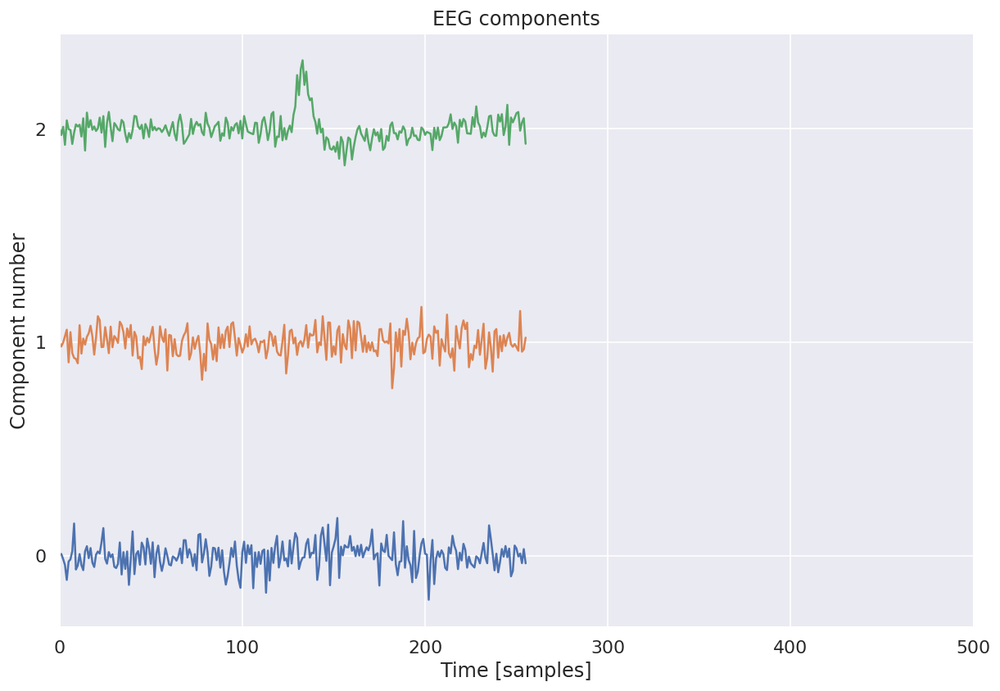

In [ ]:
SIGNAL = signal_multichannel_with_noise

components = ica_get_components(COMPONENTS_NUM, SIGNAL, 'fastica')

In [ ]:
reconstructed_signal = exclude_components(components)

Wprowadź komponenty do usunięcia (np.: 1, 2)


ValueError: ignored

In [ ]:
eeg_generator.visualize_multichannel(reconstructed_signal)

In [ ]:
print('Wartość SNR dla wygenerowanego sygnału poddanego metodzie FastICA:', SNR(reconstructed_signal))
print('Wartość SNR dla wygenerowanego sygnału niezakłóconego:', SNR(signal_multichannel_clean))
print('Wartość SNR dla wygenerowanego sygnału zakłóconego:', SNR(signal_multichannel_with_noise))

corr_channel_1 = correlation_coefficient(reconstructed_signal[:, 0], signal_multichannel_clean[:, 0])
corr_channel_2 = correlation_coefficient(reconstructed_signal[:, 1], signal_multichannel_clean[:, 1])
corr_channel_3 = correlation_coefficient(reconstructed_signal[:, 2], signal_multichannel_clean[:, 2])

print('Wartość współczynnika korelacji dla kanału 1:', round(corr_channel_1, 6))
print('Wartość współczynnika korelacji dla kanału 2:', round(corr_channel_2, 6))
print('Wartość współczynnika korelacji dla kanału 3:', round(corr_channel_3, 6))

mse_with_noise = calculate_rmse(signal_multichannel_with_noise, signal_multichannel_clean)
mse_reconstructed = calculate_rmse(reconstructed_signal, signal_multichannel_clean)

print("Wartość MSE dla sygnału z zakłóceniami i sygnału oryginalnego", mse_with_noise)
print("Wartość MSE dla sygnału zrekonstruowanego i sygnału oryginalnego", mse_reconstructed)

In [ ]:
df_results = df_results.append(metrics_summary('FastICA', 'EEG - generated normalized', 'blink', '-', signal_multichannel_clean_normalized, normalize_0_to_1(reconstructed_signal), with_noise=False))
df_results

### ICA (MNE) - przykład działania - sygnał załadowany z bazy

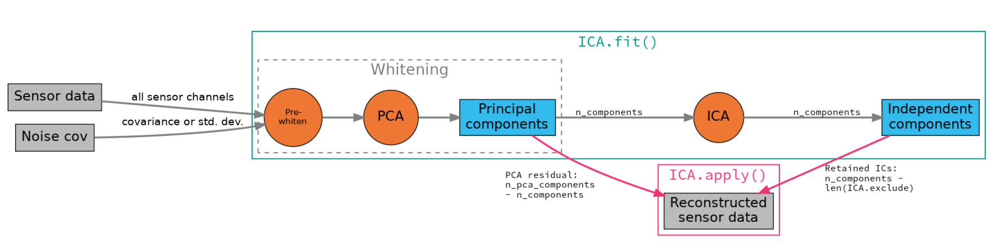

Opening raw data file /root/mne_data/MNE-sample-data/MEG/sample/sample_audvis_raw.fif...
    Read a total of 3 projection items:
        PCA-v1 (1 x 102)  idle
        PCA-v2 (1 x 102)  idle
        PCA-v3 (1 x 102)  idle
    Range : 25800 ... 192599 =     42.956 ...   320.670 secs
Ready.
Reading 0 ... 166799  =      0.000 ...   277.714 secs...
Removing projector <Projection | PCA-v1, active : False, n_channels : 102>
Removing projector <Projection | PCA-v2, active : False, n_channels : 102>
Removing projector <Projection | PCA-v3, active : False, n_channels : 102>
Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by number: 14 components
Fitting ICA took 28.8s.


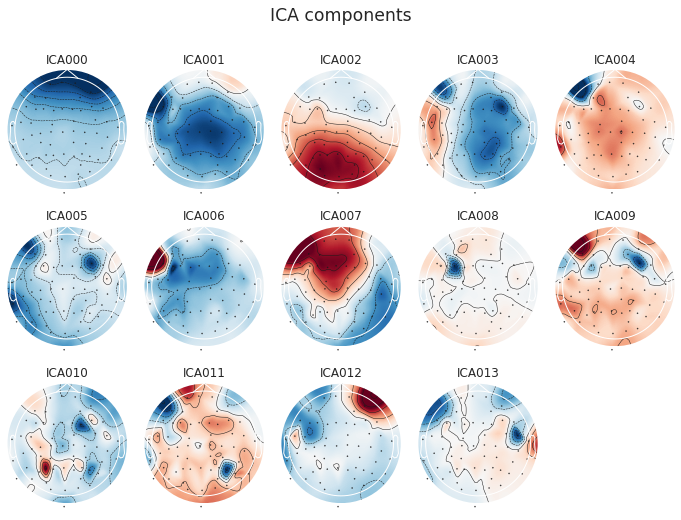

[<MNEFigure size 702x526.68 with 14 Axes>]

In [ ]:
raw = get_sample_raw_EEG()

ica = ICA(n_components=14, max_iter='auto', random_state=97)
ica.fit(raw)
ica.plot_components()

Creating RawArray with float64 data, n_channels=14, n_times=36038
    Range : 25800 ... 61837 =     42.956 ...   102.956 secs
Ready.
Opening ica-browser...


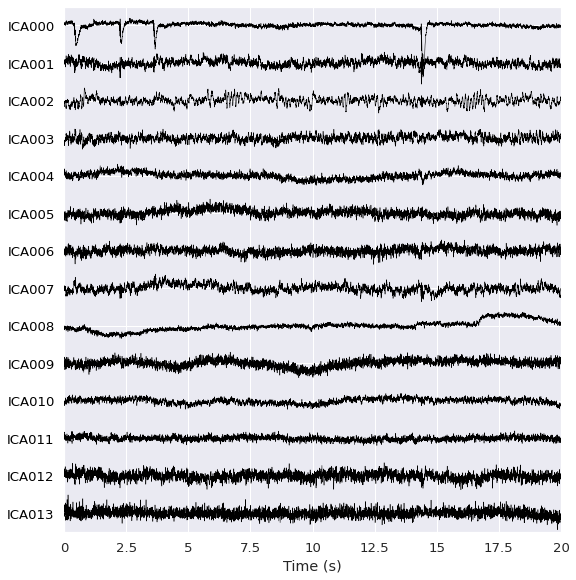

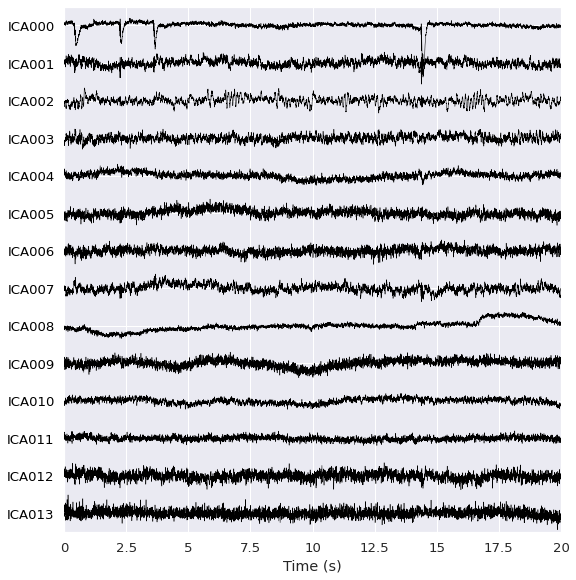

In [ ]:
ica.plot_sources(raw, show_scrollbars=False)

In [ ]:
# wybranie komponentów na podstawie weryfikacji wizualnej
ica.exclude = [0, 8, 13, 11]

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 4 ICA components
    Projecting back using 59 PCA components
Opening raw-browser...


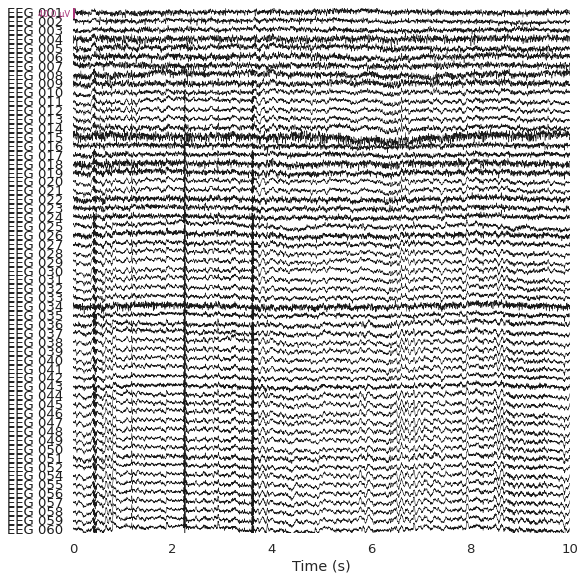

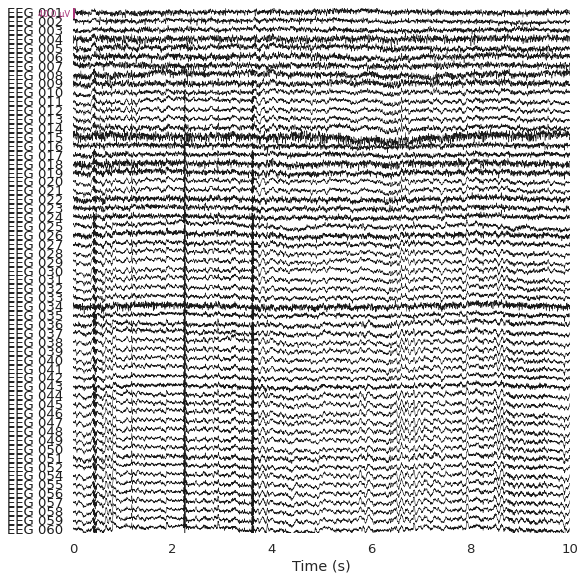

In [ ]:
reconst_raw = raw.copy()
ica.apply(reconst_raw)

reconst_raw.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

Opening raw-browser...


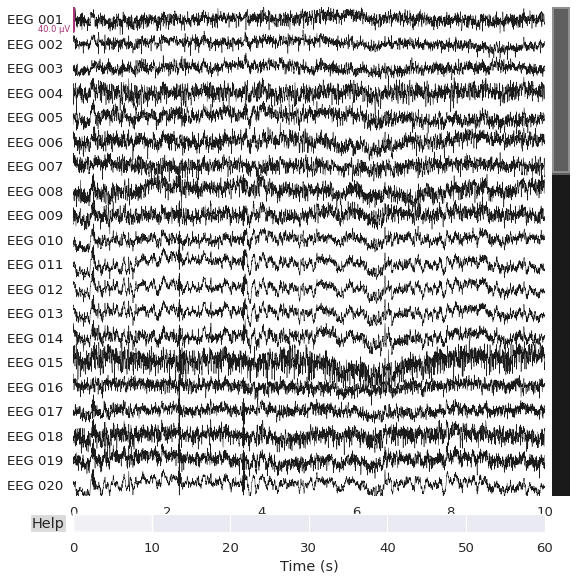

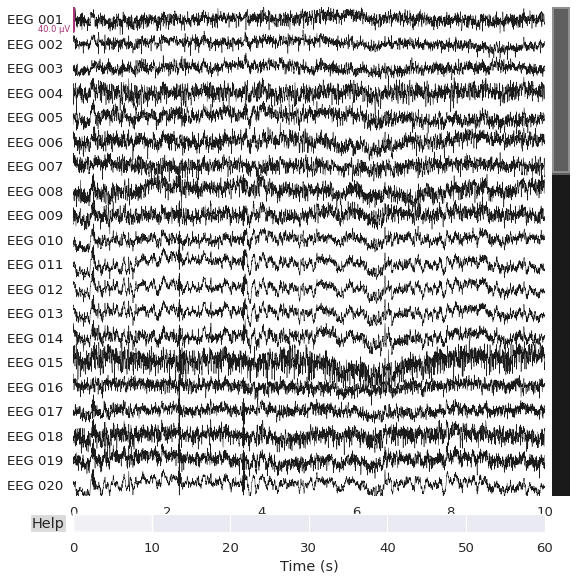

In [ ]:
reconst_raw.plot(start=0, duration=10) 

Effective window size : 3.410 (s)


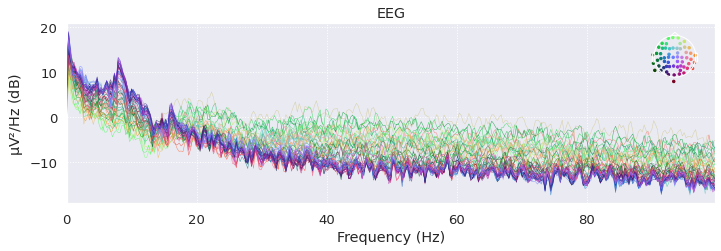

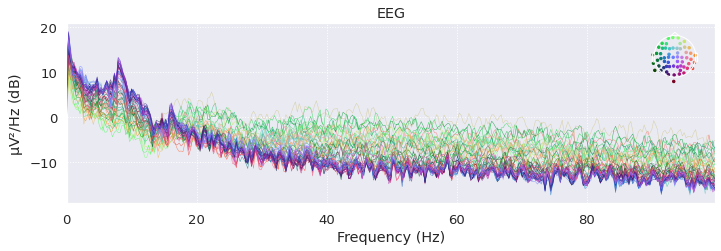

In [ ]:
reconst_raw.plot_psd(fmax=100)

Obliczenie metryk dla załadowanych sygnałów

In [ ]:
# konwersja raw do struktury dataframe
df_raw = convert_raw_to_df(raw)
df_reconst_raw = convert_raw_to_df(reconst_raw)

Sampling frequency of raw signal: 600.614990234375
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  11.398926  42.826079  36.260286  171.312378  49.629732  15.891723   
1     2   9.850159  43.413543  31.192292  173.217773  56.856203  14.683227   
2     3   7.681885  43.883514  32.760957  174.314819  65.456301  19.517211   
3     5   5.823364  44.470977  36.561952  176.451172  70.771639  28.399657   
4     7   0.681458  42.532348  37.406617  170.330811  66.889650  29.668578   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  26.950653  40.089386 -19.729432  40.940002  32.277070  66.811769   
1  17.883728  41.973175 -22.802552  37.965729  31.919099  68.405335   
2  19.196869  46.741516 -11.370545  39.773621  31.561127  68.287294   
3  25.825104  53.393646  -0.061462  46.830231  33.410645  68.346315   
4  30.014649  51.921936  -4.363831  49.921143  33.529969  66.634706   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 

In [ ]:
# usunięcie pierwszej kolumny
df_raw.drop("time", axis=1, inplace=True)
df_reconst_raw.drop("time", axis=1, inplace=True)

In [ ]:
# konwersja ze struktury dataframe do numpy array
# normalizacja
array_eeg_raw = normalize_0_to_1(df_raw.to_numpy())
array_eeg_reconst_raw = normalize_0_to_1(df_reconst_raw.to_numpy())

In [ ]:
print("Wartość SNR dla sygnału przed odszumieniem:", SNR(array_eeg_raw))

Wartość SNR dla sygnału przed odszumieniem: 12.716410845768173


In [ ]:
print("Wartość SNR dla sygnału po odszumieniu:", SNR(array_eeg_reconst_raw ))

Wartość SNR dla sygnału po odszumieniu: 11.587645095276901


In [ ]:
df_after_ICA_mne = metrics_summary('ICA (mne)', 'EEG - real normalized', '-', '-', array_eeg_raw, array_eeg_reconst_raw, with_noise=False)
df_after_ICA_mne

,method,signal type,artifacts,noise,SNR - original signal,SNR - signal modified (with added noise or reconstructed),SNR - first channel[dB],SNR - second channel[dB],SNR - third channel[dB],RMSE,PSNR,correlation - first channel,correlation - second channel,correlation - third channel
0,ICA (mne),EEG - real normalized,-,-,12.716411,11.587645,7.972065,10.920326,10.961536,0.058955,24.019595,0.262301,0.203408,0.358505


In [ ]:
df_results = df_results.append(df_after_ICA_mne)
df_results

,method,signal type,artifacts,noise,SNR - original signal,SNR - signal modified (with added noise or reconstructed),SNR - first channel[dB],SNR - second channel[dB],SNR - third channel[dB],RMSE,PSNR,correlation - first channel,correlation - second channel,correlation - third channel
0,-,EEG - generated normalized,blink,-,9.913324,36.639950,11.823283,13.012370,13.118955,0.138292,17.154368,0.709646,0.935483,0.986854
0,ICA (mne),EEG - real normalized,-,-,12.716411,11.587645,7.972065,10.920326,10.961536,0.058955,24.019595,0.262301,0.203408,0.358505


### FastICA (MNE) - sygnał z wprowadzonym artefaktem

<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


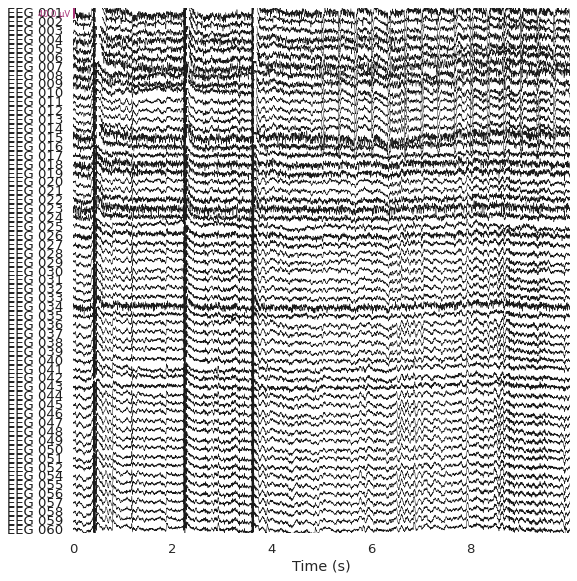

Effective window size : 3.410 (s)


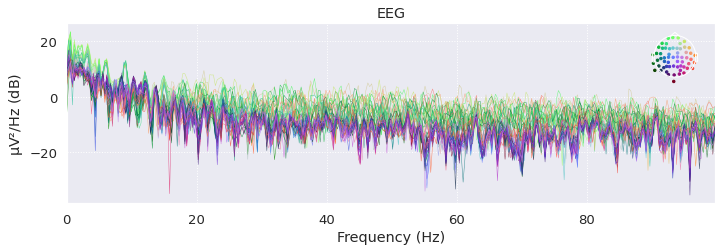

In [ ]:
eeg_values_blink = np.array(list(eeg_signal_blink.values())) / 1000000

simulated_blink = create_mne_object(eeg_signal_values=eeg_values_blink, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

In [ ]:
ica = mne.preprocessing.ICA(n_components=14, random_state=97)
ica.fit(simulated_blink)

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by number: 14 components


<ipython-input-90-fd7dd6847aa4>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(simulated_blink)


Fitting ICA took 0.9s.


Method,fastica
Fit,47 iterations on raw data (6006 samples)
ICA components,14
Explained variance,96.4 %
Available PCA components,59
Channel types,eeg
ICA components marked for exclusion,—


Creating RawArray with float64 data, n_channels=14, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


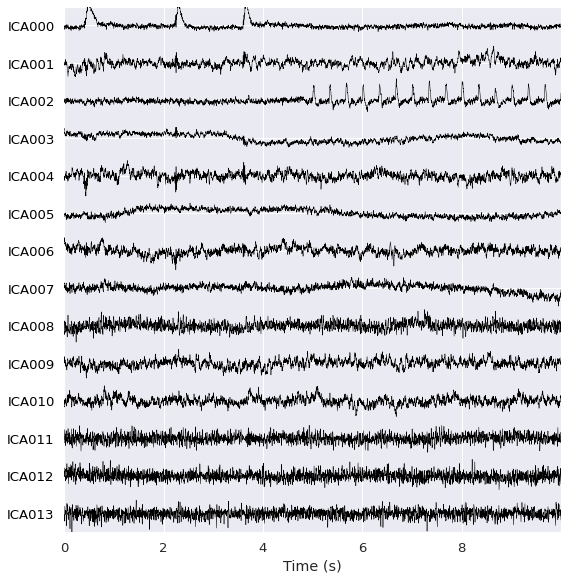

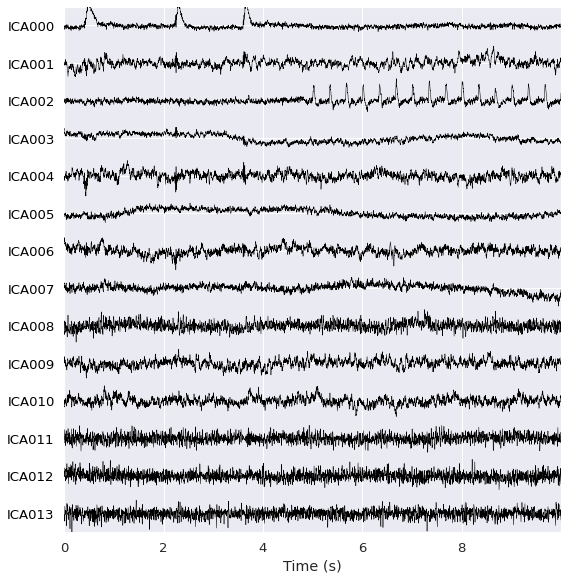

In [ ]:
ica.plot_sources(simulated_blink, show_scrollbars=False)

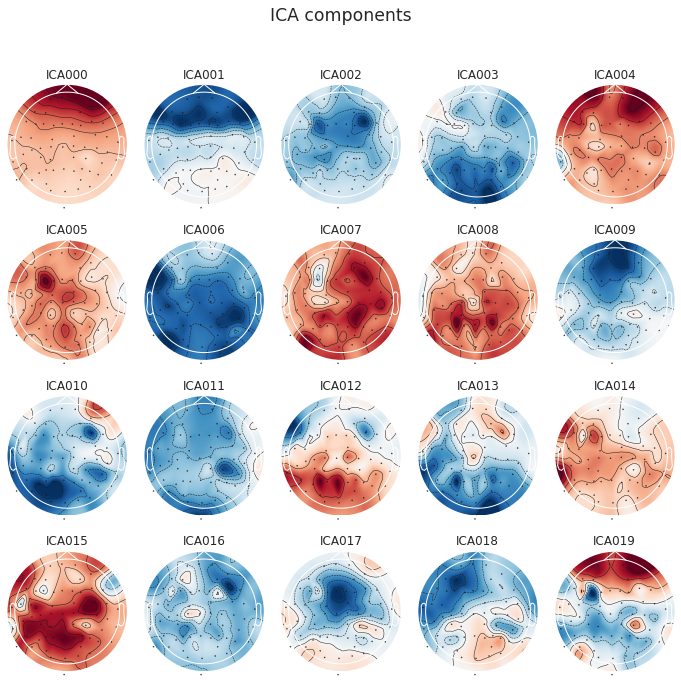

In [ ]:
ica.plot_components(picks=np.arange(20));

In [ ]:
ica.exclude.extend([2])

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 59 PCA components
Opening raw-browser...


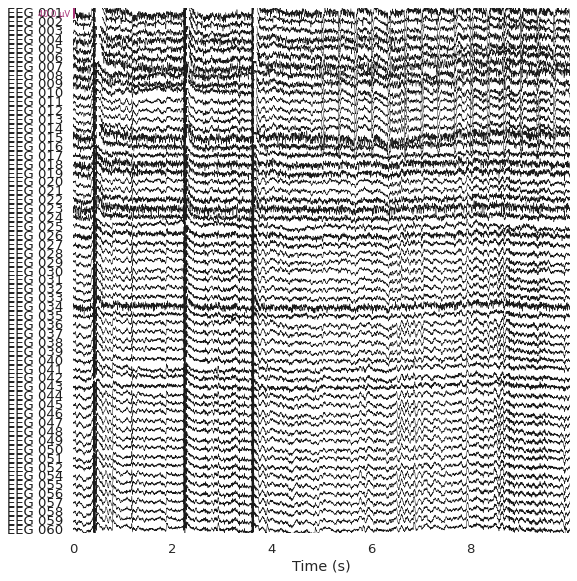

Effective window size : 3.410 (s)


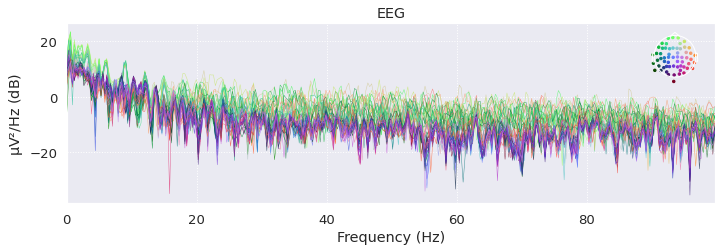

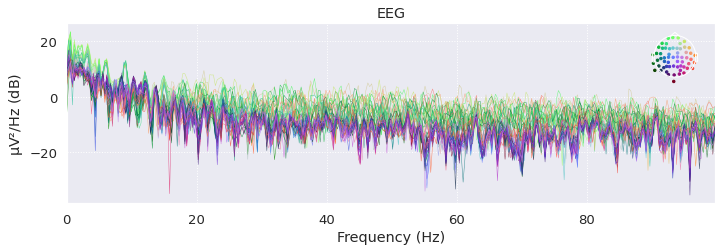

In [ ]:
reconst_raw = simulated_blink.copy()
ica.apply(reconst_raw)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
simulated_blink.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

simulated_blink.plot_psd(fmax=100)

Opening raw-browser...


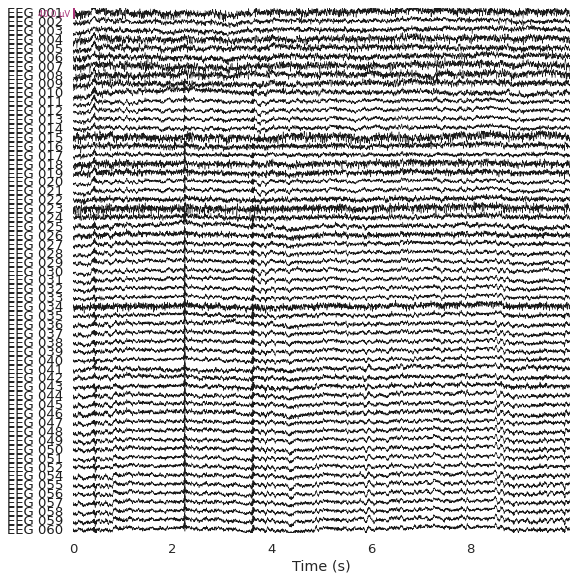

Effective window size : 3.410 (s)


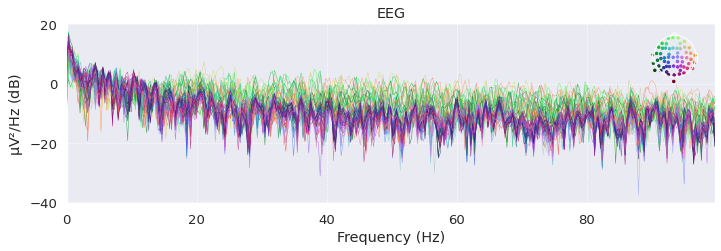

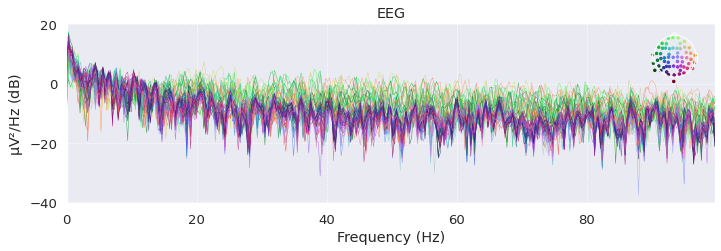

In [ ]:
reconst_raw.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw.plot_psd(fmax=100)

In [ ]:
reconst_artifact_fastica = reconst_raw.copy()

df_reconst_artifact_fastica = convert_raw_to_df(reconst_artifact_fastica)
save_df_to_csv(df_reconst_artifact_fastica, 'reconstructed_artifact_fastica.csv')

df_reconst_artifact_fastica_normalized = normalize_eeg_signal(df_reconst_artifact_fastica)
df_reconst_artifact_fastica_normalized = pd.DataFrame(df_reconst_artifact_fastica_normalized)

save_df_to_csv(df_reconst_artifact_fastica_normalized, 'reconstructed_artifact_fastica_normalized.csv')

Sampling frequency of raw signal: 600.61
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  14.418632  45.981919  39.224958  174.719709  53.193848  18.931539   
1     2  13.175064  46.888340  34.456602  176.969481  60.780542  18.030274   
2     3   8.657587  44.903201  33.718877  175.415767  66.607908  20.499411   
3     5   4.076780  42.645654  34.847199  174.480387  68.710171  26.641442   
4     7  -0.104855  41.710587  36.634635  169.443562  65.961576  28.877029   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  30.009605  43.426818 -16.403580  44.780249  35.610056  70.047324   
1  21.251845  45.647919 -19.140559  42.194106  35.588947  71.967906   
2  20.185252  47.819879 -10.295924  41.014449  32.638054  69.332739   
3  24.055821  51.463290  -1.985120  44.609050  31.482861  66.474884   
4  29.218117  51.052889  -5.229862  48.921166  32.662080  65.792187   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 017    EEG

In [ ]:
df_reconst_artifact_fastica_normalized = df_reconst_artifact_fastica_normalized.drop(['time'], axis=1)

In [ ]:
signal_original = df_eeg_signal_raw_normalized.to_numpy()
signal_denoised_artifact_fastica = df_reconst_artifact_fastica_normalized.to_numpy()
signal_with_artifact = df_eeg_blink_normalized.to_numpy()

print("SNR before denosing:", calculate_snr(signal_original, signal_with_artifact).mean())
print("SNR after denosing:", calculate_snr(signal_original, signal_denoised_artifact_fastica).mean())

print("RMSE:", calculate_rmse(signal_original, signal_denoised_artifact_fastica))
print("PSNR:", calculate_psnr(signal_original, signal_denoised_artifact_fastica))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_denoised_artifact_fastica[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_denoised_artifact_fastica[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_denoised_artifact_fastica[:, 57]))

corr_original_fastica = get_correlations_channels(signal_original, signal_denoised_artifact_fastica)
print("Mean", mean(corr_original_fastica))

print("\n Results for signal with added artifact:")
print("RMSE:", calculate_rmse(signal_original, signal_with_artifact))
print("PSNR:", calculate_psnr(signal_original, signal_with_artifact))

SNR before denosing: 22.070466939264875
SNR after denosing: 25.689236061313277
RMSE: 0.028050686128167822
PSNR: 27.598858013225446
CORRELATION EEG 012 0.9521482129857697
CORRELATION EEG 030 0.9909387803110151
CORRELATION EEG 058 0.9981810579978135
CORRELATION EEG 01 0.9787140290257311
CORRELATION EEG 02 0.9775188512452617
CORRELATION EEG 03 0.981006080466143
CORRELATION EEG 04 0.9618173079915515
CORRELATION EEG 05 0.9587400880528257
CORRELATION EEG 06 0.9733770293524868
CORRELATION EEG 07 0.9818404036183789
CORRELATION EEG 08 0.9501792198591533
CORRELATION EEG 09 0.9441143756694751
CORRELATION EEG 010 0.9553196800562642
CORRELATION EEG 011 0.9477468464644498
CORRELATION EEG 012 0.9521482129857697
CORRELATION EEG 013 0.9527795858824762
CORRELATION EEG 014 0.9525795783821492
CORRELATION EEG 015 0.9745220699376286
CORRELATION EEG 016 0.9520889520131187
CORRELATION EEG 017 0.9899027229659467
CORRELATION EEG 018 0.9930056156343146
CORRELATION EEG 019 0.9938552067171544
CORRELATION EEG 020 0

In [ ]:
print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_with_artifact[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_with_artifact[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_with_artifact[:, 57]))

corr_original_artifact = get_correlations_channels(signal_original, signal_with_artifact)
mean(corr_original_artifact)

CORRELATION EEG 012 0.835888639172592
CORRELATION EEG 030 0.9700649937844992
CORRELATION EEG 058 0.999303797599913
CORRELATION EEG 01 0.9168234040099754
CORRELATION EEG 02 0.9134471014701848
CORRELATION EEG 03 0.9249481946594912
CORRELATION EEG 04 0.8697314479909416
CORRELATION EEG 05 0.8661752413400996
CORRELATION EEG 06 0.8979820065199239
CORRELATION EEG 07 0.9280872411012833
CORRELATION EEG 08 0.8359250124753017
CORRELATION EEG 09 0.8193457522593556
CORRELATION EEG 010 0.8710484651021339
CORRELATION EEG 011 0.8276694831174901
CORRELATION EEG 012 0.835888639172592
CORRELATION EEG 013 0.8370521382676858
CORRELATION EEG 014 0.8343054264056966
CORRELATION EEG 015 0.9044848269757513
CORRELATION EEG 016 0.8371186662366201
CORRELATION EEG 017 0.958662003251642
CORRELATION EEG 018 0.9738542620401719
CORRELATION EEG 019 0.9743199923038316
CORRELATION EEG 020 0.9727931305219112
CORRELATION EEG 021 0.9769258147073419
CORRELATION EEG 022 0.9768138917793862
CORRELATION EEG 023 0.9790047173911999

0.929056244925434

### Infomax (MNE) - sygnał z wprowadzonym artefaktem

<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


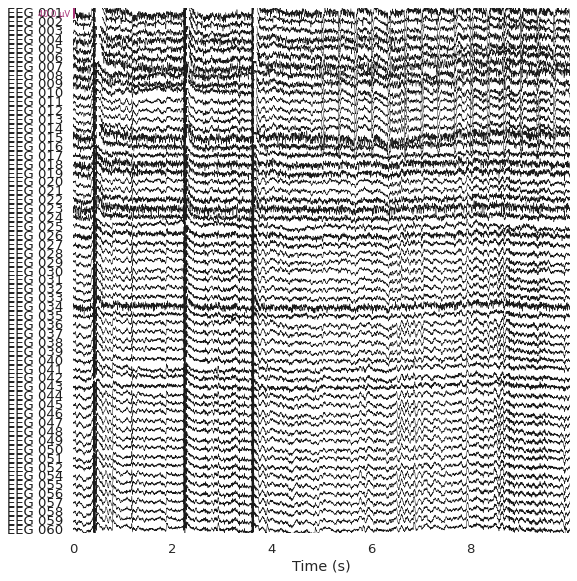

Effective window size : 3.410 (s)


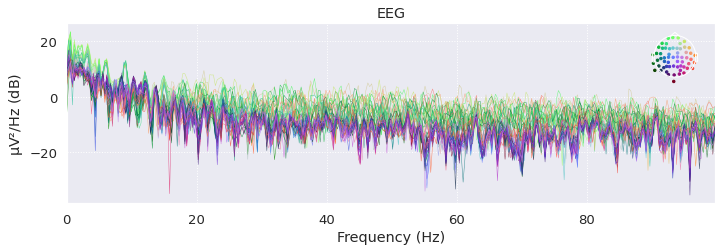

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by number: 14 components
 


<ipython-input-103-24ebca4f7720>:7: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica_artifact_infomax.fit(simulated_blink)


Fitting ICA took 8.6s.


Method,infomax
Fit,500 iterations on raw data (6006 samples)
ICA components,14
Explained variance,96.4 %
Available PCA components,59
Channel types,eeg
ICA components marked for exclusion,—


In [ ]:
eeg_values_blink = np.array(list(eeg_signal_blink.values())) / 1000000

simulated_blink = create_mne_object(eeg_signal_values=eeg_values_blink, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

# method - infomax
ica_artifact_infomax = mne.preprocessing.ICA(n_components=14, random_state=97, method='infomax')
ica_artifact_infomax.fit(simulated_blink)

Creating RawArray with float64 data, n_channels=14, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


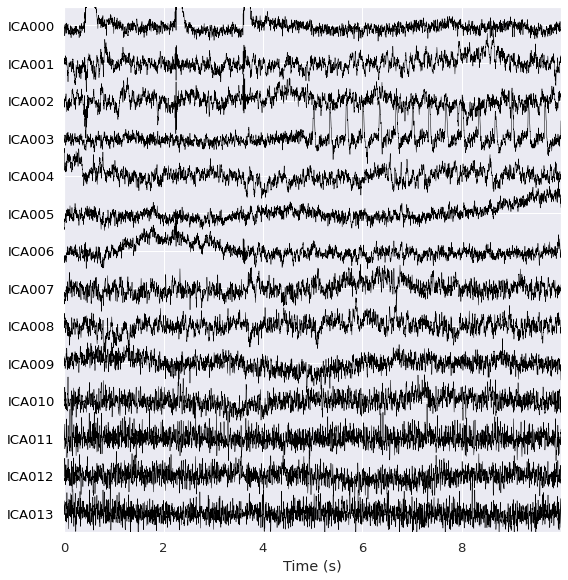

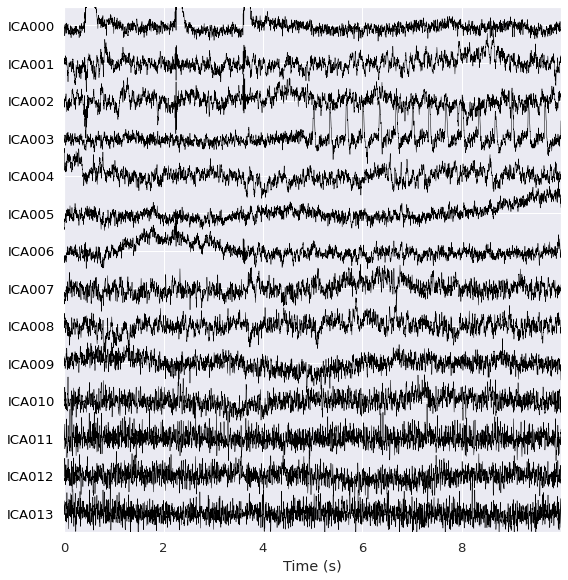

In [ ]:
ica_artifact_infomax.plot_sources(simulated_blink, show_scrollbars=False)

In [ ]:
ica_artifact_infomax.exclude.extend([3])

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 59 PCA components
Opening raw-browser...


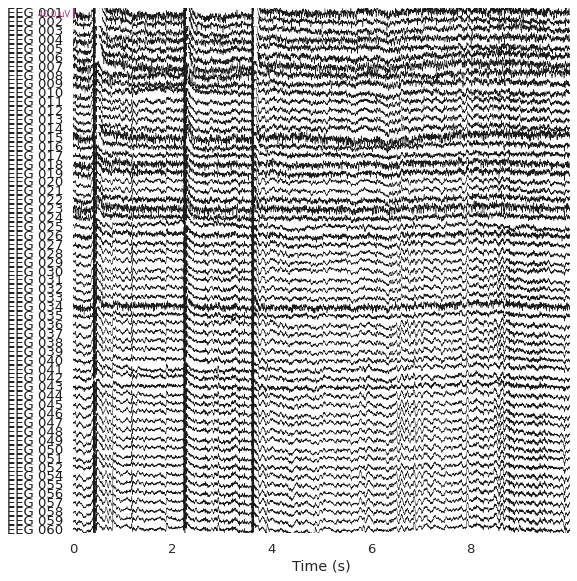

Effective window size : 3.410 (s)


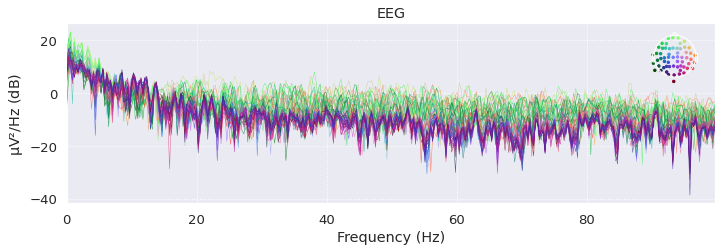

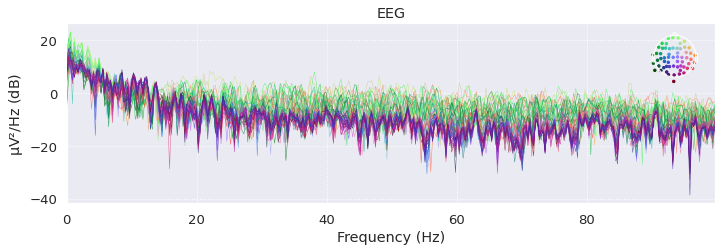

In [ ]:
reconst_raw_artifact_infomax = simulated_blink.copy()
ica_artifact_infomax.apply(reconst_raw_artifact_infomax)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
reconst_raw_artifact_infomax.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw_artifact_infomax.plot_psd(fmax=100)

In [ ]:
reconst_artifact_infomax = reconst_raw_artifact_infomax.copy()

df_reconst_artifact_infomax = convert_raw_to_df(reconst_artifact_infomax)
save_df_to_csv(df_reconst_artifact_infomax, 'reconstructed_artifact_infomax.csv')

df_reconst_artifact_infomax_normalized = normalize_eeg_signal(df_reconst_artifact_infomax)
df_reconst_artifact_infomax_normalized = pd.DataFrame(df_reconst_artifact_infomax_normalized)

save_df_to_csv(df_reconst_artifact_infomax_normalized, 'reconstructed_artifact_infomax_normalized.csv')

Sampling frequency of raw signal: 600.61
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  13.597263  45.250727  38.503047  173.950532  52.513634  18.279933   
1     2  12.304352  46.120386  33.696080  176.162973  60.075752  17.349392   
2     3   8.327733  44.595849  33.419856  175.089881  66.303560  20.218842   
3     5   4.043807  42.508220  34.746433  174.315581  68.437115  26.466397   
4     7  -0.686330  41.023751  36.011189  168.689371  65.095309  28.182653   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  29.220286  42.773700 -17.114295  44.127319  34.998904  69.425841   
1  20.417515  44.969907 -19.883048  41.524005  34.957717  71.323650   
2  19.863663  47.530139 -10.602246  40.710020  32.360773  69.055280   
3  23.987833  51.220688  -2.178421  44.250092  31.207316  66.230218   
4  28.602501  50.251776  -5.990949  47.938019  31.836465  65.008250   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 017    EEG

In [ ]:
df_reconst_artifact_infomax_normalized = df_reconst_artifact_infomax_normalized.drop(['time'], axis=1)

In [ ]:
signal_original = df_eeg_signal_raw_normalized.to_numpy()
signal_denoised_artifact_infomax = df_reconst_artifact_infomax_normalized.to_numpy()
signal_with_artifact = df_eeg_blink_normalized.to_numpy()

print("SNR before denosing:", calculate_snr(signal_original, signal_with_artifact).mean())
print("SNR after denosing:", calculate_snr(signal_original, signal_denoised_artifact_infomax).mean())

print("RMSE:", calculate_rmse(signal_original, signal_denoised_artifact_infomax))
print("PSNR:", calculate_psnr(signal_original, signal_denoised_artifact_infomax))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_denoised_artifact_infomax[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_denoised_artifact_infomax[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_denoised_artifact_infomax[:, 57]))

corr_original_infomax = get_correlations_channels(signal_original, signal_denoised_artifact_fastica)
print("Mean", mean(corr_original_infomax))

print("\n Results for signal with added artifact:")
print("RMSE:", calculate_rmse(signal_original, signal_with_artifact))
print("PSNR:", calculate_psnr(signal_original, signal_with_artifact))

SNR before denosing: 22.070466939264875
SNR after denosing: 24.65564961007097
RMSE: 0.029521834159447587
PSNR: 27.492449870155667
CORRELATION EEG 012 0.9496097360171734
CORRELATION EEG 030 0.9904561826440816
CORRELATION EEG 058 0.9961342072088255
CORRELATION EEG 01 0.9787140290257311
CORRELATION EEG 02 0.9775188512452617
CORRELATION EEG 03 0.981006080466143
CORRELATION EEG 04 0.9618173079915515
CORRELATION EEG 05 0.9587400880528257
CORRELATION EEG 06 0.9733770293524868
CORRELATION EEG 07 0.9818404036183789
CORRELATION EEG 08 0.9501792198591533
CORRELATION EEG 09 0.9441143756694751
CORRELATION EEG 010 0.9553196800562642
CORRELATION EEG 011 0.9477468464644498
CORRELATION EEG 012 0.9521482129857697
CORRELATION EEG 013 0.9527795858824762
CORRELATION EEG 014 0.9525795783821492
CORRELATION EEG 015 0.9745220699376286
CORRELATION EEG 016 0.9520889520131187
CORRELATION EEG 017 0.9899027229659467
CORRELATION EEG 018 0.9930056156343146
CORRELATION EEG 019 0.9938552067171544
CORRELATION EEG 020 0.

### Picard (MNE) - sygnał z wprowadzonym artefaktem


<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


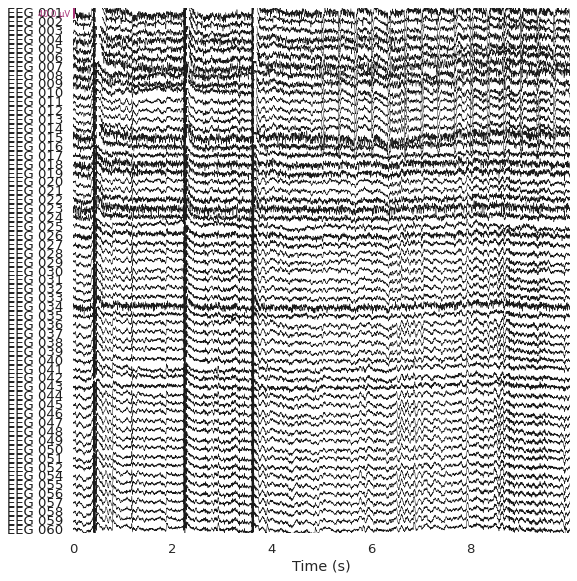

Effective window size : 3.410 (s)


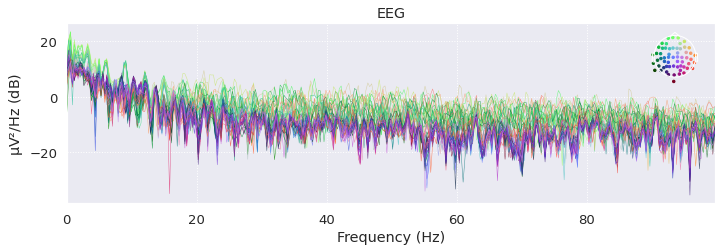

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by number: 14 components


<ipython-input-111-21cffbd6fc2f>:7: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica_artifact_picard.fit(simulated_blink)


Fitting ICA took 1.4s.


Method,picard
Fit,39 iterations on raw data (6006 samples)
ICA components,14
Explained variance,96.4 %
Available PCA components,59
Channel types,eeg
ICA components marked for exclusion,—


In [ ]:
eeg_values_blink = np.array(list(eeg_signal_blink.values())) / 1000000

simulated_blink = create_mne_object(eeg_signal_values=eeg_values_blink, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

# method - picard
ica_artifact_picard = mne.preprocessing.ICA(n_components=14, random_state=97, method='picard')
ica_artifact_picard.fit(simulated_blink)

Creating RawArray with float64 data, n_channels=14, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


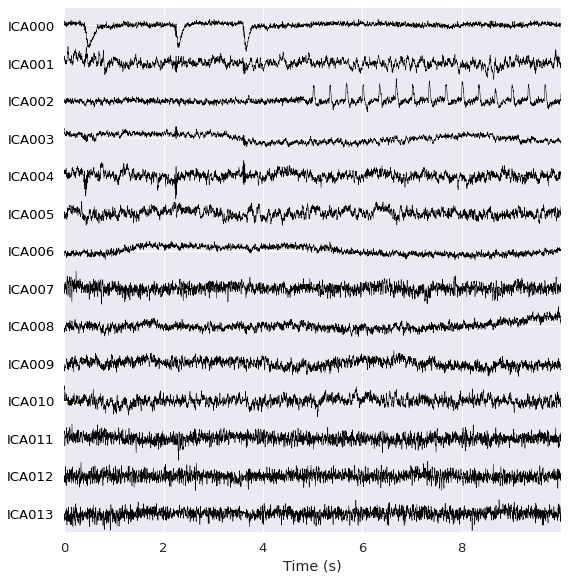

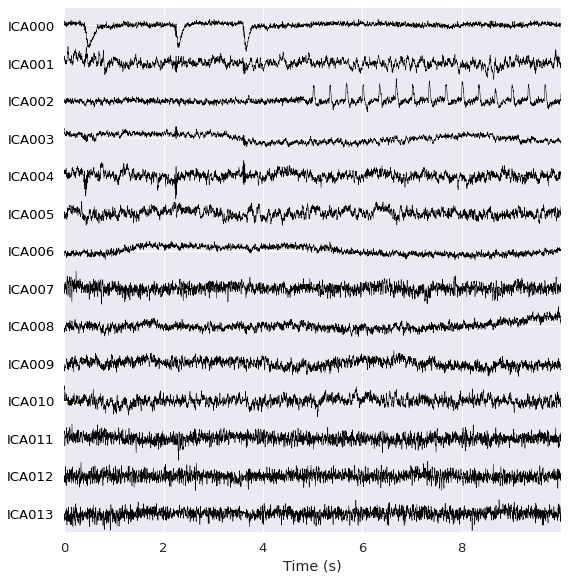

In [ ]:
ica_artifact_picard.plot_sources(simulated_blink, show_scrollbars=False)

In [ ]:
ica_artifact_picard.exclude.extend([2])

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 59 PCA components
Opening raw-browser...


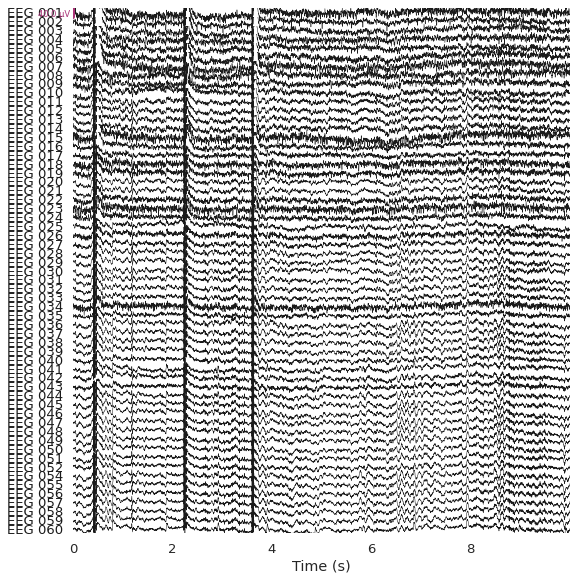

Effective window size : 3.410 (s)


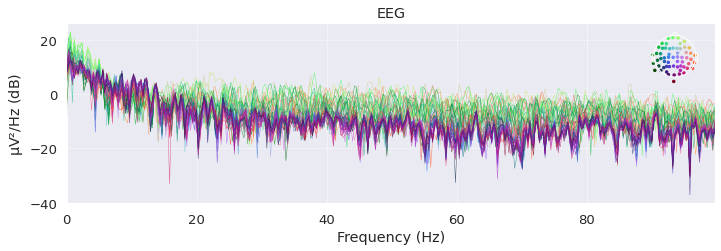

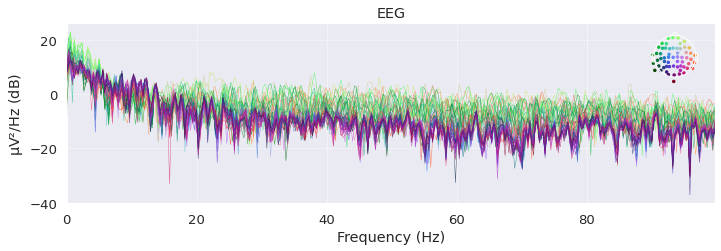

In [ ]:
reconst_raw_artifact_picard = simulated_blink.copy()
ica_artifact_picard.apply(reconst_raw_artifact_picard)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
reconst_raw_artifact_picard.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw_artifact_picard.plot_psd(fmax=100)

In [ ]:
reconst_artifact_picard = reconst_raw_artifact_picard.copy()

df_reconst_artifact_picard = convert_raw_to_df(reconst_artifact_picard)
save_df_to_csv(df_reconst_artifact_picard, 'reconstructed_artifact_picard.csv')

df_reconst_artifact_picard_normalized = normalize_eeg_signal(df_reconst_artifact_picard)
df_reconst_artifact_picard_normalized = pd.DataFrame(df_reconst_artifact_picard_normalized)

save_df_to_csv(df_reconst_artifact_picard_normalized, 'reconstructed_artifact_picard_normalized.csv')

Sampling frequency of raw signal: 600.61
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  13.837715  45.422791  38.729991  174.071582  52.554713  18.467346   
1     2  12.460380  46.192787  33.835603  176.170932  59.986793  17.439901   
2     3   8.033844  44.258264  33.117378  174.713020  65.878426  19.888918   
3     5   3.374883  41.863946  34.082432  173.681002  67.835033  25.813798   
4     7  -1.211358  40.516965  35.489808  168.189312  64.619487  27.669562   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  29.472031  42.820635 -17.013554  44.058036  35.028473  69.505683   
1  20.582343  44.896414 -19.895765  41.302942  34.863909  71.288616   
2  19.560747  47.135682 -10.978597  40.223607  31.958202  68.676072   
3  23.293706  50.651542  -2.788133  43.699805  30.648308  65.641694   
4  28.057735  49.802134  -6.471702  47.501146  31.394525  64.543880   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 017    EEG

In [ ]:
df_reconst_artifact_picard_normalized = df_reconst_artifact_picard_normalized.drop(['time'], axis=1)

In [ ]:
signal_original = df_eeg_signal_raw_normalized.to_numpy()
signal_denoised_artifact_picard = df_reconst_artifact_picard_normalized.to_numpy()
signal_with_artifact = df_eeg_blink_normalized.to_numpy()

print("SNR before denosing:", calculate_snr(signal_original, signal_with_artifact).mean())
print("SNR after denosing:", calculate_snr(signal_original, signal_denoised_artifact_picard).mean())

print("RMSE:", calculate_rmse(signal_original, signal_denoised_artifact_picard))
print("PSNR:", calculate_psnr(signal_original, signal_denoised_artifact_picard))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_denoised_artifact_picard[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_denoised_artifact_picard[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_denoised_artifact_picard[:, 57]))

corr_original_picard = get_correlations_channels(signal_original, signal_denoised_artifact_fastica)
print("Mean", mean(corr_original_picard))

print("\n Results for signal with added artifact:")
print("RMSE:", calculate_rmse(signal_original, signal_with_artifact))
print("PSNR:", calculate_psnr(signal_original, signal_with_artifact))

SNR before denosing: 22.070466939264875
SNR after denosing: 26.079901703050645
RMSE: 0.027569308793595523
PSNR: 27.651931652370727
CORRELATION EEG 012 0.9507347961612777
CORRELATION EEG 030 0.9920382612916591
CORRELATION EEG 058 0.9982243815956743
CORRELATION EEG 01 0.9787140290257311
CORRELATION EEG 02 0.9775188512452617
CORRELATION EEG 03 0.981006080466143
CORRELATION EEG 04 0.9618173079915515
CORRELATION EEG 05 0.9587400880528257
CORRELATION EEG 06 0.9733770293524868
CORRELATION EEG 07 0.9818404036183789
CORRELATION EEG 08 0.9501792198591533
CORRELATION EEG 09 0.9441143756694751
CORRELATION EEG 010 0.9553196800562642
CORRELATION EEG 011 0.9477468464644498
CORRELATION EEG 012 0.9521482129857697
CORRELATION EEG 013 0.9527795858824762
CORRELATION EEG 014 0.9525795783821492
CORRELATION EEG 015 0.9745220699376286
CORRELATION EEG 016 0.9520889520131187
CORRELATION EEG 017 0.9899027229659467
CORRELATION EEG 018 0.9930056156343146
CORRELATION EEG 019 0.9938552067171544
CORRELATION EEG 020 0

### ICA (MNE) - sygnał z wprowadzonym szumem


<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


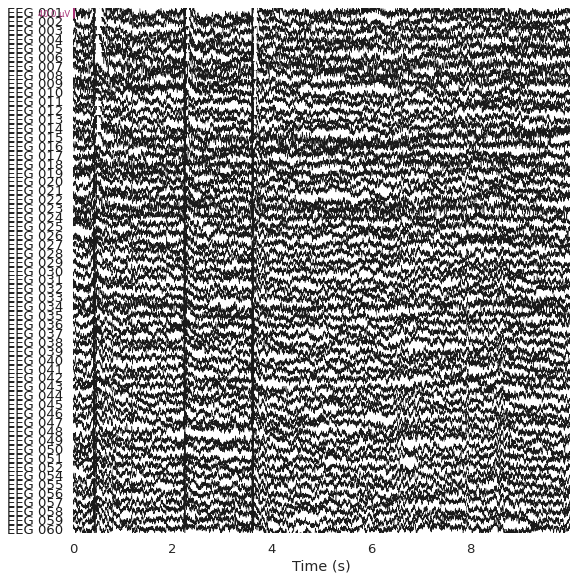

Effective window size : 3.410 (s)


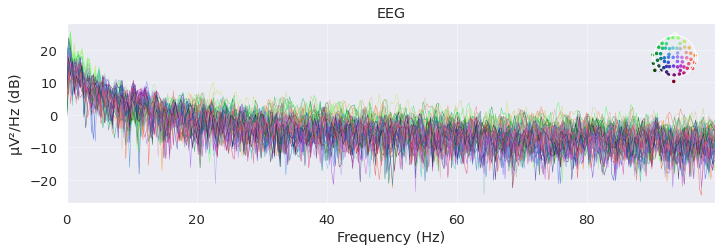

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by non-zero PCA components: 59 components


<ipython-input-160-9a48aa916952>:6: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(simulated_noise)


Fitting ICA took 30.1s.
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


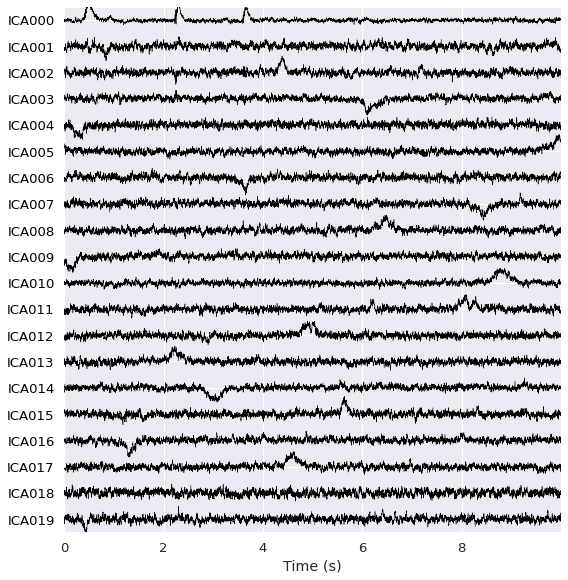

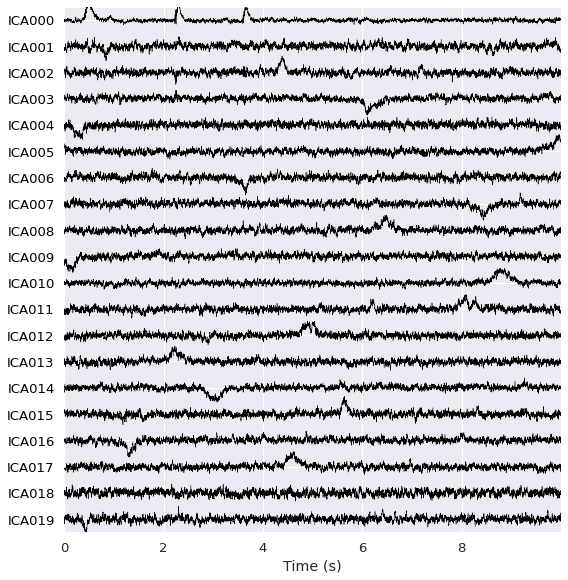

In [ ]:
eeg_values_noise = np.array(list(eeg_signal_noise_dict.values())) / 1000000

simulated_noise = create_mne_object(eeg_signal_values=eeg_values_noise, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

ica = mne.preprocessing.ICA(n_components=None, random_state=97)
ica.fit(simulated_noise)

ica.plot_sources(simulated_noise, show_scrollbars=False)

In [ ]:
ica.exclude.extend([1, 16, 6, 11, 15, 19, 2, 3, 8, 12, 10, 4, 9, 0])

In [ ]:
reconst_raw = simulated_blink.copy()
ica.apply(reconst_raw)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
simulated_noise.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

simulated_noise.plot_psd(fmax=100)

In [ ]:
reconst_raw.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw.plot_psd(fmax=100)

### FastICA (MNE) - sygnał z wprowadzonym szumem i artefaktem


<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


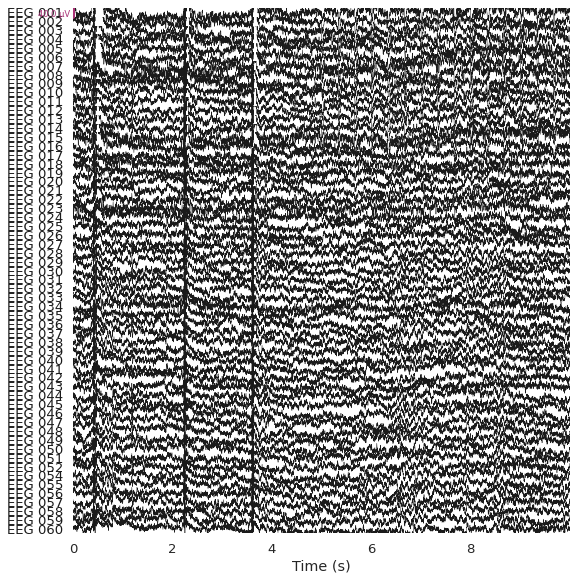

Effective window size : 3.410 (s)


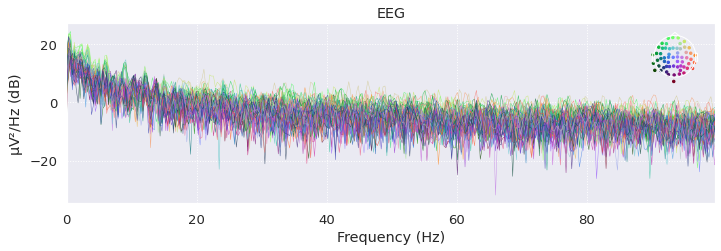

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by number: 14 components


<ipython-input-168-a19b422b357b>:8: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(simulated_artifact_noise)


Fitting ICA took 18.0s.
Creating RawArray with float64 data, n_channels=14, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


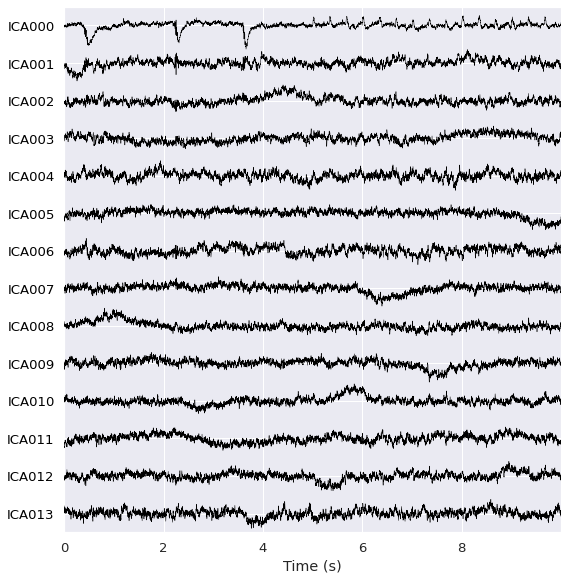

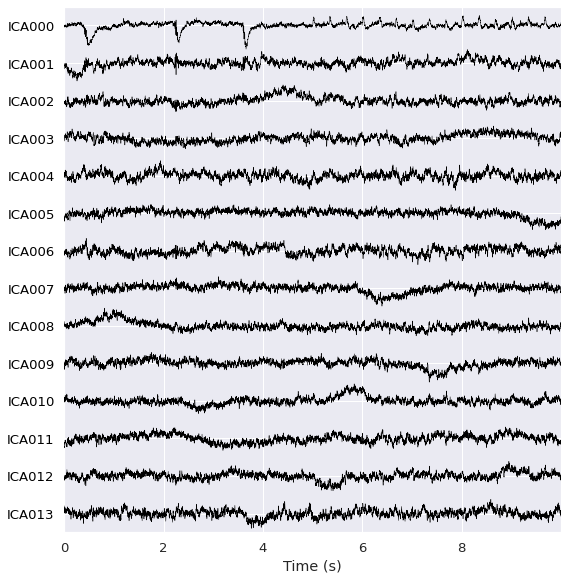

In [ ]:
# eeg_signal_artifact_noise_dict

eeg_values_artifact_noise = np.array(list(eeg_signal_artifact_noise_dict.values())) / 1000000

simulated_artifact_noise = create_mne_object(eeg_signal_values=eeg_values_artifact_noise, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

ica = mne.preprocessing.ICA(n_components=14, random_state=97)
ica.fit(simulated_artifact_noise)

ica.plot_sources(simulated_artifact_noise, show_scrollbars=False)

In [ ]:
ica.exclude.extend([0])

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 59 PCA components
Opening raw-browser...


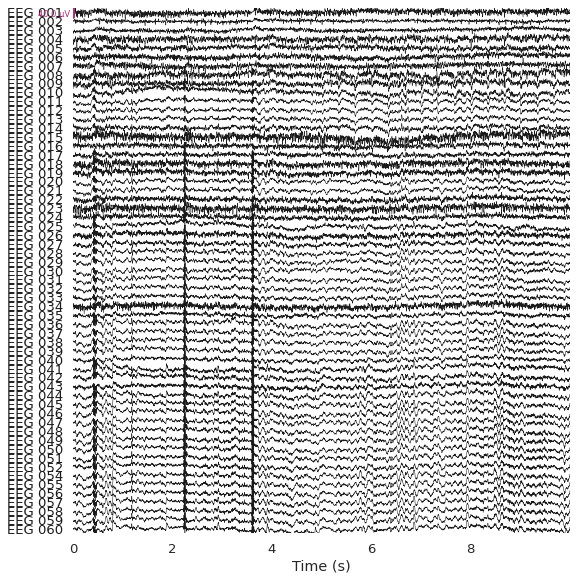

Effective window size : 3.410 (s)


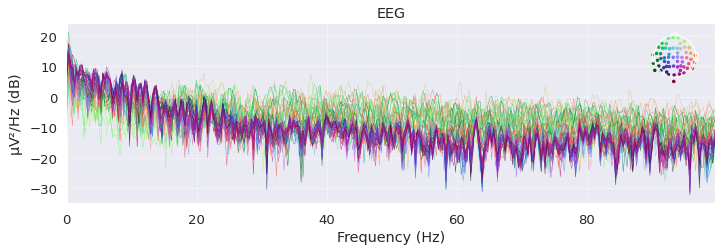

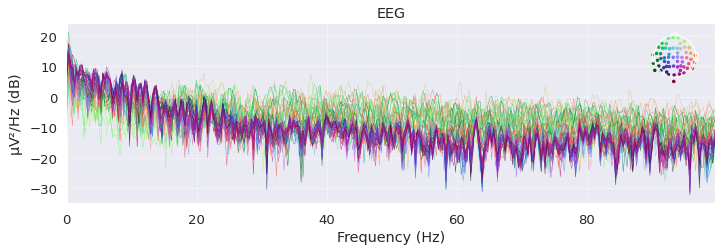

In [ ]:
reconst_raw = simulated_artifact_noise.copy()
ica.apply(reconst_raw)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
reconst_raw.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw.plot_psd(fmax=100)

In [ ]:
reconst_artifacts_noise_fastica = reconst_raw.copy()

In [ ]:
df_reconst_artifacts_noise_fastica = convert_raw_to_df(reconst_artifacts_noise_fastica)
save_df_to_csv(df_reconst_artifacts_noise_fastica, 'reconstructed_artifacts_noise_fastica.csv')

Sampling frequency of raw signal: 600.61
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  11.796796  43.254525  36.701926  171.606812  49.946520  16.238656   
1     2  11.928137  45.651210  33.498874  174.755531  58.510710  16.495176   
2     3   7.413661  43.594677  32.463225  174.116327  65.242738  19.283326   
3     5   3.506757  41.976342  33.990489  174.736823  68.927133  26.379630   
4     7   0.406111  42.235841  37.100979  170.127047  66.670416  29.428482   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  27.368896  40.277545 -19.512269  41.178676  32.510907  67.076720   
1  20.068106  42.955887 -21.668365  39.212266  33.140373  69.789111   
2  18.914911  46.614668 -11.516945  39.612718  31.403486  68.108677   
3  23.389879  52.298083  -1.325896  45.440545  32.049123  66.803630   
4  29.725203  51.791720  -4.514118  49.755968  33.368141  66.451345   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 017    EEG

In [ ]:
df_reconst_artifacts_noise_fastica = convert_raw_to_df(reconst_artifacts_noise_fastica)
save_df_to_csv(df_reconst_artifacts_noise_fastica, 'reconstructed_artifacts_noise_fastica.csv')

In [ ]:
df_reconst_artifacts_noise_fastica_normalized = normalize_eeg_signal(df_reconst_artifacts_noise_fastica)
df_reconst_artifacts_noise_fastica_normalized = pd.DataFrame(df_reconst_artifacts_noise_fastica_normalized)

save_df_to_csv(df_reconst_artifacts_noise_fastica_normalized, 'reconstructed_artifacts_noise_fastica_normalized.csv')

In [ ]:
df_reconst_artifacts_noise_fastica_normalized = df_reconst_artifacts_noise_fastica_normalized.drop(['time'], axis=1)

KeyError: ignored

In [ ]:
metrics_summary(method='FastICA',
                signal_type='Reconstructed EEG',
                artifact='blink',
                noise='pink',
                signal_original=df_reconst_artifacts_noise_fastica_normalized.to_numpy(),
                signal_denoised=df_eeg_signal_raw_normalized.to_numpy(),
                with_noise=False)

,method,signal type,artifacts,noise,SNR - original signal,SNR - signal modified (with added noise or reconstructed),SNR - first channel[dB],SNR - second channel[dB],SNR - third channel[dB],RMSE,PSNR,correlation - first channel,correlation - second channel,correlation - third channel
0,FastICA,Reconstructed EEG,blink,pink,10.590152,7.835282,4.776841,4.569904,4.544513,0.137696,15.663587,0.535353,0.383383,0.510584


In [ ]:
signal_original = df_eeg_signal_raw_normalized.to_numpy()
signal_denoised = df_reconst_artifacts_noise_fastica_normalized.to_numpy()
signal_with_artifact_noise = df_eeg_signal_noise_artifact.to_numpy()

print("SNR before denosing:", calculate_snr(signal_original, signal_with_artifact_noise).mean())
print("SNR after denosing:", calculate_snr(signal_original, signal_denoised).mean())

print("RMSE:", calculate_rmse(signal_original, signal_denoised))
print("PSNR:", calculate_psnr(signal_original, signal_denoised))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_denoised[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_denoised[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_denoised[:, 57]))

SNR before denosing: -43.66087395837577
SNR after denosing: 10.271142175252189
RMSE: 0.13769643614449598
PSNR: 15.663586553313941
CORRELATION EEG 012 0.4707370119687826
CORRELATION EEG 030 0.7438764457120287
CORRELATION EEG 058 0.8673909718834334


In [ ]:
signal_with_artifact_noise = df_eeg_artifact_noise_normalized.to_numpy()

print("RMSE:", calculate_rmse(signal_original, signal_with_artifact_noise))
print("PSNR:", calculate_psnr(signal_original, signal_with_artifact_noise))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_with_artifact_noise[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_with_artifact_noise[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_with_artifact_noise[:, 57]))

corr_original_artifactnoise = get_correlations_channels(signal_original, signal_with_artifact_noise)
mean(corr_original_artifactnoise)

RMSE: 0.12455380552257671
PSNR: 17.815645227095402
CORRELATION EEG 012 0.7165457104941162
CORRELATION EEG 030 0.729732681045209
CORRELATION EEG 058 0.7842039572171993
CORRELATION EEG 01 0.8430425191568006
CORRELATION EEG 02 0.8266227426105179
CORRELATION EEG 03 0.8563549839189601
CORRELATION EEG 04 0.7709797806465223
CORRELATION EEG 05 0.7878046012166894
CORRELATION EEG 06 0.8372574636737294
CORRELATION EEG 07 0.8473929272871081
CORRELATION EEG 08 0.7177686391989333
CORRELATION EEG 09 0.595928334554101
CORRELATION EEG 010 0.7737034296569466
CORRELATION EEG 011 0.7184318582830996
CORRELATION EEG 012 0.7165457104941162
CORRELATION EEG 013 0.7387238044574755
CORRELATION EEG 014 0.7273976950920782
CORRELATION EEG 015 0.7907799000171802
CORRELATION EEG 016 0.7068776149322892
CORRELATION EEG 017 0.6616564942862567
CORRELATION EEG 018 0.7014383070864251
CORRELATION EEG 019 0.7132078491122411
CORRELATION EEG 020 0.7747989320346125
CORRELATION EEG 021 0.7724257579359571
CORRELATION EEG 022 0.78

0.7264342322349625

In [ ]:
correlations_fast_ica = get_correlations_channels(signal_original, signal_denoised)

CORRELATION EEG 01 0.5353527609364034
CORRELATION EEG 02 0.38338297237056973
CORRELATION EEG 03 0.51058371608317
CORRELATION EEG 04 0.5352923958398597
CORRELATION EEG 05 0.41979757331500167
CORRELATION EEG 06 0.5607714359252157
CORRELATION EEG 07 0.6296603644892772
CORRELATION EEG 08 0.704485835508065
CORRELATION EEG 09 0.5723045376406845
CORRELATION EEG 010 0.7031057916065242
CORRELATION EEG 011 0.555604365328205
CORRELATION EEG 012 0.4707370119687826
CORRELATION EEG 013 0.3920775236516206
CORRELATION EEG 014 0.4649474181146791
CORRELATION EEG 015 0.7891779897092481
CORRELATION EEG 016 0.4157621708132075
CORRELATION EEG 017 0.7557358001457006
CORRELATION EEG 018 0.905041485934382
CORRELATION EEG 019 0.8785255817960484
CORRELATION EEG 020 0.79963360203189
CORRELATION EEG 021 0.8094598352335756
CORRELATION EEG 022 0.7714728707573797
CORRELATION EEG 023 0.9021442706220553
CORRELATION EEG 024 0.8182793759242943
CORRELATION EEG 025 0.9045111475332918
CORRELATION EEG 026 0.8662716040398635


In [ ]:
mean(correlations_fast_ica)

0.7580348523769049

### Infomax (MNE) - sygnał z wprowadzonym szumem i artefaktem


<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


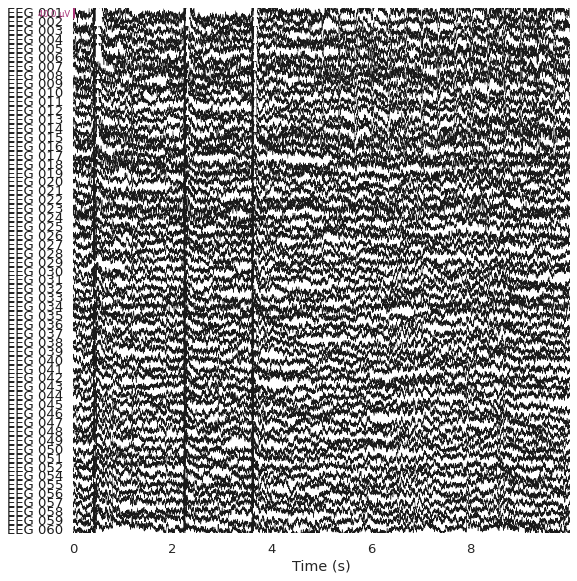

Effective window size : 3.410 (s)


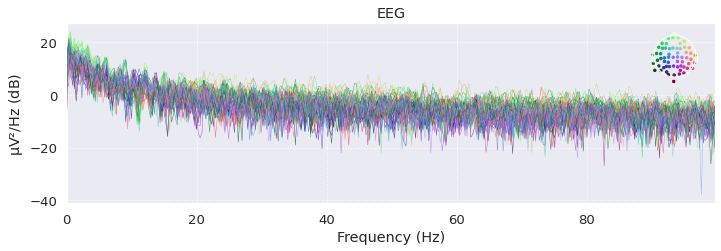

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by non-zero PCA components: 59 components
 


<ipython-input-126-587c86c0f109>:9: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica_infomax.fit(simulated_artifact_noise)


Fitting ICA took 2.2s.
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


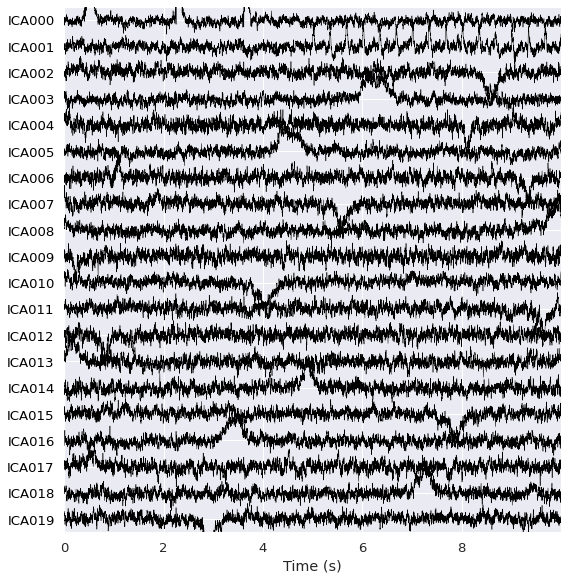

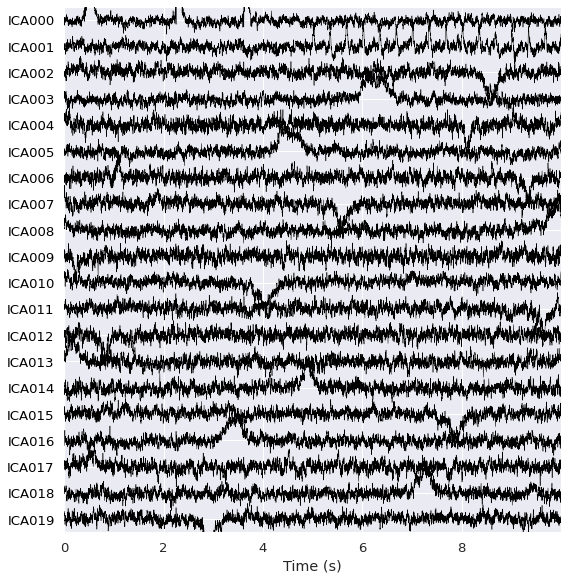

In [ ]:
# eeg_signal_artifact_noise_dict

eeg_values_artifact_noise = np.array(list(eeg_signal_artifact_noise_dict.values())) / 1000000

simulated_artifact_noise = create_mne_object(eeg_signal_values=eeg_values_artifact_noise, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

# infomax
ica_infomax = mne.preprocessing.ICA(n_components=None, random_state=97, method='infomax')
ica_infomax.fit(simulated_artifact_noise)

ica_infomax.plot_sources(simulated_artifact_noise, show_scrollbars=False)

In [ ]:
ica_infomax.exclude.extend([0, 1, 5, 19])

Applying ICA to Raw instance
    Transforming to ICA space (59 components)
    Zeroing out 4 ICA components
    Projecting back using 59 PCA components
Opening raw-browser...


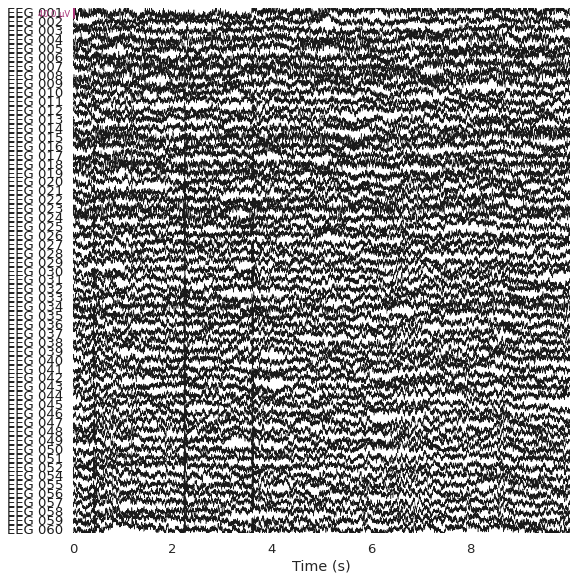

Effective window size : 3.410 (s)


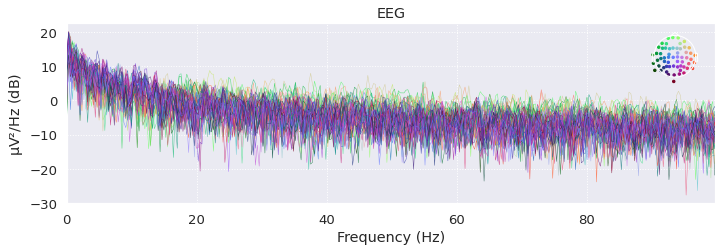

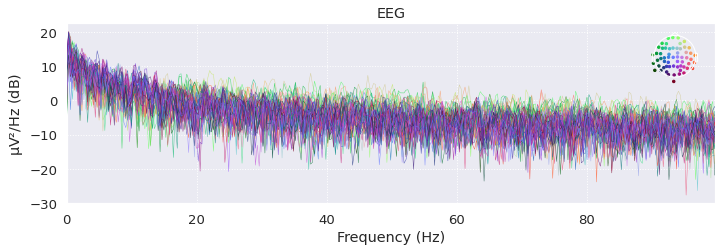

In [ ]:
reconst_raw_infomax = simulated_artifact_noise.copy()
ica_infomax.apply(reconst_raw_infomax)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
reconst_raw_infomax.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw_infomax.plot_psd(fmax=100)

In [ ]:
reconst_artifacts_noise_infomax = reconst_raw_infomax.copy()

df_reconst_artifacts_noise_infomax = convert_raw_to_df(reconst_artifacts_noise_infomax)
save_df_to_csv(df_reconst_artifacts_noise_infomax, 'reconstructed_artifacts_noise_infomax.csv')

df_reconst_artifacts_noise_infomax_normalized = normalize_eeg_signal(df_reconst_artifacts_noise_infomax)
df_reconst_artifacts_noise_infomax_normalized = pd.DataFrame(df_reconst_artifacts_noise_infomax_normalized)

save_df_to_csv(df_reconst_artifacts_noise_infomax_normalized, 'reconstructed_artifacts_noise_infomax_normalized.csv')

Sampling frequency of raw signal: 600.61
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  28.041610  39.246924  43.978682  169.125228  59.448972  15.456671   
1     2  44.294051  54.834414  47.851205  190.752609  75.292448  29.037698   
2     3  35.639534  50.673357  45.115737  184.621982  79.884451  19.776656   
3     5  23.645208  53.082097  52.737720  185.857070  86.627785  24.274318   
4     7  32.003623  55.919718  53.562608  182.557315  81.791835  28.146279   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  11.135091  48.774368  -9.601643  48.161446  52.607154  67.131470   
1  24.860692  59.483814  -7.673404  50.562959  50.933951  67.476939   
2  24.511819  49.925686  -0.776308  41.251576  45.375350  60.056789   
3  38.240354  52.753555   8.508259  44.824462  46.230164  70.417149   
4  46.210903  61.687903  14.804497  57.987522  40.689299  79.789258   

     EEG 013    EEG 014    EEG 015    EEG 016    EEG 017    EEG

In [ ]:
df_reconst_artifacts_noise_infomax_normalized = df_reconst_artifacts_noise_infomax_normalized.drop(['time'], axis=1)

KeyError: ignored

In [ ]:
signal_original = df_eeg_signal_raw_normalized.to_numpy()
signal_denoised = df_reconst_artifacts_noise_infomax_normalized.to_numpy()
signal_with_artifact_noise = df_eeg_signal_noise_artifact.to_numpy()

print("SNR before denosing:", calculate_snr(signal_original, signal_with_artifact_noise).mean())
print("SNR after denosing:", calculate_snr(signal_original, signal_denoised).mean())

print("RMSE:", calculate_rmse(signal_original, signal_denoised))
print("PSNR:", calculate_psnr(signal_original, signal_denoised))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_denoised[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_denoised[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_denoised[:, 57]))

#print("RMSE:", calculate_rmse(signal_original, signal_with_artifact_noise))
#print("PSNR:", calculate_psnr(signal_original, signal_with_artifact_noise))

corr_original_infomax = get_correlations_channels(signal_original, signal_denoised)
mean(corr_original_infomax)

SNR before denosing: -43.66087395837577
SNR after denosing: 4.98119189005932
RMSE: 0.21224946744201512
PSNR: 13.272417864619076
CORRELATION EEG 012 0.19885676877187797
CORRELATION EEG 030 0.266045748355185
CORRELATION EEG 058 0.40118590957747213
CORRELATION EEG 01 0.29216571929379154
CORRELATION EEG 02 0.18530417489096424
CORRELATION EEG 03 0.2948521678080554
CORRELATION EEG 04 0.3381967542772735
CORRELATION EEG 05 0.29437163680271966
CORRELATION EEG 06 0.3619478046021235
CORRELATION EEG 07 0.3684322871974119
CORRELATION EEG 08 0.4146003987049503
CORRELATION EEG 09 0.27983861230566354
CORRELATION EEG 010 0.3948081487705347
CORRELATION EEG 011 0.27837484364103204
CORRELATION EEG 012 0.19885676877187797
CORRELATION EEG 013 0.3096583440833224
CORRELATION EEG 014 0.36634170065328453
CORRELATION EEG 015 0.5190832959906573
CORRELATION EEG 016 0.3151409171825582
CORRELATION EEG 017 0.30481411750923215
CORRELATION EEG 018 0.3610428684282895
CORRELATION EEG 019 0.30103419010207483
CORRELATION E

0.3317042441518533

### Picard (MNE) - sygnał z wprowadzonym szumem i artefaktem


<Info | 9 non-empty values
 bads: []
 ch_names: EEG 001, EEG 002, EEG 003, EEG 004, EEG 005, EEG 006, EEG 007, ...
 chs: 59 EEG
 custom_ref_applied: False
 description: Raw
 dig: 144 items (3 Cardinal, 4 HPI, 59 EEG, 78 Extra)
 highpass: 0.0 Hz
 lowpass: 300.3 Hz
 meas_date: unspecified
 nchan: 59
 projs: []
 sfreq: 600.6 Hz
>
Creating RawArray with float64 data, n_channels=59, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening raw-browser...


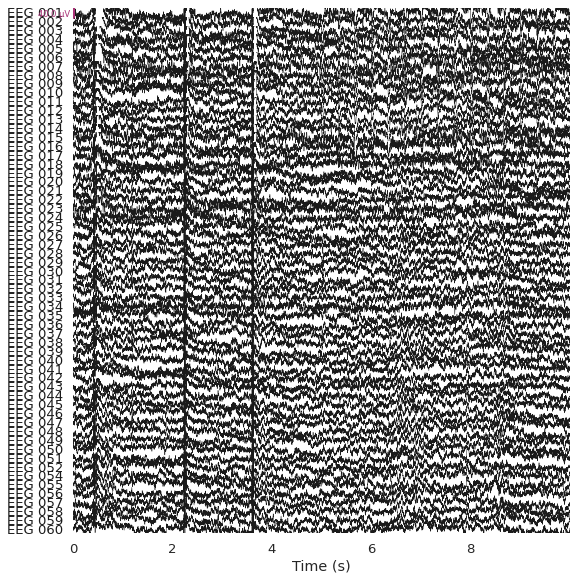

Effective window size : 3.410 (s)


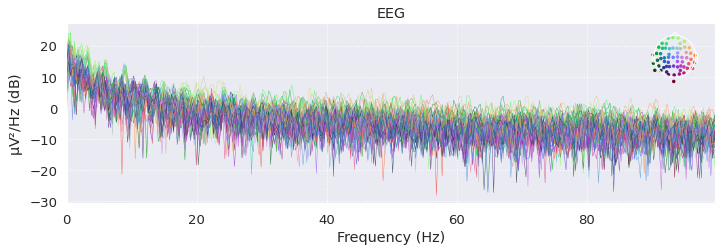

Fitting ICA to data using 59 channels (please be patient, this may take a while)
Selecting by number: 14 components


<ipython-input-292-4e91063d0ef4>:9: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica_picard.fit(simulated_artifact_noise)


Fitting ICA took 1.1s.
Creating RawArray with float64 data, n_channels=14, n_times=6006
    Range : 0 ... 6005 =      0.000 ...     9.998 secs
Ready.
Opening ica-browser...


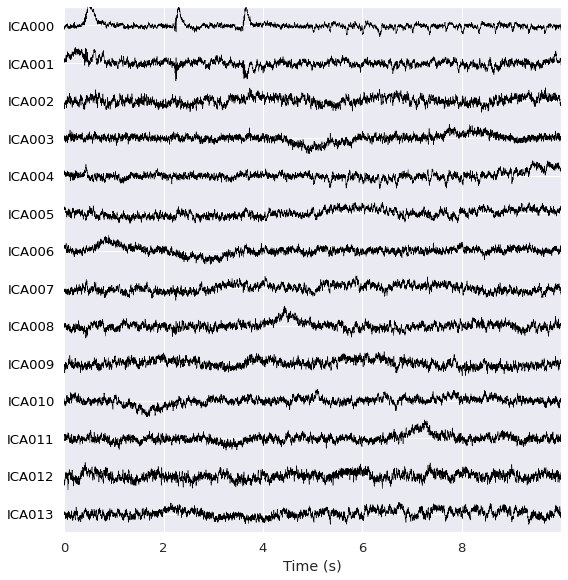

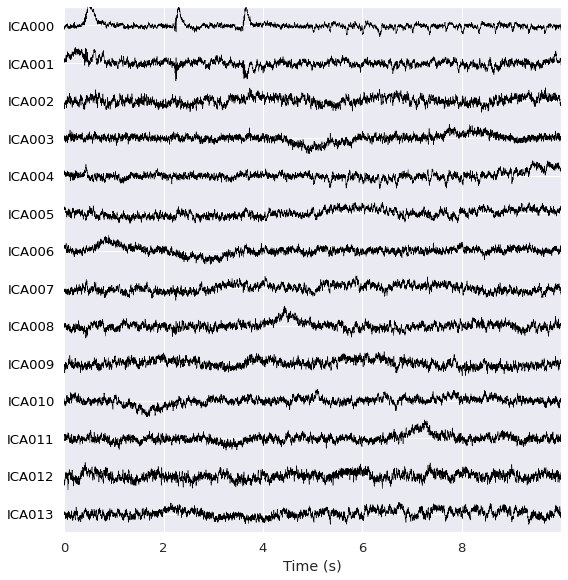

In [ ]:
# eeg_signal_artifact_noise_dict

eeg_values_artifact_noise = np.array(list(eeg_signal_artifact_noise_dict.values())) / 1000000

simulated_artifact_noise = create_mne_object(eeg_signal_values=eeg_values_artifact_noise, fs=fs_audvis, ch_names=eeg_channels, dataset_description='Raw', channels=59)

# picard
ica_picard = mne.preprocessing.ICA(n_components=14, random_state=97, method='picard')
ica_picard.fit(simulated_artifact_noise)

ica_picard.plot_sources(simulated_artifact_noise, show_scrollbars=False)

In [ ]:
ica_picard.exclude.extend([0])

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 59 PCA components
Opening raw-browser...


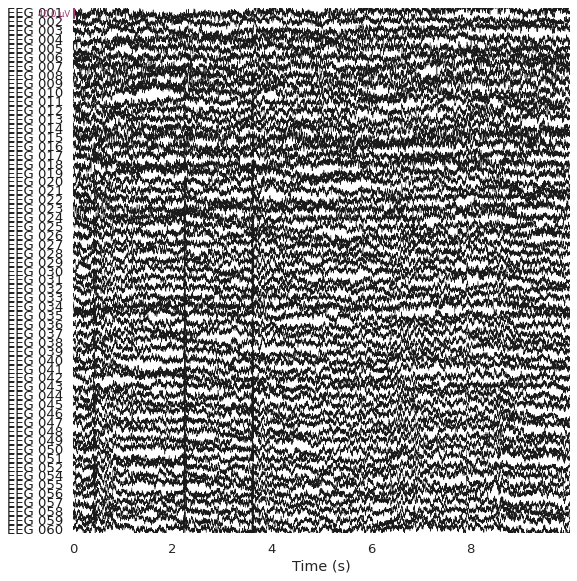

Effective window size : 3.410 (s)


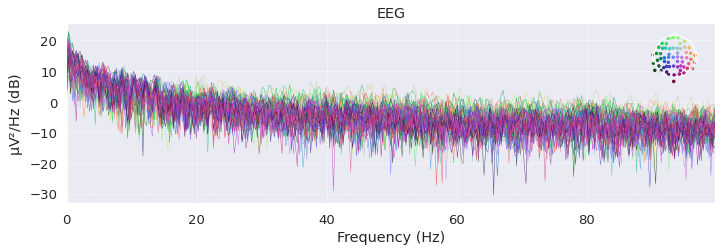

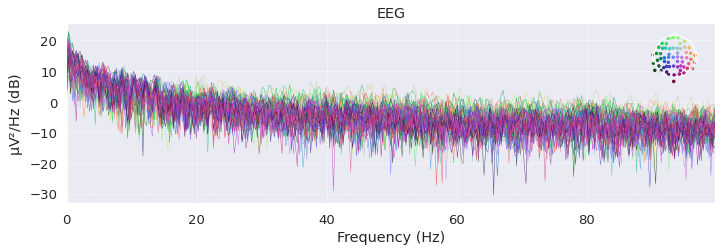

In [ ]:
reconst_raw_picard = simulated_artifact_noise.copy()
ica_picard.apply(reconst_raw_picard)

regexp = r'(EEG)'
artifact_picks = mne.pick_channels_regexp(simulated_raw.ch_names, regexp=regexp)
# wyświetlenie zarejestrowanych sygnałów
reconst_raw_picard.plot(order=artifact_picks, start=0, duration=10, n_channels=len(artifact_picks), show_scrollbars=False)

reconst_raw_picard.plot_psd(fmax=100)

In [ ]:
reconst_artifacts_noise_picard = reconst_raw_picard.copy()

df_reconst_artifacts_noise_picard = convert_raw_to_df(reconst_artifacts_noise_picard)
save_df_to_csv(df_reconst_artifacts_noise_picard, 'reconstructed_artifacts_noise_picard.csv')

df_reconst_artifacts_noise_picard_normalized = normalize_eeg_signal(df_reconst_artifacts_noise_picard)
df_reconst_artifacts_noise_picard_normalized = pd.DataFrame(df_reconst_artifacts_noise_picard_normalized)

save_df_to_csv(df_reconst_artifacts_noise_picard_normalized, 'reconstructed_artifacts_noise_picard_normalized.csv')

Sampling frequency of raw signal: 600.61
   time    EEG 001    EEG 002    EEG 003     EEG 004    EEG 005    EEG 006  \
0     0  18.745066  47.515755  56.650502  167.507264  60.909007  24.303947   
1     2  19.709475  46.993900  39.466171  168.410014  69.087756  27.160069   
2     3  18.123368  33.880203  44.224717  168.957309  76.078056  24.235534   
3     5  14.115475  42.603186  47.996836  167.577667  79.017586  26.088443   
4     7  -6.801035  46.391785  57.858284  168.720963  74.508807  30.932444   

     EEG 007    EEG 008    EEG 009    EEG 010    EEG 011    EEG 012  \
0  38.523438  53.106249   6.437068  46.568103  55.222519  89.617281   
1  16.264262  50.564139   5.478755  40.270924  47.938591  80.745253   
2  24.615087  48.559362   9.905116  47.876363  44.885045  77.250312   
3  27.431498  54.261675  21.355885  53.710358  44.452641  84.994698   
4  31.057788  53.061225  23.982522  58.461292  46.969907  84.533868   

     EEG 013    EEG 014     EEG 015     EEG 016    EEG 017    E

In [ ]:
df_reconst_artifacts_noise_picard_normalized = df_reconst_artifacts_noise_picard_normalized.drop(['time'], axis=1)

In [ ]:
signal_original = df_eeg_signal_raw_normalized.to_numpy()
signal_denoised_picard = df_reconst_artifacts_noise_picard_normalized.to_numpy()
signal_with_artifact_noise = df_eeg_artifact_noise_normalized.to_numpy()

print("SNR before denosing:", calculate_snr(signal_original, signal_with_artifact_noise).mean())
print("SNR after denosing:", calculate_snr(signal_original, signal_denoised_picard).mean())

print("RMSE:", calculate_rmse(signal_original, signal_denoised_picard))
print("PSNR:", calculate_psnr(signal_original, signal_denoised_picard))

print("CORRELATION EEG 012", correlation_coefficient(signal_original[:, 11], signal_denoised_picard[:, 11]))
print("CORRELATION EEG 030", correlation_coefficient(signal_original[:, 29], signal_denoised_picard[:, 29]))
print("CORRELATION EEG 058", correlation_coefficient(signal_original[:, 57], signal_denoised_picard[:, 57]))

corr_original_picard = get_correlations_channels(signal_original, signal_denoised_picard )
print(mean(corr_original_picard))

print("***")
print("RMSE:", calculate_rmse(signal_original, signal_with_artifact_noise))
print("PSNR:", calculate_psnr(signal_original, signal_with_artifact_noise))

SNR before denosing: 9.37602847611087
SNR after denosing: 6.498834609495894
RMSE: 0.1824029555385478
PSNR: 14.41541715190072
CORRELATION EEG 012 0.3440800662834958
CORRELATION EEG 030 0.5426470143305947
CORRELATION EEG 058 0.6686244758957615
CORRELATION EEG 01 0.4129514489708659
CORRELATION EEG 02 0.2580514297153385
CORRELATION EEG 03 0.3611800556648207
CORRELATION EEG 04 0.2661092530089195
CORRELATION EEG 05 0.2910669630653377
CORRELATION EEG 06 0.3720234819516687
CORRELATION EEG 07 0.4134180879465355
CORRELATION EEG 08 0.47533099149332836
CORRELATION EEG 09 0.41836570610464846
CORRELATION EEG 010 0.5029044878259898
CORRELATION EEG 011 0.3293105465693767
CORRELATION EEG 012 0.3440800662834958
CORRELATION EEG 013 0.28547572555697515
CORRELATION EEG 014 0.34372256551309277
CORRELATION EEG 015 0.5795458701785384
CORRELATION EEG 016 0.3428971231161102
CORRELATION EEG 017 0.5297187880156126
CORRELATION EEG 018 0.5397870791509781
CORRELATION EEG 019 0.5286636763593023
CORRELATION EEG 020 0.

### ICA - przykład działania - sygnał załadowany z bazy wraz z dodatkowym zaszumieniem i normalizacją

In [ ]:
eeg_signal_values = np.array(list(eeg_signal_noise_dict.values()))
eeg_signal_values.shape

(59, 6006)

In [ ]:
print(eeg_signal_values.T)

[[28.75653059 52.02434312 20.69762237 ... 61.47708461 47.93193878
  82.29777624]
 [27.70272974 44.04299908 14.58577094 ... 69.05601095 43.30085846
  83.50783948]
 [14.064337   53.35449941 23.00894446 ... 72.82977903 41.48964217
  78.62836448]
 ...
 [ 2.01544181 38.50273545 34.33792554 ... 81.31648326 55.60707549
  66.14890377]
 [11.16597505 45.0062492  34.49076637 ... 84.91268147 60.1777145
  76.86607081]
 [ 9.49622791 50.50631306 37.65832642 ... 77.6551388  58.96745238
  84.39520538]]


Components length 6006


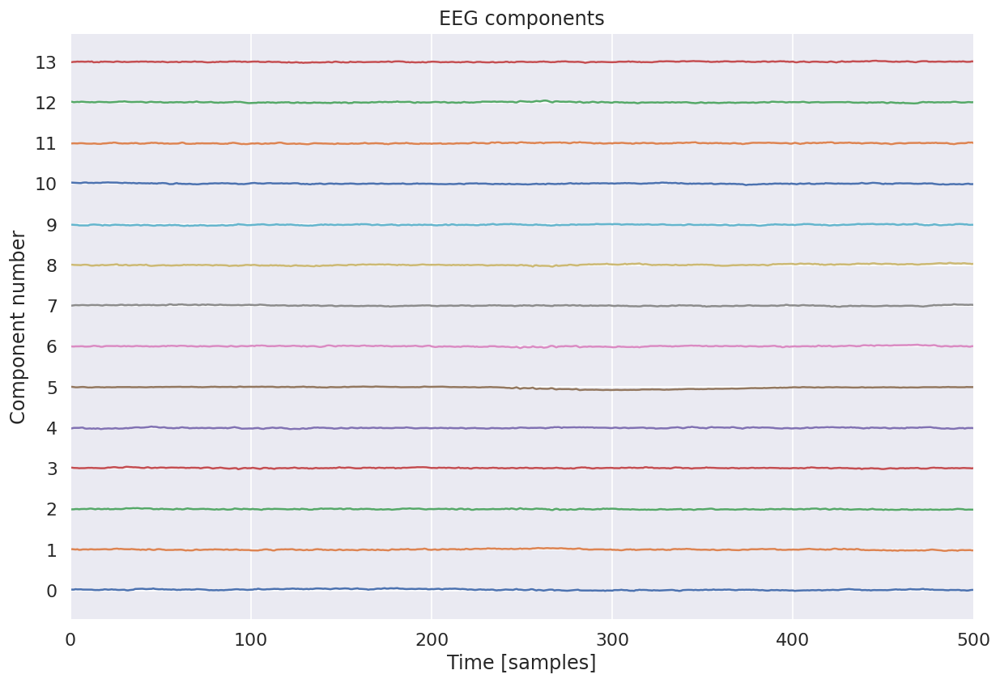

In [ ]:
# wyznaczenie liczby przewidywanych komponentów
COMPONENTS_NUM = 14
# inicjalizacja obiektu realizującego algorytm ICA
ica_manager = ICAManager(method='fastica', n_components=COMPONENTS_NUM)

SIGNAL = eeg_signal_values.T

components = ica_get_components(COMPONENTS_NUM, SIGNAL, 'fastica')

In [ ]:
components.shape

(6006, 14)

In [ ]:
from scipy.stats import kurtosis, skew

kurtosis_values_compontents = dict()
skew_values_compontents = dict()

for component in range(components.shape[1]):
  kurtosis_values_compontents[component] = kurtosis(components[component])
  skew_values_compontents[component] = skew(components[component])

print(kurtosis_values_compontents)
print(skew_values_compontents)

{0: -0.8109238114755715, 1: -1.1672659948981818, 2: -0.6032729023201959, 3: -0.36853874828721533, 4: -0.7978336456682804, 5: 0.9361863669563326, 6: 0.9788438641692552, 7: 1.071191385850124, 8: -0.09993619244309171, 9: -0.5066466052455221, 10: -0.7888804805398095, 11: -1.3847509159374014, 12: -1.055968244144287, 13: -1.3264917828563147}
{0: 0.2399935006490648, 1: 0.18577427531836235, 2: 0.6183144461999749, 3: 0.6926651752949502, 4: 0.08323532617659114, 5: -0.14333835373578305, 6: -0.4624740863181454, 7: -0.6583468620882534, 8: -0.17294530391126778, 9: -0.061445963227836825, 10: -0.5461480855100662, 11: -0.06554850679658976, 12: -0.5446553827425041, 13: -0.1225913665179145}


Wprowadź komponenty do usunięcia (np.: 1, 2)0, 1, 2
Components length 6006


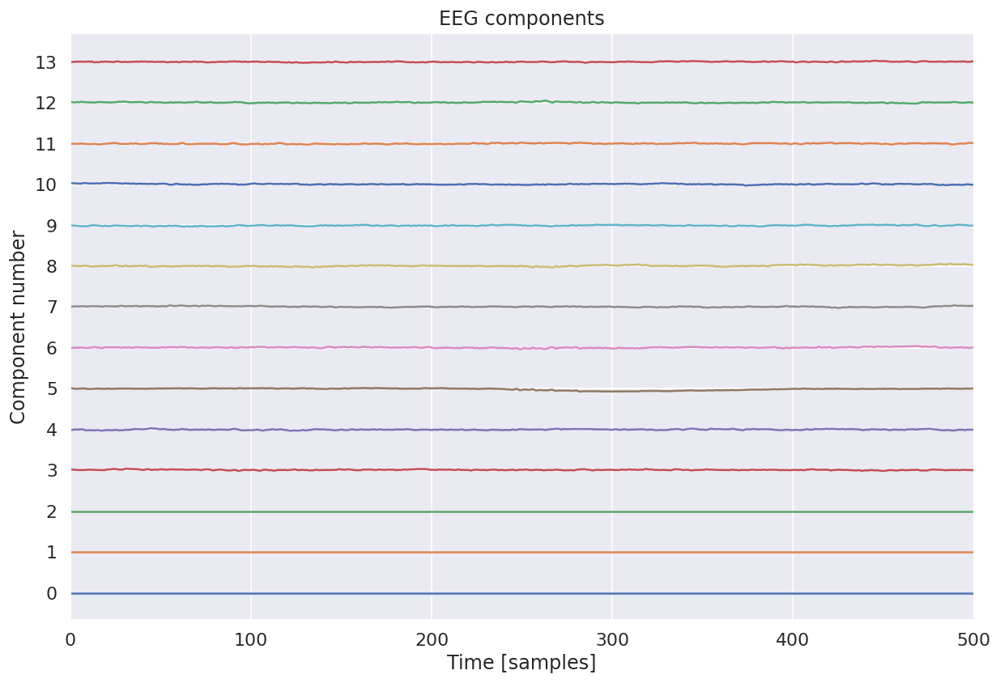

In [ ]:
reconstructed_signal = exclude_components(components)

In [ ]:
reconstructed_signal.shape

(6006, 59)

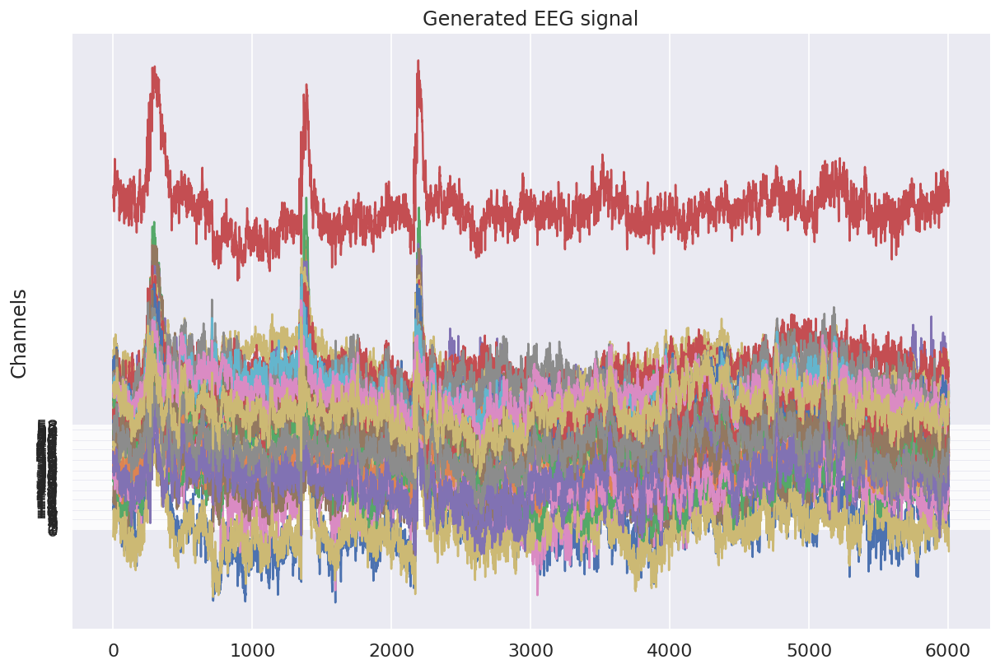

In [ ]:
visualize_multichannel(reconstructed_signal, "Reconstructed EEG real using FastICA")

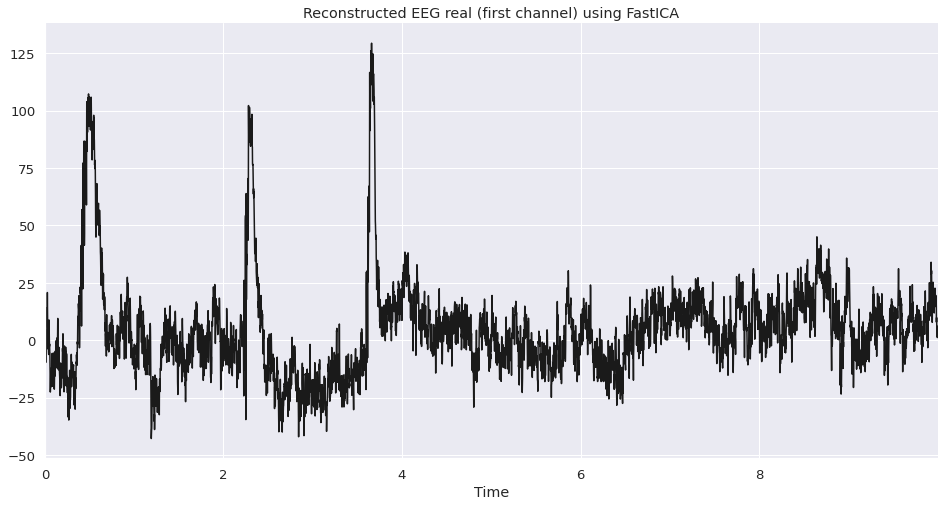

In [ ]:
visualize_signal(reconstructed_signal[:,0], sf=fs_audvis, title="Reconstructed EEG real (first channel) using FastICA")

In [ ]:
summary_metrics_df = metrics_summary('FastICA', 'EEG - real normalized', 'blink', 'white', eeg_1_2_3, reconstructed_signal, with_noise=True)
df_results = df_results.append(summary_metrics_df)
df_results

,method,signal type,artifacts,noise,SNR - original signal,SNR - signal modified (with added noise or reconstructed),SNR - first channel[dB],SNR - second channel[dB],SNR - third channel[dB],RMSE,PSNR,correlation - first channel,correlation - second channel,correlation - third channel
0,-,EEG - generated normalized,blink,white,10.912736,16.757390,10.090796,11.755141,11.043419,0.143320,16.841306,0.542782,0.672986,0.619247
0,FastICA,EEG - generated normalized,blink,white,10.912736,16.791004,10.449129,12.723704,11.977876,0.131839,17.536741,-0.043480,0.661946,0.616729
0,FastICA,EEG - real normalized,blink,white,7.030407,11.671746,6.033221,18.900293,25.389586,11.879911,22.231293,0.053985,0.868653,0.959142


In [ ]:
df_results.iloc[2]

method                                                                     FastICA
signal type                                                  EEG - real normalized
artifacts                                                                    blink
noise                                                                        white
SNR - original signal                                                     7.030407
SNR - signal modified (with added noise or reconstructed)                11.671746
SNR - first channel[dB]                                                   6.033221
SNR - second channel[dB]                                                 18.900293
SNR - third channel[dB]                                                  25.389586
RMSE                                                                     11.879911
PSNR                                                                     22.231293
correlation - first channel                                               0.053985
corr